# Insurance Claim Fraud Detection

## Prelude
Insurance is a business involving huge amount of money and trust. But recently there are instances where customers tend to cheat the company by validating false claims. This results in loss for the company and more stringent procedures to claim.

#### About the variables:

Fraud reported is the categorical dependent variable.

Independent variables:

months_as_customer - a numeric variable

age  - a numeric variable

policy_number - a numeric variable 

policy_bind_date - a date variable

policy_state  - a categorical variable

policy_csl - a numeric variable 

policy_deductable  - a numeric variable 

policy_annual_premium   - a numeric variable

umbrella_limit - a numeric variable

insured_zip - a numeric variable  

insured_sex - a categorical variable 

insured_education_level - a categorical variable

insured_occupation - a categorical variable 

insured_hobbies  - a categorical variable

insured_relationship  - a categorical variable

capital-gains - a categorical variable 

capital-loss  - a categorical variable

incident_date - a categorical variable 

incident_type - a categorical variable

collision_type - a categorical variable

incident_severity - a categorical variable

authorities_contacted  - a categorical variable 

incident_state   - a categorical variable

incident_city - a categorical variable

incident_location - a categorical variable

incident_hour_of_the_day - a numeric variable

number_of_vehicles_involved - a numeric variable

property_damage    - a categorical variable

bodily_injuries - a numeric variable

witnesses - a numeric variable 

police_report_available - a categorical variable

total_claim_amount - a numeric variable

injury_claim  - a numeric variable

property_claim  - a numeric variable

vehicle_claim  - a numeric variable

auto_make   - a categorical variable

auto_model   - a categorical variable

auto_year - a numeric variable  

## Problem Statement

I am building a model to dtect fraud in the insurance claim by the customer using classification technique.

In [1]:
# Importing necessary packages

# Importing fundamental packages
import warnings
warnings.filterwarnings("ignore")
from IPython.core.interactiveshell import InteractiveShell        ## To display multiple outputs
InteractiveShell.ast_node_interactivity = "all"
import pyforest            

## For visualization
import matplotlib.pyplot as plt                                         
%matplotlib inline

import seaborn as sns

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

## Data Pre-Processing Packages
from scipy.stats import chi2_contingency
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from scipy.stats import zscore
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
from sklearn.datasets import make_blobs
from sklearn.cluster import DBSCAN
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold
from sklearn.feature_selection import RFE
from sklearn.preprocessing import scale

## To create copy of data
import copy

## Pipeline Packages

from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline


## Ensemble Learning Algorithms Packages

from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import loguniform
from sklearn.linear_model import Ridge

## Evaluation Metrics Packages
import statsmodels.api as sm
from scipy.stats import f
from statsmodels.formula.api import ols
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import resample
from sklearn import metrics
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import preprocessing
from sklearn.metrics import average_precision_score, confusion_matrix, accuracy_score, classification_report, plot_confusion_matrix
from sklearn.metrics import roc_curve, auc

# Bagging and Boosting
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import AdaBoostClassifier                           

# Saving the model
import pickle

In [2]:
def read(link):
    global data

    data=pd.read_csv(link)
    
    data=pd.DataFrame(data)
    print(data)

In [3]:
read(link="Automobile_insurance_fraud.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

     months_as_customer  age  policy_number policy_bind_date policy_state  \
0                   328   48         521585       17-10-2014           OH   
1                   228   42         342868       27-06-2006           IN   
2                   134   29         687698       06-09-2000           OH   
3                   256   41         227811       25-05-1990           IL   
4                   228   44         367455       06-06-2014           IL   
..                  ...  ...            ...              ...          ...   
995                   3   38         941851       16-07-1991           OH   
996                 285   41         186934       05-01-2014           IL   
997                 130   34         918516       17-02-2003           OH   
998                 458   62         533940       18-11-2011           IL   
999                 456   60         556080       11-11-1996           OH   

    policy_csl  policy_deductable  policy_annual_premium  umbrella_limit  \

## Exploratory Data Analysis (EDA)

In [4]:
# Understanding the fundamentals of the given data set

def eda1(mydata):                                    # Defining function
    
    print("The first 10 rows:", "\n",mydata.head(10))                              # to display first 10 records
    print("\n")                               
    print("The last 10 rows:", "\n",mydata.tail(10))                              # to display last 10 records
    print("\n")
    print("\n")
    
    print("The constitution of the given data:","\n", data.info())                 # to understand attributes of the data
    
    print("\n")
    print("\n")
    print("Skewness for the data","\n",mydata.skew())       # to get skewness of the data, skewness=0 for normal distribution
    print("\n")
    print("Kurosis for the data","\n",mydata.kurtosis() )            # to get kutosis, kurtosis <=3 for normal distribution
    print("\n")
    print("\n")
    

In [5]:
eda1(mydata=data)

The first 10 rows: 
    months_as_customer  age  policy_number policy_bind_date policy_state  \
0                 328   48         521585       17-10-2014           OH   
1                 228   42         342868       27-06-2006           IN   
2                 134   29         687698       06-09-2000           OH   
3                 256   41         227811       25-05-1990           IL   
4                 228   44         367455       06-06-2014           IL   
5                 256   39         104594       12-10-2006           OH   
6                 137   34         413978       04-06-2000           IN   
7                 165   37         429027       03-02-1990           IL   
8                  27   33         485665       05-02-1997           IL   
9                 212   42         636550       25-07-2011           IL   

  policy_csl  policy_deductable  policy_annual_premium  umbrella_limit  \
0    250/500               1000                1406.91               0   
1    

In [6]:
# Dropping _c39 column as there are no entries for it
data=data.drop(["_c39"],axis=1)

In [7]:
data.nunique()

months_as_customer              391
age                              46
policy_number                  1000
policy_bind_date                951
policy_state                      3
policy_csl                        3
policy_deductable                 3
policy_annual_premium           991
umbrella_limit                   11
insured_zip                     995
insured_sex                       2
insured_education_level           7
insured_occupation               14
insured_hobbies                  20
insured_relationship              6
capital-gains                   338
capital-loss                    354
incident_date                    60
incident_type                     4
collision_type                    4
incident_severity                 4
authorities_contacted             5
incident_state                    7
incident_city                     7
incident_location              1000
incident_hour_of_the_day         24
number_of_vehicles_involved       4
property_damage             

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 39 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   months_as_customer           1000 non-null   int64  
 1   age                          1000 non-null   int64  
 2   policy_number                1000 non-null   int64  
 3   policy_bind_date             1000 non-null   object 
 4   policy_state                 1000 non-null   object 
 5   policy_csl                   1000 non-null   object 
 6   policy_deductable            1000 non-null   int64  
 7   policy_annual_premium        1000 non-null   float64
 8   umbrella_limit               1000 non-null   int64  
 9   insured_zip                  1000 non-null   int64  
 10  insured_sex                  1000 non-null   object 
 11  insured_education_level      1000 non-null   object 
 12  insured_occupation           1000 non-null   object 
 13  insured_hobbies    

In [9]:
#Lets check the value count of each column to see if there are any unexpected and unwanted entries present in the column.
for i in data.columns:
        print(data[i].value_counts())
        print('\n','XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX','\n')

194    8
128    7
254    7
140    7
210    7
      ..
390    1
411    1
453    1
448    1
17     1
Name: months_as_customer, Length: 391, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

43    49
39    48
41    45
34    44
38    42
30    42
31    42
37    41
33    39
40    38
32    38
29    35
46    33
42    32
35    32
36    32
44    32
28    30
26    26
45    26
48    25
47    24
27    24
57    16
25    14
55    14
49    14
53    13
50    13
24    10
54    10
61    10
51     9
60     9
58     8
56     8
23     7
21     6
59     5
62     4
52     4
64     2
63     2
19     1
20     1
22     1
Name: age, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

521585    1
687755    1
674485    1
223404    1
991480    1
         ..
563878    1
620855    1
583169    1
337677    1
556080    1
Name: policy_number, Length: 1000, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

01-01-2006    3
28-04-1992    3
05-08-1992    3
14-12-1991    2
09-08-2004    2
             ..


- In this dataset I find "?" to be present in collision type, property_damage and police_report_available columns.

- For the column umbrella_limit 80% of the values is 0, depicting null.

In [10]:
# Dropping  umbrella_limit column

data= data.drop(["umbrella_limit"], axis=1)

In [11]:
#Replacing '?' with NaN
data = data.replace('?', np.NAN)

<IPython.core.display.Javascript object>

In [12]:
data.isnull().sum()

months_as_customer               0
age                              0
policy_number                    0
policy_bind_date                 0
policy_state                     0
policy_csl                       0
policy_deductable                0
policy_annual_premium            0
insured_zip                      0
insured_sex                      0
insured_education_level          0
insured_occupation               0
insured_hobbies                  0
insured_relationship             0
capital-gains                    0
capital-loss                     0
incident_date                    0
incident_type                    0
collision_type                 178
incident_severity                0
authorities_contacted            0
incident_state                   0
incident_city                    0
incident_location                0
incident_hour_of_the_day         0
number_of_vehicles_involved      0
property_damage                360
bodily_injuries                  0
witnesses           

Splitting object variable policy_csl into two numeric variables

In [13]:
#Extracting columns from policy_csl since it is an object variable but needs to be a numeric variable
data['csl_per_person'] = data.policy_csl.str.split('/', expand=True)[0]
data['csl_per_accident'] = data.policy_csl.str.split('/', expand=True)[1]

#Changing dtype of extracted column
data[['csl_per_person']] = data[['csl_per_person']].astype('int64')
data[['csl_per_accident']] = data[['csl_per_accident']].astype('int64')

In [14]:
data=data.drop(["policy_csl"],axis=1)

In [15]:
#Extracting auto_age from auto year
data['auto_age'] = 2018 - data['auto_year']

#Droping auto_year column after extraction
data = data.drop(["auto_year"],axis=1)


Extracting month and year

In [16]:
#Converting object data type to datetime 
data['policy_bind_date'] =  pd.to_datetime(data['policy_bind_date'])
data['incident_date'] =  pd.to_datetime(data['incident_date'])

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [17]:
#Extracting policy_bind year,month and day from policy_bind_date

#Extracting year
data["policy_bind_year"]=pd.to_datetime(data.policy_bind_date, format="%d/%m/%Y").dt.year

#Extracting month
data["policy_bind_month"]=pd.to_datetime(data.policy_bind_date, format="%d/%m/%Y").dt.month

#Droping policy_bind_date column after extraction
data = data.drop(["policy_bind_date"],axis=1)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [18]:
#Extracting incident year,month and day from incident_date

#Extracting year
data["incident_year"]=pd.to_datetime(data.incident_date, format="%d/%m/%Y").dt.year

#Extracting month
data["incident_month"]=pd.to_datetime(data.incident_date, format="%d/%m/%Y").dt.month

#Droping incident_date column after extraction
data = data.drop(["incident_date"],axis=1)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [19]:
#Lets check the value count of each column to see if there are any unexpected and unwanted entries present in the column.
for i in data.columns:
        print(data[i].value_counts())
        print('\n','XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX','\n')

194    8
128    7
254    7
140    7
210    7
      ..
390    1
411    1
453    1
448    1
17     1
Name: months_as_customer, Length: 391, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

43    49
39    48
41    45
34    44
38    42
30    42
31    42
37    41
33    39
40    38
32    38
29    35
46    33
42    32
35    32
36    32
44    32
28    30
26    26
45    26
48    25
47    24
27    24
57    16
25    14
55    14
49    14
53    13
50    13
24    10
54    10
61    10
51     9
60     9
58     8
56     8
23     7
21     6
59     5
62     4
52     4
64     2
63     2
19     1
20     1
22     1
Name: age, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

521585    1
687755    1
674485    1
223404    1
991480    1
         ..
563878    1
620855    1
583169    1
337677    1
556080    1
Name: policy_number, Length: 1000, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

OH    352
IL    338
IN    310
Name: policy_state, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

 Missing value imputation

In [21]:
data_cat = pd.DataFrame()
data_num = pd.DataFrame()
for i in data.columns:
    if data[i].dtype == "O":
        data_cat[i] = data[i]
    else:
        data_num[i] = data[i]
        


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [22]:
# Encoding Attrition
enc = LabelEncoder()
for i in data_cat:
    data_cat[i] = enc.fit_transform(data_cat[i])

In [23]:
impute_1= SimpleImputer(strategy= "mean")
impute_2= SimpleImputer(strategy= "most_frequent")
impute_3= IterativeImputer(max_iter=10, random_state= 0)
impute_4= KNNImputer(n_neighbors=9)
model= LinearRegression()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [24]:
pipe1 = Pipeline([
    ('impute',impute_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('impute',impute_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('impute',impute_3),
    ('model',model),  
    
])

pipe4 = Pipeline([
    ('impute',impute_4),
    ('model',model),  
    
])

In [25]:
def pre_process(data, target, pipe):
    
    data_reset_index = data.reset_index(drop=True)
    
# Create Global Variable
    global X
    global y
    global X_train
    global X_test
    global y_train
    global y_test
    global y_pred

# Segregate Feature & Target Variables
    X = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]

# Split train & Test

    X_train,  X_test, y_train, y_test = train_test_split(X,y, test_size= 0.3, random_state=1)

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(X_train,y_train)
    
    y_pred = pipe.predict(X_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [26]:
miss_data= copy.deepcopy(data_cat)

In [27]:
pre_process(data= miss_data,
           target='fraud_reported',
           pipe= pipe1)

<IPython.core.display.Javascript object>

0.40710006410948907

In [28]:
pre_process(data= miss_data,
           target='fraud_reported',
           pipe= pipe2)

<IPython.core.display.Javascript object>

0.40710006410948907

In [29]:
pre_process(data= miss_data,
           target='fraud_reported',
           pipe= pipe3)

<IPython.core.display.Javascript object>

0.40710006410948907

In [30]:
pre_process(data= miss_data,
           target='fraud_reported',
           pipe= pipe4)

<IPython.core.display.Javascript object>

0.40710006410948907

In [31]:
data_features= miss_data.drop(["fraud_reported"],axis=1)
data_label=miss_data["fraud_reported"]

In [32]:
#Lets check the value count of each column to see if there are any unexpected and unwanted entries present in the column.
for i in data_features.columns:
        print(data_features[i].value_counts())
        print('\n','XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX','\n')

2    352
0    338
1    310
Name: policy_state, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

0    537
1    463
Name: insured_sex, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

3    161
2    160
0    145
4    144
5    143
6    125
1    122
Name: insured_education_level, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

6     93
9     85
12    78
11    76
3     76
2     74
13    72
7     71
8     71
1     69
0     65
10    63
5     54
4     53
Name: insured_occupation, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

15    64
8     57
13    57
3     56
12    55
9     55
4     55
11    54
19    53
10    52
18    50
16    49
0     49
2     48
14    47
5     46
7     43
17    41
6     35
1     34
Name: insured_hobbies, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

3    183
2    177
1    174
0    170
5    155
4    141
Name: insured_relationship, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

0    419
2    403
3     94
1     84
N

Since all the methods score the same, let's choose K-Nearest  Neighbor to take into account multiple variable for better suitability

In [33]:
ft_train = pd.DataFrame(impute_4.fit_transform(data_features))
ft_train.columns = data_features.columns

<IPython.core.display.Javascript object>

In [34]:
#Lets check the value count of each column to see if there are any unexpected and unwanted entries present in the column.
for i in data_features.columns:
        print(data_features[i].value_counts())
        print('\n','XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX','\n')

2    352
0    338
1    310
Name: policy_state, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

0    537
1    463
Name: insured_sex, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

3    161
2    160
0    145
4    144
5    143
6    125
1    122
Name: insured_education_level, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

6     93
9     85
12    78
11    76
3     76
2     74
13    72
7     71
8     71
1     69
0     65
10    63
5     54
4     53
Name: insured_occupation, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

15    64
8     57
13    57
3     56
12    55
9     55
4     55
11    54
19    53
10    52
18    50
16    49
0     49
2     48
14    47
5     46
7     43
17    41
6     35
1     34
Name: insured_hobbies, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

3    183
2    177
1    174
0    170
5    155
4    141
Name: insured_relationship, dtype: int64

 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

0    419
2    403
3     94
1     84
N

In [35]:
data_2=pd.concat([ft_train,data_num,data_label],axis=1)
data_2.info()

<IPython.core.display.Javascript object>

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 41 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   policy_state                 1000 non-null   float64
 1   insured_sex                  1000 non-null   float64
 2   insured_education_level      1000 non-null   float64
 3   insured_occupation           1000 non-null   float64
 4   insured_hobbies              1000 non-null   float64
 5   insured_relationship         1000 non-null   float64
 6   incident_type                1000 non-null   float64
 7   collision_type               1000 non-null   float64
 8   incident_severity            1000 non-null   float64
 9   authorities_contacted        1000 non-null   float64
 10  incident_state               1000 non-null   float64
 11  incident_city                1000 non-null   float64
 12  incident_location            1000 non-null   float64
 13  property_damage    

In [36]:
for i in data_2:
    print("Title: ",i, "with fraud_reported" )
    data_2.groupby([i,"fraud_reported"]).sum()
    data_2.groupby([i,"fraud_reported"]).describe().transpose()
    print("XXXXXXX###############XXXXXXXXXX")

Title:  policy_state with fraud_reported


insured_sex  insured_education_level  \
policy_state fraud_reported                                         
0.0          0                     121.0                    787.0   
             1                      38.0                    252.0   
1.0          0                     106.0                    679.0   
             1                      41.0                    223.0   
2.0          0                     115.0                    760.0   
             1                      42.0                    265.0   

                             insured_occupation  insured_hobbies  \
policy_state fraud_reported                                        
0.0          0                           1818.0           2628.0   
             1                            512.0            757.0   
1.0          0                           1487.0           2228.0   
             1                            517.0            779.0   
2.0          0                           1702.0           2586.0   
             1                            617.0            753.0   

                             insured_relationship  incident_type  \
policy_state fraud_reported                                        
0.0          0                              649.0          298.0   
             1                              191.0           80.0   
1.0          0                              528.0          279.0   
             1                              200.0           92.0   
2.0          0                              627.0          329.0   
             1                              221.0           94.0   

                             collision_type  incident_severity  \
policy_state fraud_reported                                      
0.0          0                        368.0              374.0   
             1                         85.0               38.0   
1.0          0                        330.0              328.0   
             1                         90.0               36.0   
2.0          0                        401.0              354.0   
             1                        104.0               54.0   

                             authorities_contacted  incident_state  ...  \
policy_state fraud_reported                                         ...   
0.0          0                               595.0           857.0  ...   
             1                               164.0           222.0  ...   
1.0          0                               493.0           770.0  ...   
             1                               147.0           253.0  ...   
2.0          0                               574.0           862.0  ...   
             1                               194.0           278.0  ...   

                             injury_claim  property_claim  vehicle_claim  \
policy_state fraud_reported                                                
0.0          0                    1936830         1869980        9523790   
             1                     651800          630740        3248190   
1.0          0                    1656340         1599540        8309230   
             1                     683310          661330        3522410   
2.0          0                    1812790         1815700        9343120   
             1                     692350          822280        3982210   

                             csl_per_person  csl_per_accident  auto_age  \
policy_state fraud_reported                                               
0.0          0                        73250            155500      3411   
             1                        20300             43400      1048   
1.0          0                        62250            133000      2915   
             1                        20000             43000       894   
2.0          0                        72650            153700      3406   
             1                        24200             51600      1223   

                             policy_bind_year 

policy_state                 0.0                    1.0             \
fraud_reported                 0          1           0          1   
insured_sex    count  261.000000  77.000000  231.000000  79.000000   
               mean     0.463602   0.493506    0.458874   0.518987   
               std      0.499631   0.503236    0.499388   0.502832   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      5.000000   4.000000    4.000000   4.000000   
               max     12.000000  12.000000   12.000000  12.000000   

policy_state                 2.0             
fraud_reported                 0          1  
insured_sex    count  261.000000  91.000000  
               mean     0.440613   0.461538  
               std      0.497414   0.501280  
               min      0.000000   0.000000  
               25%      0.000000   0.000000  
...                          ...        ...  
incident_month min      1.000000   1.000000  
               25%      1.000000   1.000000  
               50%      2.000000   2.000000  
               75%      5.000000   6.500000  
               max     12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  insured_sex with fraud_reported


policy_state  insured_education_level  \
insured_sex fraud_reported                                          
0.0         0                      417.0                   1227.0   
            1                      136.0                    357.0   
1.0         0                      336.0                    999.0   
            1                      125.0                    383.0   

                            insured_occupation  insured_hobbies  \
insured_sex fraud_reported                                        
0.0         0                           2705.0           4159.0   
            1                            880.0           1124.0   
1.0         0                           2302.0           3283.0   
            1                            766.0           1165.0   

                            insured_relationship  incident_type  \
insured_sex fraud_reported                                        
0.0         0                              975.0          489.0   
            1                              320.0          135.0   
1.0         0                              829.0          417.0   
            1                              292.0          131.0   

                            collision_type  incident_severity  \
insured_sex fraud_reported                                      
0.0         0                        588.0              577.0   
            1                        150.0               72.0   
1.0         0                        511.0              479.0   
            1                        129.0               56.0   

                            authorities_contacted  incident_state  ...  \
insured_sex fraud_reported                                         ...   
0.0         0                               893.0          1364.0  ...   
            1                               257.0           401.0  ...   
1.0         0                               769.0          1125.0  ...   
            1                               248.0           352.0  ...   

                            injury_claim  property_claim  vehicle_claim  \
insured_sex fraud_reported                                                
0.0         0                    2977280         2927620       15125830   
            1                    1012220         1081700        5520710   
1.0         0                    2428680         2357600       12050310   
            1                    1015240         1032650        5232100   

                            csl_per_person  csl_per_accident  auto_age  \
insured_sex fraud_reported                                               
0.0         0                       115600            245800      5189   
            1                        32550             69900      1652   
1.0         0                        92550            196400      4543   
            1                        31950             68100      1513   

                            policy_bind_year  policy_bind_month  \
insured_sex fraud_reported                                        
0.0         0                         822733               2734   
            1                         252249                795   
1.0         0                         684475               2250   
            1                         242147                780   

                            incident_year  incident_month  
insured_sex fraud_reported                                 
0.0         0                      828165            1394  
            1                      253890             396  
1.0         0                      689130            1151  
            1                      243815             466  

[4 rows x 39 columns]

insured_sex                  0.0                     1.0            
fraud_reported                 0           1           0           1
policy_state   count  411.000000  126.000000  342.000000  121.000000
               mean     1.014599    1.079365    0.982456    1.033058
               std      0.835073    0.835255    0.831729    0.815822
               min      0.000000    0.000000    0.000000    0.000000
               25%      0.000000    0.000000    0.000000    0.000000
...                          ...         ...         ...         ...
incident_month min      1.000000    1.000000    1.000000    1.000000
               25%      1.000000    1.000000    1.000000    1.000000
               50%      2.000000    2.000000    2.000000    2.000000
               75%      5.000000    4.000000    4.000000    7.000000
               max     12.000000   12.000000   12.000000   12.000000

[312 rows x 4 columns]

XXXXXXX###############XXXXXXXXXX
Title:  insured_education_level with fraud_reported


policy_state  insured_sex  \
insured_education_level fraud_reported                              
0.0                     0                      123.0         50.0   
                        1                       43.0         10.0   
1.0                     0                       85.0         43.0   
                        1                       35.0         15.0   
2.0                     0                      119.0         56.0   
                        1                       35.0         22.0   
3.0                     0                      116.0         56.0   
                        1                       45.0         19.0   
4.0                     0                      109.0         48.0   
                        1                       41.0         24.0   
5.0                     0                      114.0         50.0   
                        1                       23.0         15.0   
6.0                     0                       87.0         39.0   
                        1                       39.0         16.0   

                                        insured_occupation  insured_hobbies  \
insured_education_level fraud_reported                                        
0.0                     0                            733.0           1103.0   
                        1                            247.0            260.0   
1.0                     0                            652.0            801.0   
                        1                            184.0            324.0   
2.0                     0                            811.0           1218.0   
                        1                            216.0            333.0   
3.0                     0                            839.0           1243.0   
                        1                            268.0            420.0   
4.0                     0                            689.0           1038.0   
                        1                            248.0            392.0   
5.0                     0                            728.0           1125.0   
                        1                            253.0            302.0   
6.0                     0                            555.0            914.0   
                        1                            230.0            258.0   

                                        insured_relationship  incident_type  \
insured_education_level fraud_reported                                        
0.0                     0                              250.0          148.0   
                        1                               84.0           41.0   
1.0                     0                              241.0           97.0   
                        1                               81.0           34.0   
2.0                     0                              303.0          149.0   
                        1                               94.0           34.0   
3.0                     0                              262.0          123.0   
                        1                              118.0           46.0   
4.0                     0                              287.0          115.0   
                        1                               85.0           44.0   
5.0                     0                              248.0          150.0   
                        1                               73.0           31.0   
6.0                     0                              213.0          124.0   
                        1                               77.0           36.0   

                                        collision_type  incident_severity  \
insured_education_level fraud_reported                                      
0.0                     0                        189.0              154.0   
                        1                         44.0               13.0   
1.0                     0                        126.0              125.0   
                    

insured_education_level         0.0                   1.0             \
fraud_reported                    0          1          0          1   
policy_state   count     111.000000  34.000000  90.000000  32.000000   
               mean        1.108108   1.264706   0.944444   1.093750   
               std         0.856540   0.751113   0.852770   0.856074   
               min         0.000000   0.000000   0.000000   0.000000   
               25%         0.000000   1.000000   0.000000   0.000000   
...                             ...        ...        ...        ...   
incident_month min         1.000000   1.000000   1.000000   1.000000   
               25%         1.000000   1.000000   1.000000   1.750000   
               50%         2.000000   2.000000   2.000000   2.000000   
               75%         2.000000   2.000000   2.750000   7.250000   
               max        12.000000  12.000000  12.000000  12.000000   

insured_education_level         2.0                    3.0             \
fraud_reported                    0          1           0          1   
policy_state   count     124.000000  36.000000  119.000000  42.000000   
               mean        0.959677   0.972222    0.974790   1.071429   
               std         0.810492   0.844685    0.786132   0.808276   
               min         0.000000   0.000000    0.000000   0.000000   
               25%         0.000000   0.000000    0.000000   0.000000   
...                             ...        ...         ...        ...   
incident_month min         1.000000   1.000000    1.000000   1.000000   
               25%         1.000000   1.000000    1.000000   1.250000   
               50%         2.000000   2.000000    2.000000   2.000000   
               75%         4.000000   3.000000    4.500000   7.000000   
               max        12.000000  12.000000   12.000000  12.000000   

insured_education_level         4.0                    5.0             \
fraud_reported                    0          1           0          1   
policy_state   count     106.000000  38.000000  111.000000  32.000000   
               mean        1.028302   1.078947    1.027027   0.718750   
               std         0.844676   0.784360    0.825276   0.812578   
               min         0.000000   0.000000    0.000000   0.000000   
               25%         0.000000   0.250000    0.000000   0.000000   
...                             ...        ...         ...        ...   
incident_month min         1.000000   1.000000    1.000000   1.000000   
               25%         1.000000   1.000000    1.000000   1.000000   
               50%         2.000000   1.000000    2.000000   1.000000   
               75%         6.000000   2.000000    6.000000   2.000000   
               max        12.000000  12.000000   12.000000  12.000000   

insured_education_level        6.0             
fraud_reported                   0          1  
policy_state   count     92.000000  33.000000  
               mean       0.945652   1.181818  
               std        0.881609   0.882275  
               min        0.000000   0.000000  
               25%        0.000000   0.000000  
...                            ...        ...  
incident_month min        1.000000   1.000000  
               25%        1.000000   1.000000  
               50%        2.000000   4.000000  
               75%        5.250000   8.000000  
               max       12.000000  12.000000  

[312 rows x 14 columns]

XXXXXXX###############XXXXXXXXXX
Title:  insured_occupation with fraud_reported


policy_state  insured_sex  \
insured_occupation fraud_reported                              
0.0                0                       60.0         21.0   
                   1                        7.0          6.0   
1.0                0                       58.0         26.0   
                   1                       15.0          8.0   
2.0                0                       57.0         22.0   
                   1                       24.0         10.0   
3.0                0                       47.0         23.0   
                   1                       29.0         16.0   
4.0                0                       34.0         11.0   
                   1                       23.0         11.0   
5.0                0                       38.0         20.0   
                   1                       15.0          5.0   
6.0                0                       68.0         36.0   
                   1                       22.0         13.0   
7.0                0                       66.0         28.0   
                   1                       13.0          6.0   
8.0                0                       65.0         30.0   
                   1                       15.0          3.0   
9.0                0                       57.0         30.0   
                   1                       19.0          8.0   
10.0               0                       47.0         22.0   
                   1                       13.0          7.0   
11.0               0                       47.0         24.0   
                   1                       24.0         10.0   
12.0               0                       55.0         24.0   
                   1                       20.0          9.0   
13.0               0                       54.0         25.0   
                   1                       22.0          9.0   

                                   insured_education_level  insured_hobbies  \
insured_occupation fraud_reported                                             
0.0                0                                 136.0            607.0   
                   1                                  23.0            141.0   
1.0                0                                 159.0            483.0   
                   1                                  53.0            128.0   
2.0                0                                 172.0            565.0   
                   1                                  67.0            219.0   
3.0                0                                 163.0            448.0   
                   1                                  77.0            261.0   
4.0                0                                 130.0            375.0   
                   1                                  47.0            159.0   
5.0                0                                 124.0            348.0   
                   1                                  32.0            106.0   
6.0                0                                 213.0            672.0   
                   1                                  75.0            159.0   
7.0                0                                 197.0            550.0   
                   1                                  33.0            127.0   
8.0                0                                 164.0            608.0   
                   1                                  37.0             99.0   
9.0                0                                 176.0            658.0   
                   1                                  55.0            186.0   
10.0               0                                 152.0            490.0   
                   1                                  36.0             90.0   
11.0               0                                 132.0            575.0   
                   1                                  69.0            213.0   
12.0               0                                 144.0  

insured_occupation         0.0                   1.0                   2.0   \
fraud_reported                0          1          0          1          0   
policy_state   count  54.000000  11.000000  52.000000  17.000000  52.000000   
               mean    1.111111   0.636364   1.115385   0.882353   1.096154   
               std     0.793052   0.674200   0.832050   0.927520   0.798519   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.250000   0.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.250000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   2.000000   2.000000   2.000000   
               75%     6.000000   2.000000   4.000000   2.000000   4.500000   
               max    12.000000   4.000000  12.000000  10.000000  12.000000   

insured_occupation                    3.0                   4.0              \
fraud_reported                1          0          1          0          1   
policy_state   count  22.000000  48.000000  28.000000  37.000000  16.000000   
               mean    1.090909   0.979167   1.035714   0.918919   1.437500   
               std     0.811177   0.837666   0.792658   0.862116   0.727438   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.250000   0.000000   0.000000   0.000000   1.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   2.000000   
               50%     1.500000   2.000000   2.500000   2.000000   3.000000   
               75%     2.000000   2.250000   8.000000   4.000000   7.250000   
               max    11.000000  12.000000  12.000000  12.000000  12.000000   

insured_occupation    ...       9.0                   10.0             \
fraud_reported        ...          0          1          0          1   
policy_state   count  ...  67.000000  18.000000  49.000000  14.000000   
               mean   ...   0.850746   1.055556   0.959184   0.928571   
               std    ...   0.821192   0.872604   0.789493   0.828742   
               min    ...   0.000000   0.000000   0.000000   0.000000   
               25%    ...   0.000000   0.000000   0.000000   0.000000   
...                   ...        ...        ...        ...        ...   
incident_month min    ...   1.000000   1.000000   1.000000   1.000000   
               25%    ...   1.000000   1.000000   1.000000   1.000000   
               50%    ...   2.000000   1.500000   2.000000   2.000000   
               75%    ...   4.000000   7.750000   6.000000   3.750000   
               max    ...  12.000000  11.000000  12.000000   9.000000   

insured_occupation         11.0                  12.0                  13.0  \
fraud_reported                0          1          0          1          0   
policy_state   count  55.000000  21.000000  56.000000  22.000000  51.000000   
               mean    0.854545   1.142857   0.982143   0.909091   1.058824   
               std     0.869614   0.853564   0.884021   0.867898   0.810229   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   2.000000   2.000000   2.000000   
               75%     6.500000   3.000000   3.250000   7.500000   4.000000   
               max    12.000000  12.000000  10

XXXXXXX###############XXXXXXXXXX
Title:  insured_hobbies with fraud_reported


policy_state  insured_sex  \
insured_hobbies fraud_reported                              
0.0             0                       39.0         20.0   
                1                       20.0          6.0   
1.0             0                       34.0         18.0   
                1                        8.0          2.0   
2.0             0                       35.0         16.0   
                1                       16.0          8.0   
3.0             0                       43.0         22.0   
                1                       10.0          4.0   
4.0             0                       50.0         27.0   
                1                        3.0          2.0   
5.0             0                       10.0          3.0   
                1                       43.0         17.0   
6.0             0                        5.0          4.0   
                1                       30.0         12.0   
7.0             0                       36.0         14.0   
                1                        9.0          1.0   
8.0             0                       36.0         19.0   
                1                        8.0          4.0   
9.0             0                       46.0         21.0   
                1                        7.0          4.0   
10.0            0                       37.0         19.0   
                1                        8.0          6.0   
11.0            0                       44.0         17.0   
                1                        6.0          4.0   
12.0            0                       60.0         21.0   
                1                        8.0          5.0   
13.0            0                       50.0         14.0   
                1                        5.0          6.0   
14.0            0                       38.0         19.0   
                1                       14.0          6.0   
15.0            0                       49.0         19.0   
                1                       17.0         13.0   
16.0            0                       43.0         13.0   
                1                       12.0          5.0   
17.0            0                       35.0         17.0   
                1                       11.0          3.0   
18.0            0                       38.0         19.0   
                1                       13.0          4.0   
19.0            0                       25.0         20.0   
                1                       13.0          9.0   

                                insured_education_level  insured_occupation  \
insured_hobbies fraud_reported                                                
0.0             0                                 104.0               265.0   
                1                                  40.0                91.0   
1.0             0                                  87.0               178.0   
                1                                  20.0                33.0   
2.0             0                                  88.0               283.0   
                1                                  38.0                84.0   
3.0             0                                 148.0               286.0   
                1                                  25.0                62.0   
4.0             0                                 143.0               295.0   
                1                                  22.0                33.0   
5.0             0                                  19.0                63.0   
                1                                 120.0               263.0   
6.0             0                                  24.0                59.0   
                1                                  58.0               201.0   
7.0             0                                 122.0               235.0   
                1                                  23.0                29.0   
8.0             0                              

insured_hobbies            0.0                   1.0                   2.0   \
fraud_reported                0          1          0          1          0   
policy_state   count  36.000000  13.000000  28.000000   6.000000  34.000000   
               mean    1.083333   1.538462   1.214286   1.333333   1.029412   
               std     0.906327   0.660225   0.786796   1.032796   0.834313   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   1.000000   1.000000   0.500000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     2.000000   1.000000   1.750000   1.250000   1.000000   
               50%     2.000000   2.000000   2.000000   4.000000   2.000000   
               75%     7.000000   2.000000   9.250000   9.000000   4.750000   
               max    12.000000  10.000000  12.000000  12.000000  12.000000   

insured_hobbies                       3.0                   4.0              \
fraud_reported                1          0          1          0          1   
policy_state   count  14.000000  47.000000   9.000000  50.000000   5.000000   
               mean    1.142857   0.914894   1.111111   1.000000   0.600000   
               std     0.770329   0.829609   0.927961   0.808122   0.894427   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     1.000000   0.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.250000   1.000000   1.000000   1.000000   2.000000   
               50%     2.000000   2.000000   2.000000   2.000000   2.000000   
               75%     7.500000   2.500000   6.000000   3.000000   9.000000   
               max    10.000000  12.000000  12.000000  12.000000  12.000000   

insured_hobbies       ...       15.0                  16.0             \
fraud_reported        ...          0          1          0          1   
policy_state   count  ...  47.000000  17.000000  38.000000  11.000000   
               mean   ...   1.042553   1.000000   1.131579   1.090909   
               std    ...   0.832948   0.866025   0.811107   0.943880   
               min    ...   0.000000   0.000000   0.000000   0.000000   
               25%    ...   0.000000   0.000000   0.250000   0.000000   
...                   ...        ...        ...        ...        ...   
incident_month min    ...   1.000000   1.000000   1.000000   1.000000   
               25%    ...   1.000000   1.000000   1.000000   1.000000   
               50%    ...   2.000000   2.000000   2.000000   2.000000   
               75%    ...   5.500000   8.000000   6.000000   5.000000   
               max    ...  12.000000  12.000000  12.000000  12.000000   

insured_hobbies            17.0                  18.0                  19.0  \
fraud_reported                0          1          0          1          0   
policy_state   count  33.000000   8.000000  40.000000  10.000000  37.000000   
               mean    1.060606   1.375000   0.950000   1.300000   0.675676   
               std     0.826869   0.916125   0.904405   0.674949   0.818333   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.750000   0.000000   1.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   1.500000   2.000000   1.000000   2.000000   
               75%     7.000000   5.000000   6.000000   7.500000   6.000000   
               max    12.000000  10.000000  12

XXXXXXX###############XXXXXXXXXX
Title:  insured_relationship with fraud_reported


policy_state  insured_sex  \
insured_relationship fraud_reported                              
0.0                  0                      130.0         63.0   
                     1                       44.0         17.0   
1.0                  0                      132.0         58.0   
                     1                       45.0         21.0   
2.0                  0                      133.0         55.0   
                     1                       52.0         29.0   
3.0                  0                      151.0         59.0   
                     1                       36.0         21.0   
4.0                  0                      104.0         51.0   
                     1                       35.0         15.0   
5.0                  0                      103.0         56.0   
                     1                       49.0         18.0   

                                     insured_education_level  \
insured_relationship fraud_reported                            
0.0                  0                                 373.0   
                     1                                 110.0   
1.0                  0                                 427.0   
                     1                                 155.0   
2.0                  0                                 363.0   
                     1                                 127.0   
3.0                  0                                 429.0   
                     1                                 125.0   
4.0                  0                                 311.0   
                     1                                 109.0   
5.0                  0                                 323.0   
                     1                                 114.0   

                                     insured_occupation  insured_hobbies  \
insured_relationship fraud_reported                                        
0.0                  0                            924.0           1363.0   
                     1                            215.0            360.0   
1.0                  0                            859.0           1377.0   
                     1                            295.0            436.0   
2.0                  0                            884.0           1292.0   
                     1                            354.0            478.0   
3.0                  0                            901.0           1462.0   
                     1                            276.0            393.0   
4.0                  0                            658.0            935.0   
                     1                            223.0            245.0   
5.0                  0                            781.0           1013.0   
                     1                            283.0            377.0   

                                     incident_type  collision_type  \
insured_relationship fraud_reported                                  
0.0                  0                       153.0           209.0   
                     1                        30.0            29.0   
1.0                  0                       164.0           187.0   
                     1                        51.0            55.0   
2.0                  0                       152.0           184.0   
                     1                        57.0            56.0   
3.0                  0                       160.0           195.0   
                     1                        38.0            46.0   
4.0                  0                       129.0           152.0   
                     1                        40.0            42.0   
5.0                  0                       148.0           172.0   
                     1                        50.0            51.0   

                                     incident_severity  authorities_contacted  \
insured_relationship fraud_reported                                             
0.0    

insured_relationship         0.0                    1.0             \
fraud_reported                 0          1           0          1   
policy_state   count  135.000000  35.000000  129.000000  45.000000   
               mean     0.962963   1.257143    1.023256   1.000000   
               std      0.832255   0.816840    0.804918   0.852803   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   1.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   1.000000   
               75%      2.000000   2.000000    5.000000   4.000000   
               max     12.000000  12.000000   12.000000  12.000000   

insured_relationship         2.0                    3.0             \
fraud_reported                 0          1           0          1   
policy_state   count  125.000000  52.000000  144.000000  39.000000   
               mean     1.064000   1.000000    1.048611   0.923077   
               std      0.849516   0.816497    0.813607   0.807355   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      5.000000   4.250000    5.000000   6.500000   
               max     12.000000  12.000000   12.000000  12.000000   

insured_relationship         4.0                    5.0             
fraud_reported                 0          1           0          1  
policy_state   count  107.000000  34.000000  113.000000  42.000000  
               mean     0.971963   1.029412    0.911504   1.166667  
               std      0.851834   0.834313    0.861451   0.823931  
               min      0.000000   0.000000    0.000000   0.000000  
               25%      0.000000   0.000000    0.000000   0.250000  
...                          ...        ...         ...        ...  
incident_month min      1.000000   1.000000    1.000000   1.000000  
               25%      1.000000   1.000000    1.000000   1.000000  
               50%      2.000000   2.000000    2.000000   2.000000  
               75%      6.000000   7.000000    4.000000   6.750000  
               max     12.000000  12.000000   12.000000  11.000000  

[312 rows x 12 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_type with fraud_reported


policy_state  insured_sex  \
incident_type fraud_reported                              
0.0           0                      290.0        139.0   
              1                      119.0         57.0   
1.0           0                       78.0         34.0   
              1                        9.0          2.0   
2.0           0                      296.0        124.0   
              1                      128.0         57.0   
3.0           0                       89.0         45.0   
              1                        5.0          5.0   

                              insured_education_level  insured_occupation  \
incident_type fraud_reported                                                
0.0           0                                 889.0              1980.0   
              1                                 348.0               779.0   
1.0           0                                 194.0               556.0   
              1                                  26.0                22.0   
2.0           0                                 905.0              1893.0   
              1                                 337.0               819.0   
3.0           0                                 238.0               578.0   
              1                                  29.0                26.0   

                              insured_hobbies  insured_relationship  \
incident_type fraud_reported                                          
0.0           0                        3060.0                 704.0   
              1                        1076.0                 264.0   
1.0           0                         711.0                 192.0   
              1                          52.0                  28.0   
2.0           0                        2713.0                 712.0   
              1                        1094.0                 299.0   
3.0           0                         958.0                 196.0   
              1                          67.0                  21.0   

                              collision_type  incident_severity  \
incident_type fraud_reported                                      
0.0           0                        333.0              371.0   
              1                        123.0               49.0   
1.0           0                        228.0              154.0   
              1                         24.0               14.0   
2.0           0                        280.0              355.0   
              1                        108.0               51.0   
3.0           0                        258.0              176.0   
              1                         24.0               14.0   

                              authorities_contacted  incident_state  ...  \
incident_type fraud_reported                                         ...   
0.0           0                               623.0           969.0  ...   
              1                               220.0           352.0  ...   
1.0           0                               212.0           268.0  ...   
              1                                24.0            25.0  ...   
2.0           0                               561.0           942.0  ...   
              1                               233.0           349.0  ...   
3.0           0                               266.0           310.0  ...   
              1                                28.0            27.0  ...   

                              injury_claim  property_claim  vehicle_claim  \
incident_type fraud_reported                                                
0.0           0                    2706640         2644040       13467180   
              1                     973680          999610        5034760   
1.0           0                      57390           57690         290060   
              1                       4850            6210          29690   
2.0           0                    2575020         2519900     

incident_type                0.0                   1.0                   2.0  \
fraud_reported                 0          1          0         1           0   
policy_state   count  305.000000  114.00000  76.000000  8.000000  286.000000   
               mean     0.950820    1.04386   1.026316  1.125000    1.034965   
               std      0.843439    0.83497   0.782708  0.991031    0.828548   
               min      0.000000    0.00000   0.000000  0.000000    0.000000   
               25%      0.000000    0.00000   0.000000  0.000000    0.000000   
...                          ...        ...        ...       ...         ...   
incident_month min      1.000000    1.00000   1.000000  1.000000    1.000000   
               25%      1.000000    1.00000   1.000000  1.750000    1.000000   
               50%      2.000000    2.00000   2.000000  2.000000    2.000000   
               75%      5.000000    6.75000   3.000000  2.000000    5.750000   
               max     12.000000   12.00000  12.000000  5.000000   12.000000   

incident_type                           3.0            
fraud_reported                 1          0         1  
policy_state   count  117.000000  86.000000  8.000000  
               mean     1.094017   1.034884  0.625000  
               std      0.819829   0.860201  0.517549  
               min      0.000000   0.000000  0.000000  
               25%      0.000000   0.000000  0.000000  
...                          ...        ...       ...  
incident_month min      1.000000   1.000000  1.000000  
               25%      1.000000   1.000000  1.000000  
               50%      2.000000   2.000000  1.000000  
               75%      5.000000   3.000000  2.250000  
               max     12.000000  12.000000  7.000000  

[312 rows x 8 columns]

XXXXXXX###############XXXXXXXXXX
Title:  collision_type with fraud_reported


policy_state  insured_sex  \
collision_type fraud_reported                              
0.0            0                      166.0         84.0   
               1                       68.0         37.0   
1.0            0                      209.0         84.0   
               1                      102.0         46.0   
2.0            0                      211.0         95.0   
               1                       77.0         31.0   
3.0            0                      167.0         79.0   
               1                       14.0          7.0   

                               insured_education_level  insured_occupation  \
collision_type fraud_reported                                                
0.0            0                                 560.0              1186.0   
               1                                 225.0               495.0   
1.0            0                                 615.0              1324.0   
               1                                 256.0               617.0   
2.0            0                                 619.0              1363.0   
               1                                 204.0               486.0   
3.0            0                                 432.0              1134.0   
               1                                  55.0                48.0   

                               insured_hobbies  insured_relationship  \
collision_type fraud_reported                                          
0.0            0                        1752.0                 456.0   
               1                         647.0                 163.0   
1.0            0                        2001.0                 476.0   
               1                         861.0                 219.0   
2.0            0                        2020.0                 484.0   
               1                         662.0                 181.0   
3.0            0                        1669.0                 388.0   
               1                         119.0                  49.0   

                               incident_type  incident_severity  \
collision_type fraud_reported                                     
0.0            0                       194.0              234.0   
               1                        84.0               25.0   
1.0            0                       196.0              244.0   
               1                        84.0               48.0   
2.0            0                       182.0              248.0   
               1                        66.0               27.0   
3.0            0                       334.0              330.0   
               1                        32.0               28.0   

                               authorities_contacted  incident_state  ...  \
collision_type fraud_reported                                         ...   
0.0            0                               329.0           569.0  ...   
               1                               139.0           223.0  ...   
1.0            0                               407.0           653.0  ...   
               1                               177.0           254.0  ...   
2.0            0                               448.0           689.0  ...   
               1                               137.0           224.0  ...   
3.0            0                               478.0           578.0  ...   
               1                                52.0            52.0  ...   

                               injury_claim  property_claim  vehicle_claim  \
collision_type fraud_reported                                                
0.0            0                    1715640         1686000        8517360   
               1                     602370          614490        3287340   
1.0            0                    1770240         1703560        8784710   
               1                     817600          811590        4130160   
2.0            0  

collision_type               0.0                    1.0             \
fraud_reported                 0          1           0          1   
policy_state   count  184.000000  70.000000  201.000000  91.000000   
               mean     0.902174   0.971429    1.039801   1.120879   
               std      0.810583   0.815989    0.835708   0.841099   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      5.250000   6.000000    6.000000   7.500000   
               max     12.000000  12.000000   12.000000  12.000000   

collision_type               2.0                    3.0             
fraud_reported                 0          1           0          1  
policy_state   count  206.000000  70.000000  162.000000  16.000000  
               mean     1.024272   1.100000    1.030864   0.875000  
               std      0.857901   0.819155    0.822229   0.806226  
               min      0.000000   0.000000    0.000000   0.000000  
               25%      0.000000   0.000000    0.000000   0.000000  
...                          ...        ...         ...        ...  
incident_month min      1.000000   1.000000    1.000000   1.000000  
               25%      1.000000   1.000000    1.000000   1.000000  
               50%      2.000000   1.000000    2.000000   1.500000  
               75%      4.750000   3.500000    3.000000   2.000000  
               max     12.000000  12.000000   12.000000   7.000000  

[312 rows x 8 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_severity with fraud_reported


policy_state  insured_sex  \
incident_severity fraud_reported                              
0.0               0                      112.0         51.0   
                  1                      171.0         83.0   
1.0               0                      322.0        143.0   
                  1                       42.0         21.0   
2.0               0                      243.0        108.0   
                  1                       42.0         16.0   
3.0               0                       76.0         40.0   
                  1                        6.0          1.0   

                                  insured_education_level  insured_occupation  \
incident_severity fraud_reported                                                
0.0               0                                 320.0               751.0   
                  1                                 497.0              1105.0   
1.0               0                                 927.0              2072.0   
                  1                                 121.0               212.0   
2.0               0                                 750.0              1626.0   
                  1                                 101.0               302.0   
3.0               0                                 229.0               558.0   
                  1                                  21.0                27.0   

                                  insured_hobbies  insured_relationship  \
incident_severity fraud_reported                                          
0.0               0                        1035.0                 263.0   
                  1                        1688.0                 411.0   
1.0               0                        3198.0                 744.0   
                  1                         285.0                  90.0   
2.0               0                        2398.0                 582.0   
                  1                         270.0                  91.0   
3.0               0                         811.0                 215.0   
                  1                          46.0                  20.0   

                                  incident_type  collision_type  \
incident_severity fraud_reported                                  
0.0               0                        98.0           121.0   
                  1                       166.0           167.0   
1.0               0                       398.0           478.0   
                  1                        54.0            56.0   
2.0               0                       236.0           248.0   
                  1                        34.0            38.0   
3.0               0                       174.0           252.0   
                  1                        12.0            18.0   

                                  authorities_contacted  incident_state  ...  \
incident_severity fraud_reported                                         ...   
0.0               0                               184.0           365.0  ...   
                  1                               328.0           509.0  ...   
1.0               0                               702.0           982.0  ...   
                  1                                83.0           104.0  ...   
2.0               0                               518.0           846.0  ...   
                  1                                74.0           126.0  ...   
3.0               0                               258.0           296.0  ...   
                  1                                20.0            14.0  ...   

                                  injury_claim  property_claim  vehicle_claim  \
incident_severity fraud_reported                                                
0.0               0                     985290          995280        4994640   
                  1                    1469360         1550250        7687720   
1.0               0                    223186

incident_severity            0.0                     1.0             \
fraud_reported                 0           1           0          1   
policy_state   count  109.000000  167.000000  316.000000  38.000000   
               mean     1.027523    1.023952    1.018987   1.105263   
               std      0.854820    0.821049    0.831686   0.798291   
               min      0.000000    0.000000    0.000000   0.000000   
               25%      0.000000    0.000000    0.000000   0.250000   
...                          ...         ...         ...        ...   
incident_month min      1.000000    1.000000    1.000000   1.000000   
               25%      1.000000    1.000000    1.000000   1.000000   
               50%      2.000000    2.000000    2.000000   2.000000   
               75%      3.000000    7.000000    5.000000   4.000000   
               max     12.000000   12.000000   12.000000  12.000000   

incident_severity            2.0                   3.0            
fraud_reported                 0          1          0         1  
policy_state   count  244.000000  36.000000  84.000000  6.000000  
               mean     0.995902   1.166667   0.904762  1.000000  
               std      0.824012   0.878310   0.844815  0.894427  
               min      0.000000   0.000000   0.000000  0.000000  
               25%      0.000000   0.000000   0.000000  0.250000  
...                          ...        ...        ...       ...  
incident_month min      1.000000   1.000000   1.000000  1.000000  
               25%      1.000000   1.000000   1.000000  1.000000  
               50%      2.000000   2.000000   2.000000  1.000000  
               75%      6.000000   4.250000   2.250000  1.750000  
               max     12.000000  10.000000  12.000000  5.000000  

[312 rows x 8 columns]

XXXXXXX###############XXXXXXXXXX
Title:  authorities_contacted with fraud_reported


policy_state  insured_sex  \
authorities_contacted fraud_reported                              
0.0                   0                      140.0         58.0   
                      1                       58.0         32.0   
1.0                   0                      168.0         69.0   
                      1                       65.0         23.0   
2.0                   0                       90.0         46.0   
                      1                        6.0          2.0   
3.0                   0                      127.0         68.0   
                      1                       70.0         35.0   
4.0                   0                      228.0        101.0   
                      1                       62.0         29.0   

                                      insured_education_level  \
authorities_contacted fraud_reported                            
0.0                   0                                 412.0   
                      1                                 156.0   
1.0                   0                                 503.0   
                      1                                 190.0   
2.0                   0                                 238.0   
                      1                                  21.0   
3.0                   0                                 408.0   
                      1                                 192.0   
4.0                   0                                 665.0   
                      1                                 181.0   

                                      insured_occupation  insured_hobbies  \
authorities_contacted fraud_reported                                        
0.0                   0                            900.0           1455.0   
                      1                            393.0            517.0   
1.0                   0                           1117.0           1601.0   
                      1                            456.0            608.0   
2.0                   0                            538.0            863.0   
                      1                             12.0             37.0   
3.0                   0                            840.0           1198.0   
                      1                            412.0            568.0   
4.0                   0                           1612.0           2325.0   
                      1                            373.0            559.0   

                                      insured_relationship  incident_type  \
authorities_contacted fraud_reported                                        
0.0                   0                              315.0          138.0   
                      1                              117.0           54.0   
1.0                   0                              421.0          158.0   
                      1                              179.0           66.0   
2.0                   0                              205.0          163.0   
                      1                               21.0           10.0   
3.0                   0                              310.0          140.0   
                      1                              149.0           56.0   
4.0                   0                              553.0          307.0   
                      1                              146.0           80.0   

                                      collision_type  incident_severity  \
authorities_contacted fraud_reported                                      
0.0                   0                        131.0              161.0   
                      1                         61.0               29.0   
1.0                   0                        158.0              187.0   
                      1                         56.0               19.0   
2.0                   0                        255.0              163.0   
                      1                         18.0               10.0   
3.

authorities_contacted         0.0                    1.0             \
fraud_reported                  0          1           0          1   
policy_state   count   139.000000  57.000000  163.000000  60.000000   
               mean      1.007194   1.017544    1.030675   1.083333   
               std       0.820890   0.767445    0.827187   0.849560   
               min       0.000000   0.000000    0.000000   0.000000   
               25%       0.000000   0.000000    0.000000   0.000000   
...                           ...        ...         ...        ...   
incident_month min       1.000000   1.000000    1.000000   1.000000   
               25%       1.000000   1.000000    1.000000   1.000000   
               50%       2.000000   2.000000    2.000000   2.000000   
               75%       4.500000   4.000000    6.000000   6.000000   
               max      12.000000  12.000000   12.000000  12.000000   

authorities_contacted        2.0                   3.0                    4.0  \
fraud_reported                 0         1           0          1           0   
policy_state   count   85.000000  6.000000  135.000000  63.000000  231.000000   
               mean     1.058824  1.000000    0.940741   1.111111    0.987013   
               std      0.821626  0.894427    0.861818   0.844548    0.836559   
               min      0.000000  0.000000    0.000000   0.000000    0.000000   
               25%      0.000000  0.250000    0.000000   0.000000    0.000000   
...                          ...       ...         ...        ...         ...   
incident_month min      1.000000  1.000000    1.000000   1.000000    1.000000   
               25%      1.000000  1.250000    1.000000   1.000000    1.000000   
               50%      2.000000  2.000000    2.000000   2.000000    2.000000   
               75%      3.000000  2.000000    5.000000   4.000000    4.000000   
               max     12.000000  7.000000   12.000000  12.000000   12.000000   

authorities_contacted             
fraud_reported                 1  
policy_state   count   61.000000  
               mean     1.016393  
               std      0.846400  
               min      0.000000  
               25%      0.000000  
...                          ...  
incident_month min      1.000000  
               25%      1.000000  
               50%      2.000000  
               75%      7.000000  
               max     12.000000  

[312 rows x 10 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_state with fraud_reported


policy_state  insured_sex  \
incident_state fraud_reported                              
0.0            0                       81.0         34.0   
               1                       33.0         18.0   
1.0            0                      197.0         93.0   
               1                       58.0         31.0   
2.0            0                       10.0         11.0   
               1                       14.0          6.0   
3.0            0                       24.0         10.0   
               1                        7.0          5.0   
4.0            0                      174.0         76.0   
               1                       83.0         29.0   
5.0            0                       93.0         32.0   
               1                       26.0         14.0   
6.0            0                      174.0         86.0   
               1                       40.0         18.0   

                               insured_education_level  insured_occupation  \
incident_state fraud_reported                                                
0.0            0                                 209.0               521.0   
               1                                 128.0               211.0   
1.0            0                                 600.0              1373.0   
               1                                 172.0               390.0   
2.0            0                                  47.0                81.0   
               1                                  30.0                72.0   
3.0            0                                  60.0               165.0   
               1                                  25.0                59.0   
4.0            0                                 512.0              1158.0   
               1                                 226.0               507.0   
5.0            0                                 221.0               563.0   
               1                                  63.0               162.0   
6.0            0                                 577.0              1146.0   
               1                                  96.0               245.0   

                               insured_hobbies  insured_relationship  \
incident_state fraud_reported                                          
0.0            0                         777.0                 193.0   
               1                         302.0                  90.0   
1.0            0                        1890.0                 499.0   
               1                         408.0                 137.0   
2.0            0                         106.0                  25.0   
               1                         104.0                  36.0   
3.0            0                         215.0                  66.0   
               1                          60.0                  21.0   
4.0            0                        1708.0                 438.0   
               1                         771.0                 189.0   
5.0            0                         922.0                 196.0   
               1                         281.0                  56.0   
6.0            0                        1824.0                 387.0   
               1                         363.0                  83.0   

                               incident_type  collision_type  \
incident_state fraud_reported                                  
0.0            0                        98.0           121.0   
               1                        40.0            45.0   
1.0            0                       220.0           254.0   
               1                        65.0            53.0   
2.0            0                        16.0            19.0   
               1                         8.0            11.0   
3.0            0                        22.0            34.0   
               1                         6.0            14.0   
4.0            0            

incident_state              0.0                    1.0                   2.0  \
fraud_reported                0          1           0          1          0   
policy_state   count  76.000000  34.000000  204.000000  58.000000  13.000000   
               mean    1.065789   0.970588    0.965686   1.000000   0.769231   
               std     0.838022   0.869876    0.838600   0.816497   0.832050   
               min     0.000000   0.000000    0.000000   0.000000   0.000000   
               25%     0.000000   0.000000    0.000000   0.000000   0.000000   
...                         ...        ...         ...        ...        ...   
incident_month min     1.000000   1.000000    1.000000   1.000000   1.000000   
               25%     1.000000   1.000000    1.000000   1.000000   2.000000   
               50%     2.000000   1.500000    2.000000   2.000000   6.000000   
               75%     3.000000   2.750000    6.000000   5.750000  11.000000   
               max    12.000000  11.000000   12.000000  12.000000  12.000000   

incident_state                         3.0                   4.0             \
fraud_reported                1          0         1           0          1   
policy_state   count  10.000000  22.000000  8.000000  175.000000  73.000000   
               mean    1.400000   1.090909  0.875000    0.994286   1.136986   
               std     0.843274   0.811177  0.991031    0.854314   0.821839   
               min     0.000000   0.000000  0.000000    0.000000   0.000000   
               25%     1.000000   0.250000  0.000000    0.000000   0.000000   
...                         ...        ...       ...         ...        ...   
incident_month min     1.000000   1.000000  1.000000    1.000000   1.000000   
               25%     2.000000   1.000000  2.000000    1.000000   1.000000   
               50%     4.000000   2.000000  2.000000    2.000000   2.000000   
               75%     8.750000   3.500000  4.750000    4.500000   7.000000   
               max    12.000000  12.000000  8.000000   12.000000  12.000000   

incident_state              5.0                    6.0             
fraud_reported                0          1           0          1  
policy_state   count  85.000000  25.000000  178.000000  39.000000  
               mean    1.094118   1.040000    0.977528   1.025641  
               std     0.749977   0.789515    0.850092   0.810691  
               min     0.000000   0.000000    0.000000   0.000000  
               25%     1.000000   0.000000    0.000000   0.000000  
...                         ...        ...         ...        ...  
incident_month min     1.000000   1.000000    1.000000   1.000000  
               25%     1.000000   1.000000    1.000000   1.000000  
               50%     2.000000   1.000000    2.000000   2.000000  
               75%     2.000000   5.000000    4.000000   3.500000  
               max    12.000000  12.000000   12.000000  12.000000  

[312 rows x 14 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_city with fraud_reported


policy_state  insured_sex  \
incident_city fraud_reported                              
0.0           0                      117.0         46.0   
              1                       46.0         19.0   
1.0           0                      100.0         53.0   
              1                       37.0         18.0   
2.0           0                      105.0         55.0   
              1                       38.0         15.0   
3.0           0                       99.0         50.0   
              1                       39.0         20.0   
4.0           0                      112.0         37.0   
              1                       30.0          9.0   
5.0           0                      113.0         45.0   
              1                       34.0         18.0   
6.0           0                      107.0         56.0   
              1                       37.0         22.0   

                              insured_education_level  insured_occupation  \
incident_city fraud_reported                                                
0.0           0                                 287.0               676.0   
              1                                 141.0               297.0   
1.0           0                                 356.0               755.0   
              1                                 107.0               261.0   
2.0           0                                 339.0               692.0   
              1                                 103.0               251.0   
3.0           0                                 343.0               745.0   
              1                                  88.0               221.0   
4.0           0                                 274.0               659.0   
              1                                  91.0               196.0   
5.0           0                                 306.0               677.0   
              1                                  93.0               207.0   
6.0           0                                 321.0               803.0   
              1                                 117.0               213.0   

                              insured_hobbies  insured_relationship  \
incident_city fraud_reported                                          
0.0           0                        1038.0                 241.0   
              1                         397.0                 104.0   
1.0           0                        1064.0                 266.0   
              1                         361.0                  93.0   
2.0           0                         997.0                 274.0   
              1                         344.0                  93.0   
3.0           0                        1185.0                 293.0   
              1                         344.0                  78.0   
4.0           0                         991.0                 213.0   
              1                         191.0                  79.0   
5.0           0                         952.0                 234.0   
              1                         307.0                  74.0   
6.0           0                        1215.0                 283.0   
              1                         345.0                  91.0   

                              incident_type  collision_type  \
incident_city fraud_reported                                  
0.0           0                       124.0           163.0   
              1                        46.0            37.0   
1.0           0                       131.0           156.0   
              1                        35.0            41.0   
2.0           0                       138.0           156.0   
              1                        39.0            49.0   
3.0           0                       117.0           169.0   
              1                        31.0            39.0   
4.0           0                       136.0           142.0   
              1       

incident_city                0.0                    1.0             \
fraud_reported                 0          1           0          1   
policy_state   count  108.000000  44.000000  110.000000  39.000000   
               mean     1.083333   1.045455    0.909091   0.948718   
               std      0.844166   0.805636    0.818877   0.793019   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   1.000000   
               75%      2.250000   2.500000    5.000000   4.000000   
               max     12.000000  12.000000   12.000000  12.000000   

incident_city                2.0                    3.0                   4.0  \
fraud_reported                 0          1           0          1          0   
policy_state   count  106.000000  35.000000  111.000000  34.000000  95.000000   
               mean     0.990566   1.085714    0.891892   1.147059   1.178947   
               std      0.810588   0.886879    0.824085   0.892132   0.837663   
               min      0.000000   0.000000    0.000000   0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   0.000000   
...                          ...        ...         ...        ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   2.000000   
               75%      5.750000   7.000000    3.500000   6.000000   4.000000   
               max     12.000000  12.000000   12.000000  12.000000  12.000000   

incident_city                           5.0                    6.0             
fraud_reported                1           0          1           0          1  
policy_state   count  27.000000  104.000000  30.000000  119.000000  38.000000  
               mean    1.111111    1.086538   1.133333    0.899160   0.973684  
               std     0.847319    0.837363   0.860366    0.837621   0.752899  
               min     0.000000    0.000000   0.000000    0.000000   0.000000  
               25%     0.000000    0.000000   0.000000    0.000000   0.000000  
...                         ...         ...        ...         ...        ...  
incident_month min     1.000000    1.000000   1.000000    1.000000   1.000000  
               25%     1.000000    1.000000   1.000000    1.000000   1.000000  
               50%     2.000000    2.000000   2.000000    2.000000   2.000000  
               75%     7.500000    5.250000   3.750000    6.000000   5.750000  
               max    12.000000   12.000000  12.000000   12.000000  12.000000  

[312 rows x 14 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_location with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
incident_location,fraud_reported,,,,,,,,,,,,,,,,,,,,,
0.0,1,1.0,1.0,5.0,9.0,12.0,1.0,0.0,2.0,0.0,0.0,...,5540,11080,44320,500,1000,5,1997,5,2015,1
1.0,0,2.0,0.0,0.0,12.0,11.0,2.0,1.0,3.0,1.0,4.0,...,330,330,2310,100,300,10,2007,3,2015,2
2.0,1,1.0,1.0,0.0,0.0,13.0,2.0,0.0,2.0,0.0,1.0,...,6430,6430,51440,100,300,16,1991,7,2015,2
3.0,0,1.0,1.0,4.0,0.0,12.0,4.0,0.0,2.0,2.0,1.0,...,5550,5550,33300,250,500,19,2009,11,2015,1
4.0,0,2.0,0.0,0.0,2.0,12.0,5.0,2.0,1.0,1.0,3.0,...,12800,12800,44800,100,300,18,2008,7,2015,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995.0,1,1.0,0.0,3.0,2.0,19.0,5.0,2.0,2.0,1.0,4.0,...,4450,8900,35600,250,500,7,2014,5,2015,1
996.0,1,2.0,1.0,4.0,2.0,17.0,0.0,2.0,2.0,0.0,4.0,...,6510,13020,52080,250,500,14,2014,10,2015,1
997.0,1,1.0,0.0,5.0,1.0,5.0,3.0,0.0,2.0,0.0,0.0,...,6240,6240,43680,500,1000,3,2013,4,2015,1


incident_location    0.0   1.0   2.0   3.0   4.0   5.0   6.0   7.0   8.0    \
fraud_reported           1     0     1     0     0     0     0     0     0   
policy_state   count   1.0   1.0   1.0   1.0   1.0   1.0   1.0   1.0   1.0   
               mean    1.0   2.0   1.0   1.0   2.0   2.0   2.0   2.0   1.0   
               std     NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
               min     1.0   2.0   1.0   1.0   2.0   2.0   2.0   2.0   1.0   
               25%     1.0   2.0   1.0   1.0   2.0   2.0   2.0   2.0   1.0   
...                    ...   ...   ...   ...   ...   ...   ...   ...   ...   
incident_month min     1.0   2.0   2.0   1.0   2.0  11.0   3.0   9.0   2.0   
               25%     1.0   2.0   2.0   1.0   2.0  11.0   3.0   9.0   2.0   
               50%     1.0   2.0   2.0   1.0   2.0  11.0   3.0   9.0   2.0   
               75%     1.0   2.0   2.0   1.0   2.0  11.0   3.0   9.0   2.0   
               max     1.0   2.0   2.0   1.0   2.0  11.0   3.0   9.0   2.0   

incident_location    9.0    ... 990.0 991.0 992.0 993.0 994.0 995.0 996.0  \
fraud_reported           0  ...     0     0     0     0     0     1     1   
policy_state   count   1.0  ...   1.0   1.0   1.0   1.0   1.0   1.0   1.0   
               mean    1.0  ...   1.0   2.0   2.0   1.0   1.0   1.0   2.0   
               std     NaN  ...   NaN   NaN   NaN   NaN   NaN   NaN   NaN   
               min     1.0  ...   1.0   2.0   2.0   1.0   1.0   1.0   2.0   
               25%     1.0  ...   1.0   2.0   2.0   1.0   1.0   1.0   2.0   
...                    ...  ...   ...   ...   ...   ...   ...   ...   ...   
incident_month min     4.0  ...   1.0  11.0   1.0   1.0   2.0   1.0   1.0   
               25%     4.0  ...   1.0  11.0   1.0   1.0   2.0   1.0   1.0   
               50%     4.0  ...   1.0  11.0   1.0   1.0   2.0   1.0   1.0   
               75%     4.0  ...   1.0  11.0   1.0   1.0   2.0   1.0   1.0   
               max     4.0  ...   1.0  11.0   1.0   1.0   2.0   1.0   1.0   

incident_location    997.0 998.0 999.0  
fraud_reported           1     1     0  
policy_state   count   1.0   1.0   1.0  
               mean    1.0   2.0   1.0  
               std     NaN   NaN   NaN  
               min     1.0   2.0   1.0  
               25%     1.0   2.0   1.0  
...                    ...   ...   ...  
incident_month min     1.0   7.0   2.0  
               25%     1.0   7.0   2.0  
               50%     1.0   7.0   2.0  
               75%     1.0   7.0   2.0  
               max     1.0   7.0   2.0  

[312 rows x 1000 columns]

XXXXXXX###############XXXXXXXXXX
Title:  property_damage with fraud_reported


policy_state  insured_sex  \
property_damage fraud_reported                              
0.0             0                      277.0        122.0   
                1                       78.0         34.0   
1.0             0                      213.0        108.0   
                1                       90.0         38.0   
2.0             0                      263.0        112.0   
                1                       93.0         49.0   

                                insured_education_level  insured_occupation  \
property_damage fraud_reported                                                
0.0             0                                 850.0              1845.0   
                1                                 200.0               499.0   
1.0             0                                 643.0              1472.0   
                1                                 209.0               507.0   
2.0             0                                 733.0              1690.0   
                1                                 331.0               640.0   

                                insured_hobbies  insured_relationship  \
property_damage fraud_reported                                          
0.0             0                        2651.0                 654.0   
                1                         605.0                 162.0   
1.0             0                        2275.0                 518.0   
                1                         758.0                 187.0   
2.0             0                        2516.0                 632.0   
                1                         926.0                 263.0   

                                incident_type  collision_type  \
property_damage fraud_reported                                  
0.0             0                       325.0           406.0   
                1                        66.0            70.0   
1.0             0                       274.0           325.0   
                1                        90.0            85.0   
2.0             0                       307.0           368.0   
                1                       110.0           124.0   

                                incident_severity  authorities_contacted  ...  \
property_damage fraud_reported                                            ...   
0.0             0                           380.0                  587.0  ...   
                1                            44.0                  136.0  ...   
1.0             0                           310.0                  484.0  ...   
                1                            32.0                  167.0  ...   
2.0             0                           366.0                  591.0  ...   
                1                            52.0                  202.0  ...   

                                injury_claim  property_claim  vehicle_claim  \
property_damage fraud_reported                                                
0.0             0                    1947430         1856970        9520160   
                1                     521210          579590        2914240   
1.0             0                    1699120         1683250        8459570   
                1                     655270          651520        3519540   
2.0             0                    1759410         1745000        9196410   
                1                     850980          883240        4319030   

                                csl_per_person  csl_per_accident  auto_age  \
property_damage fraud_reported                                               
0.0             0                        75000            159500      3516   
                1                        17700             37600       850   
1.0             0                        60900            129700      2953   
                1                        19450             42100      1046   
2.0             0                        72250        

property_damage              0.0                    1.0             \
fraud_reported                 0          1           0          1   
policy_state   count  272.000000  66.000000  224.000000  78.000000   
               mean     1.018382   1.181818    0.950893   1.153846   
               std      0.856725   0.857709    0.821406   0.757249   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   1.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      5.000000   4.000000    4.000000   6.000000   
               max     12.000000  11.000000   12.000000  12.000000   

property_damage              2.0              
fraud_reported                 0           1  
policy_state   count  257.000000  103.000000  
               mean     1.023346    0.902913  
               std      0.819346    0.834484  
               min      0.000000    0.000000  
               25%      0.000000    0.000000  
...                          ...         ...  
incident_month min      1.000000    1.000000  
               25%      1.000000    1.000000  
               50%      2.000000    2.000000  
               75%      4.000000    5.000000  
               max     12.000000   12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  police_report_available with fraud_reported


policy_state  insured_sex  \
police_report_available fraud_reported                              
0.0                     0                      247.0        122.0   
                        1                       96.0         42.0   
1.0                     0                      263.0        112.0   
                        1                       82.0         35.0   
2.0                     0                      243.0        108.0   
                        1                       83.0         44.0   

                                        insured_education_level  \
police_report_available fraud_reported                            
0.0                     0                                 722.0   
                        1                                 259.0   
1.0                     0                                 757.0   
                        1                                 221.0   
2.0                     0                                 747.0   
                        1                                 260.0   

                                        insured_occupation  insured_hobbies  \
police_report_available fraud_reported                                        
0.0                     0                           1721.0           2494.0   
                        1                            619.0            782.0   
1.0                     0                           1612.0           2366.0   
                        1                            430.0            616.0   
2.0                     0                           1674.0           2582.0   
                        1                            597.0            891.0   

                                        insured_relationship  incident_type  \
police_report_available fraud_reported                                        
0.0                     0                              605.0          313.0   
                        1                              218.0           93.0   
1.0                     0                              570.0          296.0   
                        1                              175.0           82.0   
2.0                     0                              629.0          297.0   
                        1                              219.0           91.0   

                                        collision_type  incident_severity  \
police_report_available fraud_reported                                      
0.0                     0                        384.0              381.0   
                        1                         96.0               41.0   
1.0                     0                        359.0              335.0   
                        1                         78.0               38.0   
2.0                     0                        356.0              340.0   
                        1                        105.0               49.0   

                                        authorities_contacted  ...  \
police_report_available fraud_reported                         ...   
0.0                     0                               562.0  ...   
                        1                               155.0  ...   
1.0                     0                               556.0  ...   
                        1                               156.0  ...   
2.0                     0                               544.0  ...   
                        1                               194.0  ...   

                                        injury_claim  property_claim  \
police_report_available fraud_reported                                 
0.0                     0                    1684290         1692690   
                        1                     681180          751900   
1.0                     0                    1785910         1726650   
                        1                     612060          624620   
2.0                     0                    1935760         1865880   
  

police_report_available         0.0                    1.0             \
fraud_reported                    0          1           0          1   
policy_state   count     257.000000  86.000000  242.000000  72.000000   
               mean        0.961089   1.116279    1.086777   1.138889   
               std         0.837619   0.859803    0.832877   0.810243   
               min         0.000000   0.000000    0.000000   0.000000   
               25%         0.000000   0.000000    0.000000   0.000000   
...                             ...        ...         ...        ...   
incident_month min         1.000000   1.000000    1.000000   1.000000   
               25%         1.000000   1.000000    1.000000   1.000000   
               50%         2.000000   2.000000    2.000000   2.000000   
               75%         5.000000   4.000000    4.000000   6.000000   
               max        12.000000  12.000000   12.000000  12.000000   

police_report_available         2.0             
fraud_reported                    0          1  
policy_state   count     254.000000  89.000000  
               mean        0.956693   0.932584  
               std         0.825779   0.794838  
               min         0.000000   0.000000  
               25%         0.000000   0.000000  
...                             ...        ...  
incident_month min         1.000000   1.000000  
               25%         1.000000   1.000000  
               50%         2.000000   2.000000  
               75%         5.000000   6.000000  
               max        12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  auto_make with fraud_reported


policy_state  insured_sex  insured_education_level  \
auto_make fraud_reported                                                       
0.0       0                       64.0         24.0                    156.0   
          1                       15.0          5.0                     37.0   
1.0       0                       41.0         22.0                    125.0   
          1                       24.0         10.0                     61.0   
2.0       0                       36.0         22.0                    140.0   
          1                       18.0          8.0                     71.0   
3.0       0                       54.0         25.0                    182.0   
          1                       24.0          6.0                     49.0   
4.0       0                       62.0         29.0                    174.0   
          1                       19.0          9.0                     56.0   
5.0       0                       51.0         23.0                    158.0   
          1                       27.0         13.0                     67.0   
6.0       0                       48.0         19.0                    108.0   
          1                       15.0          7.0                     37.0   
7.0       0                       50.0         25.0                    156.0   
          1                        6.0         10.0                     30.0   
8.0       0                       46.0         21.0                    124.0   
          1                       26.0         13.0                     65.0   
9.0       0                       69.0         27.0                    194.0   
          1                       15.0          6.0                     53.0   
10.0      0                       62.0         25.0                    170.0   
          1                       20.0          8.0                     57.0   
11.0      0                       62.0         29.0                    196.0   
          1                       18.0          9.0                     54.0   
12.0      0                       62.0         29.0                    180.0   
          1                       12.0          6.0                     42.0   
13.0      0                       46.0         22.0                    163.0   
          1                       22.0         11.0                     61.0   

                          insured_occupation  insured_hobbies  \
auto_make fraud_reported                                        
0.0       0                            356.0            531.0   
          1                             84.0            137.0   
1.0       0                            315.0            410.0   
          1                            142.0            189.0   
2.0       0                            299.0            546.0   
          1                            153.0            210.0   
3.0       0                            353.0            498.0   
          1                            130.0            196.0   
4.0       0                            385.0            673.0   
          1                            162.0            179.0   
5.0       0                            338.0            497.0   
          1                            130.0            226.0   
6.0       0                            218.0            384.0   
          1                             90.0            104.0   
7.0       0                            374.0            553.0   
          1                             70.0             93.0   
8.0       0                            326.0            444.0   
          1                            132.0            200.0   
9.0       0                            464.0            629.0   
          1                            108.0            129.0   
10.0      0                            437.0            599.0   
          1                            118.0            172.0   
11.0      0                            402.0            640.0   


auto_make                  0.0                   1.0                   2.0   \
fraud_reported                0          1          0          1          0   
policy_state   count  55.000000  13.000000  48.000000  21.000000  52.000000   
               mean    1.163636   1.153846   0.854167   1.142857   0.692308   
               std     0.833636   0.554700   0.824868   0.910259   0.897457   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   1.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   2.000000   
               50%     2.000000   1.000000   2.000000   2.000000   2.000000   
               75%     6.000000   2.000000   3.250000   7.000000   7.000000   
               max    12.000000   7.000000  12.000000  12.000000  12.000000   

auto_make                             3.0                   4.0              \
fraud_reported                1          0          1          0          1   
policy_state   count  20.000000  55.000000  21.000000  60.000000  20.000000   
               mean    0.900000   0.981818   1.142857   1.033333   0.950000   
               std     0.852242   0.757455   0.853564   0.822701   0.825578   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   2.000000   2.000000   1.000000   
               75%     4.500000   4.000000   8.000000   7.250000   2.000000   
               max    10.000000  12.000000  12.000000  12.000000  12.000000   

auto_make             ...       9.0                   10.0             \
fraud_reported        ...          0          1          0          1   
policy_state   count  ...  64.000000  14.000000  62.000000  18.000000   
               mean   ...   1.078125   1.071429   1.000000   1.111111   
               std    ...   0.841478   0.828742   0.849301   0.963382   
               min    ...   0.000000   0.000000   0.000000   0.000000   
               25%    ...   0.000000   0.250000   0.000000   0.000000   
...                   ...        ...        ...        ...        ...   
incident_month min    ...   1.000000   1.000000   1.000000   1.000000   
               25%    ...   1.000000   1.000000   1.000000   1.000000   
               50%    ...   2.000000   2.000000   2.000000   2.000000   
               75%    ...   3.250000   8.750000   2.000000   2.000000   
               max    ...  12.000000  12.000000  11.000000   7.000000   

auto_make                  11.0                  12.0                  13.0  \
fraud_reported                0          1          0          1          0   
policy_state   count  61.000000  19.000000  57.000000  13.000000  49.000000   
               mean    1.016393   0.947368   1.087719   0.923077   0.938776   
               std     0.865868   0.779864   0.829817   0.759555   0.826845   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.000000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   2.000000   1.000000   1.000000   1.000000   
               50%     2.000000   4.000000   2.000000   2.000000   2.000000   
               75%     4.000000   7.000000   3.000000   4.000000   7.000000   
               max    12.000000  11.000000  12

XXXXXXX###############XXXXXXXXXX
Title:  auto_model with fraud_reported


policy_state  insured_sex  insured_education_level  \
auto_model fraud_reported                                                       
0.0        0                       13.0          7.0                     42.0   
           1                        0.0          1.0                      3.0   
1.0        0                       21.0          3.0                     52.0   
           1                        6.0          5.0                     25.0   
2.0        0                       17.0         13.0                     58.0   
...                                 ...          ...                      ...   
36.0       1                        2.0          5.0                     18.0   
37.0       0                       11.0          8.0                     48.0   
           1                        9.0          4.0                     22.0   
38.0       0                        6.0          3.0                     30.0   
           1                        2.0          1.0                     22.0   

                           insured_occupation  insured_hobbies  \
auto_model fraud_reported                                        
0.0        0                             78.0            169.0   
           1                              1.0              5.0   
1.0        0                            128.0            206.0   
           1                             44.0             87.0   
2.0        0                            154.0            188.0   
...                                       ...              ...   
36.0       1                             35.0             29.0   
37.0       0                            102.0            176.0   
           1                             50.0             67.0   
38.0       0                             46.0            112.0   
           1                             72.0             87.0   

                           insured_relationship  incident_type  \
auto_model fraud_reported                                        
0.0        0                               36.0           24.0   
           1                                4.0            2.0   
1.0        0                               30.0           31.0   
           1                               16.0            8.0   
2.0        0                               51.0           12.0   
...                                         ...            ...   
36.0       1                               21.0            2.0   
37.0       0                               27.0           19.0   
           1                               28.0           11.0   
38.0       0                               25.0            2.0   
           1                               12.0            8.0   

                           collision_type  incident_severity  \
auto_model fraud_reported                                      
0.0        0                         24.0               26.0   
           1                          1.0                1.0   
1.0        0                         30.0               20.0   
           1                          8.0                4.0   
2.0        0                         24.0               35.0   
...                                   ...                ...   
36.0       1                          6.0                2.0   
37.0       0                         20.0               27.0   
           1                          7.0                3.0   
38.0       0                         14.0                9.0   
           1                          6.0                4.0   

                           authorities_contacted  ...  injury_claim  \
auto_model fraud_reported                         ...                 
0.0        0                                54.0  ...        137980   
           1                                 0.0  ...          6270   
1.0        0                                42.0  ...        136870   
           1                                16.0  ...         58670

auto_model                 0.0             1.0                 2.0            \
fraud_reported                0    1          0         1         0        1   
policy_state   count  17.000000  1.0  20.000000  8.000000  20.00000  5.00000   
               mean    0.764706  0.0   1.050000  0.750000   0.85000  1.20000   
               std     0.970143  NaN   0.887041  1.035098   0.74516  0.83666   
               min     0.000000  0.0   0.000000  0.000000   0.00000  0.00000   
               25%     0.000000  0.0   0.000000  0.000000   0.00000  1.00000   
...                         ...  ...        ...       ...       ...      ...   
incident_month min     1.000000  2.0   1.000000  1.000000   1.00000  1.00000   
               25%     1.000000  2.0   1.000000  1.000000   1.00000  1.00000   
               50%     2.000000  2.0   2.000000  2.000000   2.00000  2.00000   
               75%     3.000000  2.0   4.000000  2.250000   2.00000  2.00000   
               max    12.000000  2.0   6.000000  7.000000  11.00000  4.00000   

auto_model                 3.0                  4.0              ...  \
fraud_reported                0         1          0          1  ...   
policy_state   count  22.000000  5.000000  27.000000  10.000000  ...   
               mean    1.090909  1.600000   1.074074   1.000000  ...   
               std     0.921132  0.894427   0.828619   0.942809  ...   
               min     0.000000  0.000000   0.000000   0.000000  ...   
               25%     0.000000  2.000000   0.000000   0.000000  ...   
...                         ...       ...        ...        ...  ...   
incident_month min     1.000000  1.000000   1.000000   1.000000  ...   
               25%     1.000000  1.000000   1.000000   1.000000  ...   
               50%     1.500000  2.000000   2.000000   1.500000  ...   
               75%     4.250000  2.000000   3.500000   5.250000  ...   
               max     8.000000  5.000000  12.000000  10.000000  ...   

auto_model                 34.0                 35.0                 36.0  \
fraud_reported                0          1         0         1          0   
policy_state   count  15.000000   9.000000  20.00000  3.000000  37.000000   
               mean    0.733333   1.111111   1.10000  1.666667   0.918919   
               std     0.703732   0.927961   0.91191  0.577350   0.795067   
               min     0.000000   0.000000   0.00000  1.000000   0.000000   
               25%     0.000000   0.000000   0.00000  1.500000   0.000000   
...                         ...        ...       ...       ...        ...   
incident_month min     1.000000   1.000000   1.00000  1.000000   1.000000   
               25%     1.500000   1.000000   1.00000  1.000000   1.000000   
               50%     2.000000   1.000000   2.00000  1.000000   2.000000   
               75%     9.500000   8.000000   4.00000  3.000000   2.000000   
               max    12.000000  12.000000  12.00000  5.000000  12.000000   

auto_model                           37.0                 38.0            
fraud_reported               1          0          1         0         1  
policy_state   count  5.000000  16.000000   7.000000  9.000000  7.000000  
               mean   0.400000   0.687500   1.285714  0.666667  0.285714  
               std    0.894427   0.873212   0.755929  1.000000  0.487950  
               min    0.000000   0.000000   0.000000  0.000000  0.000000  
               25%    0.000000   0.000000   1.000000  0.000000  0.000000  
...                        ...        ...        ...       ...       ...  
incident_month min    1.000000   1.000000   1.000000  1.000000  1.000000  
               25%    1.000000   2.000000   1.500000  2.000000  1.000000  
               50%    1.000000   2.000000   2.000000  6.000000  1.000000  
               75%    2.000000   5.250000   7.000000  7.000000  2.500000  
               max    9.000000  10.000000  10.000000  9.000000  4.000000  

[312 rows x 78 columns]

XXXXXXX###############XXXXXXXXXX
Title:  months_as_customer with fraud_reported


policy_state  insured_sex  \
months_as_customer fraud_reported                              
0                  0                        2.0          1.0   
1                  0                        4.0          1.0   
2                  0                        1.0          0.0   
3                  0                        2.0          0.0   
                   1                        0.0          0.0   
...                                         ...          ...   
475                0                        2.0          1.0   
476                0                        1.0          0.0   
478                0                        2.0          0.0   
                   1                        0.0          1.0   
479                0                        0.0          0.0   

                                   insured_education_level  \
months_as_customer fraud_reported                            
0                  0                                   1.0   
1                  0                                   5.0   
2                  0                                   5.0   
3                  0                                   5.0   
                   1                                   3.0   
...                                                    ...   
475                0                                  10.0   
476                0                                   5.0   
478                0                                   0.0   
                   1                                   2.0   
479                0                                   5.0   

                                   insured_occupation  insured_hobbies  \
months_as_customer fraud_reported                                        
0                  0                             12.0              0.0   
1                  0                             26.0             50.0   
2                  0                              8.0             18.0   
3                  0                              2.0             13.0   
                   1                              8.0              5.0   
...                                               ...              ...   
475                0                              5.0             29.0   
476                0                              5.0              7.0   
478                0                              0.0             15.0   
                   1                              0.0             13.0   
479                0                             10.0             10.0   

                                   insured_relationship  incident_type  \
months_as_customer fraud_reported                                        
0                  0                                5.0            0.0   
1                  0                                3.0            4.0   
2                  0                                3.0            4.0   
3                  0                                4.0            2.0   
                   1                                4.0            1.0   
...                                                 ...            ...   
475                0                                8.0            4.0   
476                0                                1.0            2.0   
478                0                                4.0            0.0   
                   1                                3.0            1.0   
479                0                                2.0            2.0   

                                   collision_type  incident_severity  \
months_as_customer fraud_reported                                      
0                  0                          1.0                1.0   
1                  0                          5.0                4.0   
2                  0                          4.0                2.0   
3                  0                          0.0                1.0   
                   1                 

months_as_customer    0         1         2    3          4          \
fraud_reported          0         0         0    0    1     0     1   
policy_state   count  1.0  3.000000  2.000000  1.0  1.0  2.00   1.0   
               mean   2.0  1.333333  0.500000  2.0  0.0  0.00   2.0   
               std    NaN  1.154701  0.707107  NaN  NaN  0.00   NaN   
               min    2.0  0.000000  0.000000  2.0  0.0  0.00   2.0   
               25%    2.0  1.000000  0.250000  2.0  0.0  0.00   2.0   
...                   ...       ...       ...  ...  ...   ...   ...   
incident_month min    1.0  1.000000  1.000000  2.0  2.0  1.00  12.0   
               25%    1.0  1.000000  1.000000  2.0  2.0  1.25  12.0   
               50%    1.0  1.000000  1.000000  2.0  2.0  1.50  12.0   
               75%    1.0  1.500000  1.000000  2.0  2.0  1.75  12.0   
               max    1.0  2.000000  1.000000  2.0  2.0  2.00  12.0   

months_as_customer          5    6     7    ...  465  467  468  472  473  \
fraud_reported                0    0     0  ...    0    0    0    0    1   
policy_state   count   2.000000  1.0   1.0  ...  1.0  1.0  1.0  1.0  1.0   
               mean    0.500000  2.0   1.0  ...  0.0  1.0  0.0  1.0  1.0   
               std     0.707107  NaN   NaN  ...  NaN  NaN  NaN  NaN  NaN   
               min     0.000000  2.0   1.0  ...  0.0  1.0  0.0  1.0  1.0   
               25%     0.250000  2.0   1.0  ...  0.0  1.0  0.0  1.0  1.0   
...                         ...  ...   ...  ...  ...  ...  ...  ...  ...   
incident_month min     1.000000  2.0  10.0  ...  5.0  3.0  2.0  2.0  1.0   
               25%     3.500000  2.0  10.0  ...  5.0  3.0  2.0  2.0  1.0   
               50%     6.000000  2.0  10.0  ...  5.0  3.0  2.0  2.0  1.0   
               75%     8.500000  2.0  10.0  ...  5.0  3.0  2.0  2.0  1.0   
               max    11.000000  2.0  10.0  ...  5.0  3.0  2.0  2.0  1.0   

months_as_customer         475  476  478       479  
fraud_reported               0    0    0    1    0  
policy_state   count  2.000000  1.0  1.0  1.0  2.0  
               mean   1.000000  1.0  2.0  0.0  0.0  
               std    1.414214  NaN  NaN  NaN  0.0  
               min    0.000000  1.0  2.0  0.0  0.0  
               25%    0.500000  1.0  2.0  0.0  0.0  
...                        ...  ...  ...  ...  ...  
incident_month min    1.000000  1.0  2.0  2.0  1.0  
               25%    1.250000  1.0  2.0  2.0  3.0  
               50%    1.500000  1.0  2.0  2.0  5.0  
               75%    1.750000  1.0  2.0  2.0  7.0  
               max    2.000000  1.0  2.0  2.0  9.0  

[312 rows x 532 columns]

XXXXXXX###############XXXXXXXXXX
Title:  age with fraud_reported


policy_state  insured_sex  insured_education_level  \
age fraud_reported                                                       
19  1                        1.0          0.0                      3.0   
20  0                        1.0          0.0                      2.0   
21  0                        7.0          3.0                     11.0   
22  1                        1.0          1.0                      3.0   
23  0                        2.0          2.0                      8.0   
...                          ...          ...                      ...   
62  0                        1.0          3.0                      9.0   
    1                        2.0          0.0                      4.0   
63  0                        0.0          0.0                      5.0   
    1                        0.0          1.0                      2.0   
64  0                        3.0          1.0                      5.0   

                    insured_occupation  insured_hobbies  insured_relationship  \
age fraud_reported                                                              
19  1                              2.0             19.0                   5.0   
20  0                              2.0              9.0                   2.0   
21  0                             34.0             66.0                  11.0   
22  1                              4.0             14.0                   1.0   
23  0                             22.0             28.0                   7.0   
...                                ...              ...                   ...   
62  0                             18.0             16.0                  13.0   
    1                             10.0              5.0                   3.0   
63  0                             11.0              2.0                   3.0   
    1                              0.0             13.0                   3.0   
64  0                              7.0             31.0                   5.0   

                    incident_type  collision_type  incident_severity  \
age fraud_reported                                                     
19  1                         2.0             2.0                1.0   
20  0                         2.0             2.0                1.0   
21  0                         8.0             6.0                9.0   
22  1                         2.0             1.0                0.0   
23  0                         4.0             5.0                3.0   
...                           ...             ...                ...   
62  0                         2.0             3.0                1.0   
    1                         0.0             2.0                0.0   
63  0                         2.0             2.0                1.0   
    1                         1.0             3.0                1.0   
64  0                         2.0             2.0                1.0   

                    authorities_contacted  ...  injury_claim  property_claim  \
age fraud_reported                         ...                                 
19  1                                 4.0  ...          4450            8900   
20  0                                 3.0  ...          4030            8060   
21  0                                19.0  ...         52160           39950   
22  1                                 4.0  ...         15660            7830   
23  0                                 4.0  ...         15100           19810   
...                                   ...  ...           ...             ...   
62  0                                 8.0  ...         12370           17610   
    1                                 3.0  ...          5540           11080   
63  0                                 3.0  ...          4840            4840   
    1                                 2.0  ...           940             470   
64  0                                 2.0  ...         14180           10860   

                    vehic

age                    19   20         21   22        23              24  \
fraud_reported          1    0          0    1         0     1         0   
policy_state   count  1.0  1.0   6.000000  1.0  3.000000  4.00  8.000000   
               mean   1.0  1.0   1.166667  1.0  0.666667  1.50  1.250000   
               std    NaN  NaN   0.408248  NaN  1.154701  1.00  0.707107   
               min    1.0  1.0   1.000000  1.0  0.000000  0.00  0.000000   
               25%    1.0  1.0   1.000000  1.0  0.000000  1.50  1.000000   
...                   ...  ...        ...  ...       ...   ...       ...   
incident_month min    1.0  1.0   1.000000  2.0  1.000000  1.00  1.000000   
               25%    1.0  1.0   1.250000  2.0  1.000000  1.00  2.000000   
               50%    1.0  1.0   3.500000  2.0  1.000000  1.00  2.500000   
               75%    1.0  1.0   8.750000  2.0  1.500000  1.25  4.000000   
               max    1.0  1.0  11.000000  2.0  2.000000  2.00  6.000000   

age                                     25        ...    59       60           \
fraud_reported                1          0     1  ...     1        0        1   
policy_state   count   2.000000  10.000000  4.00  ...   1.0  5.00000  4.00000   
               mean    0.500000   1.000000  0.75  ...   0.0  0.80000  1.50000   
               std     0.707107   0.942809  0.50  ...   NaN  0.83666  0.57735   
               min     0.000000   0.000000  0.00  ...   0.0  0.00000  1.00000   
               25%     0.250000   0.000000  0.75  ...   0.0  0.00000  1.00000   
...                         ...        ...   ...  ...   ...      ...      ...   
incident_month min     1.000000   1.000000  1.00  ...  12.0  1.00000  2.00000   
               25%     3.750000   1.000000  1.75  ...  12.0  1.00000  2.00000   
               50%     6.500000   2.000000  2.00  ...  12.0  2.00000  2.00000   
               75%     9.250000   2.000000  3.25  ...  12.0  2.00000  3.00000   
               max    12.000000   5.000000  7.00  ...  12.0  9.00000  6.00000   

age                         61                  62        63             64  
fraud_reported               0         1         0    1    0    1         0  
policy_state   count  7.000000  3.000000  3.000000  1.0  1.0  1.0  2.000000  
               mean   1.000000  1.666667  0.333333  2.0  0.0  0.0  1.500000  
               std    0.816497  0.577350  0.577350  NaN  NaN  NaN  0.707107  
               min    0.000000  1.000000  0.000000  2.0  0.0  0.0  1.000000  
               25%    0.500000  1.500000  0.000000  2.0  0.0  0.0  1.250000  
...                        ...       ...       ...  ...  ...  ...       ...  
incident_month min    1.000000  1.000000  1.000000  7.0  5.0  2.0  2.000000  
               25%    1.500000  1.000000  1.500000  7.0  5.0  2.0  2.000000  
               50%    2.000000  1.000000  2.000000  7.0  5.0  2.0  2.000000  
               75%    2.000000  2.500000  2.000000  7.0  5.0  2.0  2.000000  
               max    7.000000  4.000000  2.000000  7.0  5.0  2.0  2.000000  

[312 rows x 86 columns]

XXXXXXX###############XXXXXXXXXX
Title:  policy_number with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
policy_number,fraud_reported,,,,,,,,,,,,,,,,,,,,,
100804,0,0.0,0.0,2.0,0.0,15.0,5.0,0.0,2.0,2.0,0.0,...,7580,7580,26530,100,300,19,2012,2,2015,7
101421,0,0.0,0.0,0.0,1.0,18.0,2.0,0.0,0.0,1.0,3.0,...,7420,7420,59360,250,500,22,1999,10,2015,2
104594,1,2.0,0.0,6.0,12.0,3.0,4.0,0.0,1.0,0.0,1.0,...,6410,6410,51280,250,500,15,2006,12,2015,2
106186,0,0.0,0.0,0.0,8.0,10.0,0.0,0.0,2.0,2.0,3.0,...,6510,6510,52080,500,1000,7,2011,2,2015,1
106873,0,0.0,1.0,0.0,12.0,4.0,5.0,2.0,1.0,2.0,4.0,...,7810,7810,54670,500,1000,19,1998,8,2015,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
996253,1,1.0,1.0,3.0,5.0,9.0,1.0,0.0,0.0,0.0,3.0,...,6630,6630,46410,500,1000,14,2001,11,2015,1
996850,0,2.0,1.0,2.0,6.0,15.0,1.0,2.0,1.0,1.0,3.0,...,6860,6860,48020,100,300,21,1995,8,2015,3
998192,1,0.0,0.0,1.0,3.0,19.0,1.0,0.0,2.0,2.0,1.0,...,2730,2730,19110,100,300,12,2014,4,2015,2


policy_number        100804 101421 104594 106186 106873 107181 108270 108844  \
fraud_reported            0      0      1      0      0      1      0      0   
policy_state   count    1.0    1.0    1.0    1.0    1.0    1.0    1.0    1.0   
               mean     0.0    0.0    2.0    0.0    0.0    1.0    2.0    0.0   
               std      NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
               min      0.0    0.0    2.0    0.0    0.0    1.0    2.0    0.0   
               25%      0.0    0.0    2.0    0.0    0.0    1.0    2.0    0.0   
...                     ...    ...    ...    ...    ...    ...    ...    ...   
incident_month min      7.0    2.0    2.0    1.0    7.0    1.0   11.0    2.0   
               25%      7.0    2.0    2.0    1.0    7.0    1.0   11.0    2.0   
               50%      7.0    2.0    2.0    1.0    7.0    1.0   11.0    2.0   
               75%      7.0    2.0    2.0    1.0    7.0    1.0   11.0    2.0   
               max      7.0    2.0    2.0    1.0    7.0    1.0   11.0    2.0   

policy_number        109392 110084  ... 991480 991553 992145 993840 994538  \
fraud_reported            0      1  ...      0      1      0      0      1   
policy_state   count    1.0    1.0  ...    1.0    1.0    1.0    1.0    1.0   
               mean     2.0    0.0  ...    1.0    2.0    0.0    0.0    0.0   
               std      NaN    NaN  ...    NaN    NaN    NaN    NaN    NaN   
               min      2.0    0.0  ...    1.0    2.0    0.0    0.0    0.0   
               25%      2.0    0.0  ...    1.0    2.0    0.0    0.0    0.0   
...                     ...    ...  ...    ...    ...    ...    ...    ...   
incident_month min      6.0    2.0  ...    2.0    2.0    2.0    1.0    1.0   
               25%      6.0    2.0  ...    2.0    2.0    2.0    1.0    1.0   
               50%      6.0    2.0  ...    2.0    2.0    2.0    1.0    1.0   
               75%      6.0    2.0  ...    2.0    2.0    2.0    1.0    1.0   
               max      6.0    2.0  ...    2.0    2.0    2.0    1.0    1.0   

policy_number        996253 996850 998192 998865 999435  
fraud_reported            1      0      1      0      1  
policy_state   count    1.0    1.0    1.0    1.0    1.0  
               mean     1.0    2.0    0.0    0.0    2.0  
               std      NaN    NaN    NaN    NaN    NaN  
               min      1.0    2.0    0.0    0.0    2.0  
               25%      1.0    2.0    0.0    0.0    2.0  
...                     ...    ...    ...    ...    ...  
incident_month min      1.0    3.0    2.0    1.0    5.0  
               25%      1.0    3.0    2.0    1.0    5.0  
               50%      1.0    3.0    2.0    1.0    5.0  
               75%      1.0    3.0    2.0    1.0    5.0  
               max      1.0    3.0    2.0    1.0    5.0  

[312 rows x 1000 columns]

XXXXXXX###############XXXXXXXXXX
Title:  policy_deductable with fraud_reported


policy_state  insured_sex  \
policy_deductable fraud_reported                              
500               0                      249.0        118.0   
                  1                       97.0         44.0   
1000              0                      279.0        123.0   
                  1                       73.0         37.0   
2000              0                      225.0        101.0   
                  1                       91.0         40.0   

                                  insured_education_level  insured_occupation  \
policy_deductable fraud_reported                                                
500               0                                 752.0              1762.0   
                  1                                 261.0               628.0   
1000              0                                 802.0              1741.0   
                  1                                 223.0               537.0   
2000              0                                 672.0              1504.0   
                  1                                 256.0               481.0   

                                  insured_hobbies  insured_relationship  \
policy_deductable fraud_reported                                          
500               0                        2563.0                 627.0   
                  1                         848.0                 221.0   
1000              0                        2633.0                 642.0   
                  1                         644.0                 197.0   
2000              0                        2246.0                 535.0   
                  1                         797.0                 194.0   

                                  incident_type  collision_type  \
policy_deductable fraud_reported                                  
500               0                       322.0           382.0   
                  1                        92.0            96.0   
1000              0                       325.0           400.0   
                  1                        92.0           100.0   
2000              0                       259.0           317.0   
                  1                        82.0            83.0   

                                  incident_severity  authorities_contacted  \
policy_deductable fraud_reported                                             
500               0                           361.0                  585.0   
                  1                            41.0                  179.0   
1000              0                           386.0                  573.0   
                  1                            43.0                  154.0   
2000              0                           309.0                  504.0   
                  1                            44.0                  172.0   

                                  ...  injury_claim  property_claim  \
policy_deductable fraud_reported  ...                                 
500               0               ...       1742680         1724280   
                  1               ...        763140          760260   
1000              0               ...       1940060         1798250   
                  1               ...        607010          677090   
2000              0               ...       1723220         1762690   
                  1               ...        657310          677000   

                                  vehicle_claim  csl_per_person  \
policy_deductable fraud_reported                                  
500               0                     9006160           68850   
                  1                     4071950           24250   
1000              0                     9801510           75000   
                  1                     3291110           20550   
2000              0                     8368470           64300   
                  1                     3389750           19700   

           

policy_deductable           500                    1000             \
fraud_reported                 0          1           0          1   
policy_state   count  255.000000  87.000000  272.000000  79.000000   
               mean     0.976471   1.114943    1.025735   0.924051   
               std      0.841490   0.768951    0.816843   0.828532   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   1.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      4.000000   8.000000    5.000000   3.000000   
               max     12.000000  12.000000   12.000000  12.000000   

policy_deductable           2000             
fraud_reported                 0          1  
policy_state   count  226.000000  81.000000  
               mean     0.995575   1.123457  
               std      0.845894   0.871532  
               min      0.000000   0.000000  
               25%      0.000000   0.000000  
...                          ...        ...  
incident_month min      1.000000   1.000000  
               25%      1.000000   1.000000  
               50%      2.000000   2.000000  
               75%      4.750000   5.000000  
               max     12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  policy_annual_premium with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
policy_annual_premium,fraud_reported,,,,,,,,,,,,,,,,,,,,,
433.33,0,0.0,1.0,5.0,6.0,9.0,2.0,1.0,3.0,1.0,2.0,...,1180,590,4130,250,500,9,2007,10,2015,2
484.67,1,1.0,0.0,1.0,0.0,13.0,5.0,0.0,0.0,0.0,1.0,...,11920,11920,41720,500,1000,3,2003,6,2015,1
538.17,0,2.0,0.0,6.0,13.0,15.0,3.0,2.0,1.0,2.0,3.0,...,5680,5680,39760,250,500,13,2003,4,2015,10
566.11,0,0.0,1.0,0.0,1.0,14.0,4.0,1.0,3.0,3.0,4.0,...,440,440,1760,250,500,3,1994,7,2015,1
617.11,1,2.0,1.0,1.0,7.0,15.0,2.0,0.0,0.0,0.0,3.0,...,10160,5080,35560,100,300,5,2009,10,2015,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1922.84,0,0.0,0.0,2.0,6.0,16.0,5.0,2.0,2.0,2.0,4.0,...,4680,9360,32760,500,1000,16,1996,1,2015,1
1927.87,1,1.0,1.0,4.0,9.0,19.0,0.0,2.0,0.0,1.0,1.0,...,0,5410,37870,100,300,22,1994,7,2015,1
1935.85,1,1.0,1.0,5.0,6.0,15.0,3.0,2.0,1.0,0.0,0.0,...,16860,8430,67440,100,300,14,1990,2,2015,12


policy_annual_premium 433.33  484.67  538.17  566.11  617.11  625.08  653.66   \
fraud_reported              0       1       0       0       1       1       0   
policy_state   count      1.0     1.0     1.0     1.0     1.0     1.0     1.0   
               mean       0.0     1.0     2.0     0.0     2.0     1.0     1.0   
               std        NaN     NaN     NaN     NaN     NaN     NaN     NaN   
               min        0.0     1.0     2.0     0.0     2.0     1.0     1.0   
               25%        0.0     1.0     2.0     0.0     2.0     1.0     1.0   
...                       ...     ...     ...     ...     ...     ...     ...   
incident_month min        2.0     1.0    10.0     1.0     2.0     3.0     2.0   
               25%        2.0     1.0    10.0     1.0     2.0     3.0     2.0   
               50%        2.0     1.0    10.0     1.0     2.0     3.0     2.0   
               75%        2.0     1.0    10.0     1.0     2.0     3.0     2.0   
               max        2.0     1.0    10.0     1.0     2.0     3.0     2.0   

policy_annual_premium 664.86  671.01  671.92   ... 1861.43 1863.04 1865.83  \
fraud_reported              0       0       0  ...       1       0       0   
policy_state   count      1.0     1.0     1.0  ...     1.0     1.0     1.0   
               mean       1.0     2.0     1.0  ...     0.0     2.0     2.0   
               std        NaN     NaN     NaN  ...     NaN     NaN     NaN   
               min        1.0     2.0     1.0  ...     0.0     2.0     2.0   
               25%        1.0     2.0     1.0  ...     0.0     2.0     2.0   
...                       ...     ...     ...  ...     ...     ...     ...   
incident_month min        4.0     8.0     1.0  ...     1.0     2.0    11.0   
               25%        4.0     8.0     1.0  ...     1.0     2.0    11.0   
               50%        4.0     8.0     1.0  ...     1.0     2.0    11.0   
               75%        4.0     8.0     1.0  ...     1.0     2.0    11.0   
               max        4.0     8.0     1.0  ...     1.0     2.0    11.0   

policy_annual_premium 1878.44 1896.91 1922.84 1927.87 1935.85 1969.63 2047.59  
fraud_reported              0       1       0       1       1       0       0  
policy_state   count      1.0     1.0     1.0     1.0     1.0     1.0     1.0  
               mean       2.0     2.0     0.0     1.0     1.0     0.0     0.0  
               std        NaN     NaN     NaN     NaN     NaN     NaN     NaN  
               min        2.0     2.0     0.0     1.0     1.0     0.0     0.0  
               25%        2.0     2.0     0.0     1.0     1.0     0.0     0.0  
...                       ...     ...     ...     ...     ...     ...     ...  
incident_month min        2.0     1.0     1.0     1.0    12.0     2.0     9.0  
               25%        2.0     1.0     1.0     1.0    12.0     2.0     9.0  
               50%        2.0     1.0     1.0     1.0    12.0     2.0     9.0  
               75%        2.0     1.0     1.0     1.0    12.0     2.0     9.0  
               max        2.0     1.0     1.0     1.0    12.0     2.0     9.0  

[312 rows x 994 columns]

XXXXXXX###############XXXXXXXXXX
Title:  insured_zip with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
insured_zip,fraud_reported,,,,,,,,,,,,,,,,,,,,,
430104,0,1.0,1.0,2.0,7.0,12.0,1.0,1.0,3.0,1.0,2.0,...,670,670,5360,250,500,7,2008,3,2015,5
430141,1,0.0,0.0,5.0,10.0,4.0,4.0,2.0,1.0,2.0,4.0,...,6020,6020,48160,100,300,14,2003,9,2015,9
430232,0,0.0,0.0,3.0,3.0,9.0,4.0,2.0,1.0,0.0,0.0,...,9680,4840,33880,100,300,13,2008,5,2015,1
430380,0,2.0,1.0,6.0,10.0,2.0,3.0,0.0,2.0,2.0,4.0,...,13600,6800,47600,500,1000,4,2010,8,2015,12
430567,0,1.0,0.0,3.0,11.0,16.0,3.0,0.0,1.0,2.0,4.0,...,6340,6340,57060,100,300,15,2004,11,2015,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
620737,0,1.0,1.0,2.0,8.0,2.0,4.0,3.0,3.0,3.0,4.0,...,1000,500,3500,500,1000,13,2001,6,2015,1
620757,0,0.0,0.0,3.0,8.0,9.0,4.0,1.0,3.0,1.0,2.0,...,1230,820,3280,500,1000,17,1993,3,2015,1
620819,1,1.0,0.0,4.0,7.0,3.0,4.0,0.0,1.0,0.0,3.0,...,11100,11100,38850,250,500,7,1992,1,2015,12


insured_zip          430104 430141 430232 430380 430567 430621 430632 430665  \
fraud_reported            0      1      0      0      0      0      0      0   
policy_state   count    1.0    1.0    1.0    1.0    1.0    1.0    1.0    1.0   
               mean     1.0    0.0    0.0    2.0    1.0    0.0    2.0    1.0   
               std      NaN    NaN    NaN    NaN    NaN    NaN    NaN    NaN   
               min      1.0    0.0    0.0    2.0    1.0    0.0    2.0    1.0   
               25%      1.0    0.0    0.0    2.0    1.0    0.0    2.0    1.0   
...                     ...    ...    ...    ...    ...    ...    ...    ...   
incident_month min      5.0    9.0    1.0   12.0   11.0    6.0    2.0    1.0   
               25%      5.0    9.0    1.0   12.0   11.0    6.0    2.0    1.0   
               50%      5.0    9.0    1.0   12.0   11.0    6.0    2.0    1.0   
               75%      5.0    9.0    1.0   12.0   11.0    6.0    2.0    1.0   
               max      5.0    9.0    1.0   12.0   11.0    6.0    2.0    1.0   

insured_zip          430714 430832  ... 620207 620358 620473 620493 620507  \
fraud_reported            0      0  ...      1      0      0      0      1   
policy_state   count    1.0    1.0  ...    1.0    1.0    1.0    1.0    1.0   
               mean     0.0    0.0  ...    0.0    1.0    1.0    1.0    2.0   
               std      NaN    NaN  ...    NaN    NaN    NaN    NaN    NaN   
               min      0.0    0.0  ...    0.0    1.0    1.0    1.0    2.0   
               25%      0.0    0.0  ...    0.0    1.0    1.0    1.0    2.0   
...                     ...    ...  ...    ...    ...    ...    ...    ...   
incident_month min      2.0   12.0  ...    7.0    1.0    1.0    1.0    1.0   
               25%      2.0   12.0  ...    7.0    1.0    1.0    1.0    1.0   
               50%      2.0   12.0  ...    7.0    1.0    1.0    1.0    1.0   
               75%      2.0   12.0  ...    7.0    1.0    1.0    1.0    1.0   
               max      2.0   12.0  ...    7.0    1.0    1.0    1.0    1.0   

insured_zip          620737 620757 620819 620869 620962  
fraud_reported            0      0      1      0      0  
policy_state   count    1.0    1.0    1.0    1.0    1.0  
               mean     1.0    0.0    1.0    2.0    2.0  
               std      NaN    NaN    NaN    NaN    NaN  
               min      1.0    0.0    1.0    2.0    2.0  
               25%      1.0    0.0    1.0    2.0    2.0  
...                     ...    ...    ...    ...    ...  
incident_month min      1.0    1.0   12.0    1.0    2.0  
               25%      1.0    1.0   12.0    1.0    2.0  
               50%      1.0    1.0   12.0    1.0    2.0  
               75%      1.0    1.0   12.0    1.0    2.0  
               max      1.0    1.0   12.0    1.0    2.0  

[312 rows x 998 columns]

XXXXXXX###############XXXXXXXXXX
Title:  capital-gains with fraud_reported


policy_state  insured_sex  \
capital-gains fraud_reported                              
0             0                      358.0        175.0   
              1                      131.0         65.0   
800           0                        0.0          0.0   
10000         0                        2.0          0.0   
11000         1                        1.0          0.0   
...                                    ...          ...   
90700         0                        1.0          0.0   
91900         1                        0.0          1.0   
94800         0                        2.0          0.0   
98800         0                        1.0          1.0   
100500        0                        0.0          0.0   

                              insured_education_level  insured_occupation  \
capital-gains fraud_reported                                                
0             0                                1087.0              2542.0   
              1                                 386.0               858.0   
800           0                                   0.0                 8.0   
10000         0                                   0.0                 9.0   
11000         1                                   3.0                 0.0   
...                                               ...                 ...   
90700         0                                   4.0                 3.0   
91900         1                                   4.0                 2.0   
94800         0                                   4.0                 0.0   
98800         0                                   3.0                 0.0   
100500        0                                   1.0                 0.0   

                              insured_hobbies  insured_relationship  \
capital-gains fraud_reported                                          
0             0                        3615.0                 927.0   
              1                        1121.0                 307.0   
800           0                          19.0                   0.0   
10000         0                           3.0                   0.0   
11000         1                          17.0                   4.0   
...                                       ...                   ...   
90700         0                           8.0                   1.0   
91900         1                          13.0                   2.0   
94800         0                          11.0                   3.0   
98800         0                          13.0                   1.0   
100500        0                           3.0                   5.0   

                              incident_type  collision_type  \
capital-gains fraud_reported                                  
0             0                       474.0           566.0   
              1                       147.0           156.0   
800           0                         0.0             0.0   
10000         0                         2.0             0.0   
11000         1                         0.0             1.0   
...                                     ...             ...   
90700         0                         0.0             0.0   
91900         1                         0.0             0.0   
94800         0                         0.0             2.0   
98800         0                         3.0             3.0   
100500        0                         0.0             2.0   

                              incident_severity  authorities_contacted  ...  \
capital-gains fraud_reported                                            ...   
0             0                           534.0                  857.0  ...   
              1                            65.0                  268.0  ...   
800           0                             1.0                    3.0  ...   
10000         0                             2.0                    0.0  ...   
11000         1                           

capital-gains             0                  800    10000  11000  12100   \
fraud_reported                 0           1      0      0      1      0   
policy_state   count  379.000000  129.000000    1.0    1.0    1.0    1.0   
               mean     0.944591    1.015504    0.0    2.0    1.0    0.0   
               std      0.825898    0.856815    NaN    NaN    NaN    NaN   
               min      0.000000    0.000000    0.0    2.0    1.0    0.0   
               25%      0.000000    0.000000    0.0    2.0    1.0    0.0   
...                          ...         ...    ...    ...    ...    ...   
incident_month min      1.000000    1.000000    1.0    2.0    4.0   10.0   
               25%      1.000000    1.000000    1.0    2.0    4.0   10.0   
               50%      2.000000    2.000000    1.0    2.0    4.0   10.0   
               75%      4.000000    4.000000    1.0    2.0    4.0   10.0   
               max     12.000000   12.000000    1.0    2.0    4.0   10.0   

capital-gains        12800  13100  14100  16100   ... 83900  84900  87800   \
fraud_reported            0      1      0      0  ...      0      1      1   
policy_state   count    1.0    1.0    1.0    1.0  ...    1.0    1.0    1.0   
               mean     0.0    0.0    2.0    2.0  ...    2.0    1.0    0.0   
               std      NaN    NaN    NaN    NaN  ...    NaN    NaN    NaN   
               min      0.0    0.0    2.0    2.0  ...    2.0    1.0    0.0   
               25%      0.0    0.0    2.0    2.0  ...    2.0    1.0    0.0   
...                     ...    ...    ...    ...  ...    ...    ...    ...   
incident_month min      4.0    2.0    1.0    1.0  ...    2.0    1.0    9.0   
               25%      4.0    2.0    1.0    1.0  ...    2.0    1.0    9.0   
               50%      4.0    2.0    1.0    1.0  ...    2.0    1.0    9.0   
               75%      4.0    2.0    1.0    1.0  ...    2.0    1.0    9.0   
               max      4.0    2.0    1.0    1.0  ...    2.0    1.0    9.0   

capital-gains        88400  88800  90700  91900  94800  98800  100500  
fraud_reported            0      1      0      1      0      0      0  
policy_state   count    1.0    1.0    1.0    1.0    1.0    1.0    1.0  
               mean     1.0    2.0    1.0    0.0    2.0    1.0    0.0  
               std      NaN    NaN    NaN    NaN    NaN    NaN    NaN  
               min      1.0    2.0    1.0    0.0    2.0    1.0    0.0  
               25%      1.0    2.0    1.0    0.0    2.0    1.0    0.0  
...                     ...    ...    ...    ...    ...    ...    ...  
incident_month min      1.0    2.0    9.0    1.0    6.0    1.0   10.0  
               25%      1.0    2.0    9.0    1.0    6.0    1.0   10.0  
               50%      1.0    2.0    9.0    1.0    6.0    1.0   10.0  
               75%      1.0    2.0    9.0    1.0    6.0    1.0   10.0  
               max      1.0    2.0    9.0    1.0    6.0    1.0   10.0  

[312 rows x 390 columns]

XXXXXXX###############XXXXXXXXXX
Title:  capital-loss with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
capital-loss,fraud_reported,,,,,,,,,,,,,,,,,,,,,
-111100,0,1.0,0.0,3.0,10.0,7.0,4.0,0.0,1.0,1.0,0.0,...,12300,12300,49200,250,500,23,2008,7,2015,2
-93600,0,2.0,0.0,5.0,4.0,4.0,3.0,0.0,2.0,1.0,4.0,...,4060,4060,24360,100,300,21,2002,4,2015,1
-91400,0,0.0,1.0,5.0,4.0,6.0,1.0,2.0,0.0,2.0,0.0,...,5820,5820,46560,500,1000,5,1991,12,2015,3
-91200,1,1.0,0.0,2.0,12.0,13.0,1.0,2.0,2.0,1.0,1.0,...,13800,13800,62100,250,500,9,2011,8,2015,1
-90600,0,0.0,1.0,4.0,12.0,1.0,0.0,0.0,0.0,0.0,0.0,...,5780,11560,46240,250,500,14,2004,7,2015,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
-8500,0,0.0,1.0,0.0,0.0,18.0,1.0,0.0,0.0,1.0,4.0,...,17300,17300,60550,500,1000,11,2014,1,2015,12
-6300,0,2.0,0.0,3.0,4.0,13.0,2.0,1.0,3.0,3.0,4.0,...,1660,830,8300,250,500,5,2013,11,2015,2
-5700,0,2.0,0.0,0.0,2.0,2.0,4.0,0.0,2.0,0.0,1.0,...,14080,7040,49280,500,1000,16,1993,11,2015,1


capital-loss         -111100 -93600  -91400  -91200  -90600  -90200  -90100   \
fraud_reported             0       0       0       1       0       0       0   
policy_state   count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
               mean      1.0     2.0     0.0     1.0     0.0     2.0     1.0   
               std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
               min       1.0     2.0     0.0     1.0     0.0     2.0     1.0   
               25%       1.0     2.0     0.0     1.0     0.0     2.0     1.0   
...                      ...     ...     ...     ...     ...     ...     ...   
incident_month min       2.0     1.0     3.0     1.0    10.0     2.0     1.0   
               25%       2.0     1.0     3.0     1.0    10.0     2.0     1.0   
               50%       2.0     1.0     3.0     1.0    10.0     2.0     1.0   
               75%       2.0     1.0     3.0     1.0    10.0     2.0     1.0   
               max       2.0     1.0     3.0     1.0    10.0     2.0     1.0   

capital-loss         -89400  -88300  -87300   ... -15600  -13800  -13200   \
fraud_reported             0       0       1  ...       0       0       1   
policy_state   count     1.0     1.0     1.0  ...     1.0     1.0     1.0   
               mean      2.0     1.0     0.0  ...     1.0     2.0     0.0   
               std       NaN     NaN     NaN  ...     NaN     NaN     NaN   
               min       2.0     1.0     0.0  ...     1.0     2.0     0.0   
               25%       2.0     1.0     0.0  ...     1.0     2.0     0.0   
...                      ...     ...     ...  ...     ...     ...     ...   
incident_month min       1.0     2.0     7.0  ...     2.0     2.0     1.0   
               25%       1.0     2.0     7.0  ...     2.0     2.0     1.0   
               50%       1.0     2.0     7.0  ...     2.0     2.0     1.0   
               75%       1.0     2.0     7.0  ...     2.0     2.0     1.0   
               max       1.0     2.0     7.0  ...     2.0     2.0     1.0   

capital-loss         -12100  -10600  -8500   -6300   -5700        0       \
fraud_reported             0       0       0       0       0           0   
policy_state   count     1.0     1.0     1.0     1.0     1.0  363.000000   
               mean      2.0     2.0     0.0     2.0     2.0    0.961433   
               std       NaN     NaN     NaN     NaN     NaN    0.846605   
               min       2.0     2.0     0.0     2.0     2.0    0.000000   
               25%       2.0     2.0     0.0     2.0     2.0    0.000000   
...                      ...     ...     ...     ...     ...         ...   
incident_month min       7.0     2.0    12.0     2.0     1.0    1.000000   
               25%       7.0     2.0    12.0     2.0     1.0    1.000000   
               50%       7.0     2.0    12.0     2.0     1.0    2.000000   
               75%       7.0     2.0    12.0     2.0     1.0    5.000000   
               max       7.0     2.0    12.0     2.0     1.0   12.000000   

capital-loss                      
fraud_reported                 1  
policy_state   count  112.000000  
               mean     1.071429  
               std      0.835197  
               min      0.000000  
               25%      0.000000  
...                          ...  
incident_month min      1.000000  
               25%      1.000000  
               50%      2.000000  
               75%      6.250000  
               max     12.000000  

[312 rows x 407 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_hour_of_the_day with fraud_reported


policy_state  insured_sex  \
incident_hour_of_the_day fraud_reported                              
0                        0                       44.0         20.0   
                         1                        6.0          6.0   
1                        0                       15.0          9.0   
                         1                        8.0          2.0   
2                        0                       20.0          8.0   
                         1                        9.0          5.0   
3                        0                       38.0         19.0   
                         1                        9.0          5.0   
4                        0                       36.0         23.0   
                         1                       10.0          5.0   
5                        0                       25.0          8.0   
                         1                        8.0          6.0   
6                        0                       39.0         16.0   
                         1                       13.0          4.0   
7                        0                       37.0         10.0   
                         1                        8.0          1.0   
8                        0                       39.0         16.0   
                         1                        6.0          5.0   
9                        0                       31.0         15.0   
                         1                        4.0          3.0   
10                       0                       36.0         12.0   
                         1                       18.0          7.0   
11                       0                       17.0          6.0   
                         1                       11.0          5.0   
12                       0                       28.0         13.0   
                         1                        8.0          2.0   
13                       0                       39.0         22.0   
                         1                       10.0          2.0   
14                       0                       22.0         14.0   
                         1                       16.0          5.0   
15                       0                       28.0         14.0   
                         1                       13.0         10.0   
16                       0                       23.0         14.0   
                         1                       20.0          9.0   
17                       0                       53.0         21.0   
                         1                       11.0          4.0   
18                       0                       30.0          8.0   
                         1                       17.0          8.0   
19                       0                       26.0         13.0   
                         1                       12.0          7.0   
20                       0                       26.0         14.0   
                         1                        9.0          4.0   
21                       0                       31.0         14.0   
                         1                       13.0          5.0   
22                       0                       40.0         17.0   
                         1                        4.0          4.0   
23                       0                       30.0         16.0   
                         1                       18.0          7.0   

                                         insured_education_level  \
incident_hour_of_the_day fraud_reported                            
0                        0                                 112.0   
                         1                                  41.0   
1                        0                                  76.0   
                         1                                  22.0   
2                        0                                  83.0   
                         1                                  26.0

incident_hour_of_the_day       0                     1                   2   \
fraud_reported                  0          1          0        1          0   
policy_state   count      40.0000  12.000000  21.000000  8.00000  21.000000   
               mean        1.1000   0.500000   0.714286  1.00000   0.952381   
               std         0.7779   0.797724   0.717137  0.92582   0.920662   
               min         0.0000   0.000000   0.000000  0.00000   0.000000   
               25%         0.7500   0.000000   0.000000  0.00000   0.000000   
...                           ...        ...        ...      ...        ...   
incident_month min         1.0000   1.000000   1.000000  1.00000   1.000000   
               25%         1.0000   1.000000   1.000000  1.75000   1.000000   
               50%         2.0000   2.000000   2.000000  2.00000   2.000000   
               75%         4.2500   3.000000   6.000000  6.50000   3.000000   
               max        10.0000  12.000000  12.000000  9.00000  12.000000   

incident_hour_of_the_day                    3                     4   \
fraud_reported                    1          0          1          0   
policy_state   count      10.000000  41.000000  12.000000  38.000000   
               mean        0.900000   0.926829   0.750000   0.947368   
               std         0.875595   0.877218   0.621582   0.898869   
               min         0.000000   0.000000   0.000000   0.000000   
               25%         0.000000   0.000000   0.000000   0.000000   
...                             ...        ...        ...        ...   
incident_month min         1.000000   1.000000   1.000000   1.000000   
               25%         1.250000   1.000000   1.750000   1.000000   
               50%         2.000000   2.000000   2.000000   2.000000   
               75%         2.000000   5.000000   7.250000   2.000000   
               max        10.000000  12.000000   9.000000  11.000000   

incident_hour_of_the_day             ...        19                    20  \
fraud_reported                    1  ...         0          1          0   
policy_state   count       8.000000  ...  31.00000   9.000000  25.000000   
               mean        1.250000  ...   0.83871   1.333333   1.040000   
               std         0.886405  ...   0.77875   0.866025   0.789515   
               min         0.000000  ...   0.00000   0.000000   0.000000   
               25%         0.750000  ...   0.00000   1.000000   0.000000   
...                             ...  ...       ...        ...        ...   
incident_month min         1.000000  ...   1.00000   1.000000   1.000000   
               25%         1.000000  ...   1.00000   2.000000   1.000000   
               50%         4.500000  ...   2.00000   2.000000   2.000000   
               75%         8.000000  ...   6.50000   7.000000   6.000000   
               max        12.000000  ...  11.00000  10.000000  12.000000   

incident_hour_of_the_day               21                    22            \
fraud_reported               1          0          1          0         1   
policy_state   count       9.0  32.000000  10.000000  33.000000  5.000000   
               mean        1.0   0.968750   1.300000   1.212121  0.800000   
               std         1.0   0.860771   0.823273   0.819969  1.095445   
               min         0.0   0.000000   0.000000   0.000000  0.000000   
               25%         0.0   0.000000   1.000000   1.000000  0.000000   
...                        ...        ...        ...        ...       ...   
incident_month min         1.0   1.000000   1.000000   1.000000  1.000000   
               25%         1.0   1.000000   1.000000   1.000000  1.000000   
               50%         2.0   2.000000   2.000000   1.000000  1.000000   
               75%         6.0   5.250000   2.750000   2.000000  6.000000   
               max        11.0  12.000000  12.000000  11.000000  8.000000   

incident_hour_of_the_day         23         

XXXXXXX###############XXXXXXXXXX
Title:  number_of_vehicles_involved with fraud_reported


policy_state  insured_sex  \
number_of_vehicles_involved fraud_reported                              
1                           0                      463.0        203.0   
                            1                      142.0         64.0   
2                           0                       22.0          9.0   
                            1                        8.0          2.0   
3                           0                      254.0        119.0   
                            1                       98.0         49.0   
4                           0                       14.0         11.0   
                            1                       13.0          6.0   

                                            insured_education_level  \
number_of_vehicles_involved fraud_reported                            
1                           0                                1337.0   
                            1                                 392.0   
2                           0                                  61.0   
                            1                                  21.0   
3                           0                                 769.0   
                            1                                 297.0   
4                           0                                  59.0   
                            1                                  30.0   

                                            insured_occupation  \
number_of_vehicles_involved fraud_reported                       
1                           0                           3027.0   
                            1                            867.0   
2                           0                            133.0   
                            1                             68.0   
3                           0                           1701.0   
                            1                            655.0   
4                           0                            146.0   
                            1                             56.0   

                                            insured_hobbies  \
number_of_vehicles_involved fraud_reported                    
1                           0                        4382.0   
                            1                        1213.0   
2                           0                         233.0   
                            1                         120.0   
3                           0                        2622.0   
                            1                         843.0   
4                           0                         205.0   
                            1                         113.0   

                                            insured_relationship  \
number_of_vehicles_involved fraud_reported                         
1                           0                             1100.0   
                            1                              348.0   
2                           0                               40.0   
                            1                               24.0   
3                           0                              620.0   
                            1                              210.0   
4                           0                               44.0   
                            1                               30.0   

                                            incident_type  collision_type  \
number_of_vehicles_involved fraud_reported                                  
1                           0                       906.0           766.0   
                            1                       266.0           156.0   
2                           0                         0.0            22.0   
                            1                         0.0            11.0   
3                           0                         0.0           287.0   
                            1                         0.0            99.0   
4            

number_of_vehicles_involved           1                      2             \
fraud_reported                        0           1          0          1   
policy_state   count         448.000000  133.000000  21.000000   9.000000   
               mean            1.033482    1.067669   1.047619   0.888889   
               std             0.825350    0.818308   0.864650   0.927961   
               min             0.000000    0.000000   0.000000   0.000000   
               25%             0.000000    0.000000   0.000000   0.000000   
...                                 ...         ...        ...        ...   
incident_month min             1.000000    1.000000   1.000000   1.000000   
               25%             1.000000    1.000000   1.000000   2.000000   
               50%             2.000000    2.000000   2.000000   5.000000   
               75%             4.000000    4.000000   2.000000   8.000000   
               max            12.000000   12.000000  10.000000  12.000000   

number_of_vehicles_involved           3                     4             
fraud_reported                        0          1          0          1  
policy_state   count         264.000000  94.000000  20.000000  11.000000  
               mean            0.962121   1.042553   0.700000   1.181818  
               std             0.844623   0.841337   0.801315   0.750757  
               min             0.000000   0.000000   0.000000   0.000000  
               25%             0.000000   0.000000   0.000000   1.000000  
...                                 ...        ...        ...        ...  
incident_month min             1.000000   1.000000   1.000000   1.000000  
               25%             1.000000   1.000000   1.000000   1.000000  
               50%             2.000000   2.000000   2.000000   1.000000  
               75%             5.250000   6.750000   5.250000   3.000000  
               max            12.000000  12.000000  12.000000  12.000000  

[312 rows x 8 columns]

XXXXXXX###############XXXXXXXXXX
Title:  bodily_injuries with fraud_reported


policy_state  insured_sex  \
bodily_injuries fraud_reported                              
0               0                      246.0        126.0   
                1                       81.0         37.0   
1               0                      271.0        112.0   
                1                       88.0         37.0   
2               0                      236.0        104.0   
                1                       92.0         47.0   

                                insured_education_level  insured_occupation  \
bodily_injuries fraud_reported                                                
0               0                                 805.0              1758.0   
                1                                 240.0               560.0   
1               0                                 687.0              1624.0   
                1                                 232.0               447.0   
2               0                                 734.0              1625.0   
                1                                 268.0               639.0   

                                insured_hobbies  insured_relationship  \
bodily_injuries fraud_reported                                          
0               0                        2535.0                 645.0   
                1                         666.0                 184.0   
1               0                        2500.0                 569.0   
                1                         761.0                 210.0   
2               0                        2407.0                 590.0   
                1                         862.0                 218.0   

                                incident_type  collision_type  \
bodily_injuries fraud_reported                                  
0               0                       313.0           380.0   
                1                        82.0            91.0   
1               0                       310.0           376.0   
                1                        90.0            87.0   
2               0                       283.0           343.0   
                1                        94.0           101.0   

                                incident_severity  authorities_contacted  ...  \
bodily_injuries fraud_reported                                            ...   
0               0                           360.0                  559.0  ...   
                1                            50.0                  160.0  ...   
1               0                           352.0                  541.0  ...   
                1                            36.0                  153.0  ...   
2               0                           344.0                  562.0  ...   
                1                            42.0                  192.0  ...   

                                injury_claim  property_claim  vehicle_claim  \
bodily_injuries fraud_reported                                                
0               0                    1902370         1835600        9361180   
                1                     596880          663490        3400700   
1               0                    1673240         1633920        8676450   
                1                     631920          669540        3359860   
2               0                    1830350         1815700        9138510   
                1                     798660          781320        3992250   

                                csl_per_person  csl_per_accident  auto_age  \
bodily_injuries fraud_reported                                               
0               0                        72800            154400      3250   
                1                        21450             45600      1090   
1               0                        66800            142900      3260   
                1                        19250             41000       959   
2               0                        68550        

bodily_injuries                0                      1             \
fraud_reported                 0          1           0          1   
policy_state   count  260.000000  80.000000  251.000000  77.000000   
               mean     0.946154   1.012500    1.079681   1.142857   
               std      0.822573   0.803375    0.815859   0.822613   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   1.000000    2.000000   2.000000   
               75%      4.000000   2.000000    5.500000   7.000000   
               max     12.000000  12.000000   12.000000  12.000000   

bodily_injuries                2             
fraud_reported                 0          1  
policy_state   count  242.000000  90.000000  
               mean     0.975207   1.022222  
               std      0.859053   0.847704  
               min      0.000000   0.000000  
               25%      0.000000   0.000000  
...                          ...        ...  
incident_month min      1.000000   1.000000  
               25%      1.000000   1.000000  
               50%      2.000000   2.000000  
               75%      4.000000   7.000000  
               max     12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  witnesses with fraud_reported


policy_state  insured_sex  insured_education_level  \
witnesses fraud_reported                                                       
0         0                      187.0         87.0                    551.0   
          1                       53.0         18.0                    169.0   
1         0                      207.0         86.0                    602.0   
          1                       65.0         34.0                    165.0   
2         0                      165.0         87.0                    524.0   
          1                       84.0         35.0                    228.0   
3         0                      194.0         82.0                    549.0   
          1                       59.0         34.0                    178.0   

                          insured_occupation  insured_hobbies  \
witnesses fraud_reported                                        
0         0                           1356.0           2072.0   
          1                            347.0            433.0   
1         0                           1241.0           1941.0   
          1                            420.0            614.0   
2         0                           1248.0           1670.0   
          1                            453.0            642.0   
3         0                           1162.0           1759.0   
          1                            426.0            600.0   

                          insured_relationship  incident_type  collision_type  \
witnesses fraud_reported                                                        
0         0                              449.0          233.0           294.0   
          1                              130.0           56.0            54.0   
1         0                              478.0          241.0           308.0   
          1                              165.0           79.0            78.0   
2         0                              457.0          212.0           212.0   
          1                              171.0           63.0            88.0   
3         0                              420.0          220.0           285.0   
          1                              146.0           68.0            59.0   

                          incident_severity  authorities_contacted  ...  \
witnesses fraud_reported                                            ...   
0         0                           267.0                  446.0  ...   
          1                            19.0                   99.0  ...   
1         0                           292.0                  413.0  ...   
          1                            37.0                  126.0  ...   
2         0                           244.0                  397.0  ...   
          1                            43.0                  175.0  ...   
3         0                           253.0                  406.0  ...   
          1                            29.0                  105.0  ...   

                          injury_claim  property_claim  vehicle_claim  \
witnesses fraud_reported                                                
0         0                    1511960         1419380        7554160   
          1                     434610          367440        2208220   
1         0                    1298510         1269380        6627550   
          1                     527190          541870        2760010   
2         0                    1352200         1332220        6721740   
          1                     538080          598400        3075620   
3         0                    1243290         1264240        6272690   
          1                     527580          606640        2708960   

                          csl_per_person  csl_per_accident  auto_age  \
witnesses fraud_reported                                               
0         0                        52350            112300      2537   
          1                        11850             25800       

witnesses                      0                      1             \
fraud_reported                 0          1           0          1   
policy_state   count  199.000000  50.000000  195.000000  63.000000   
               mean     0.939698   1.060000    1.061538   1.031746   
               std      0.826568   0.818411    0.853318   0.802582   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      6.000000   5.500000    4.000000   6.000000   
               max     12.000000  12.000000   12.000000  12.000000   

witnesses                      2                      3             
fraud_reported                 0          1           0          1  
policy_state   count  176.000000  74.000000  183.000000  60.000000  
               mean     0.937500   1.135135    1.060109   0.983333  
               std      0.829156   0.865223    0.819873   0.812856  
               min      0.000000   0.000000    0.000000   0.000000  
               25%      0.000000   0.000000    0.000000   0.000000  
...                          ...        ...         ...        ...  
incident_month min      1.000000   1.000000    1.000000   1.000000  
               25%      1.000000   1.000000    1.000000   1.000000  
               50%      2.000000   2.000000    2.000000   2.000000  
               75%      5.000000   4.000000    4.000000   7.000000  
               max     12.000000  12.000000   12.000000  12.000000  

[312 rows x 8 columns]

XXXXXXX###############XXXXXXXXXX
Title:  total_claim_amount with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
total_claim_amount,fraud_reported,,,,,,,,,,,,,,,,,,,,,
100,0,1.0,0.0,4.0,12.0,11.0,1.0,1.0,3.0,3.0,4.0,...,10,20,70,100,300,16,2015,1,2015,1
1920,0,2.0,1.0,6.0,0.0,17.0,4.0,1.0,3.0,1.0,2.0,...,480,0,1440,250,500,7,2002,10,2015,1
2160,0,2.0,0.0,0.0,12.0,16.0,3.0,1.0,3.0,1.0,4.0,...,480,240,1440,250,500,14,1990,3,2015,8
2250,0,2.0,1.0,2.0,1.0,12.0,4.0,3.0,3.0,1.0,2.0,...,250,250,1750,500,1000,13,2008,2,2015,2
2400,0,1.0,0.0,5.0,0.0,10.0,3.0,1.0,3.0,1.0,2.0,...,300,300,1800,500,1000,4,1995,10,2015,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
107900,1,2.0,0.0,5.0,9.0,17.0,1.0,2.0,0.0,0.0,1.0,...,10790,21580,75530,500,1000,21,2002,9,2015,1
108030,0,2.0,0.0,6.0,3.0,8.0,1.0,2.0,2.0,1.0,3.0,...,16620,16620,74790,100,300,16,1991,8,2015,1
108480,0,0.0,0.0,6.0,9.0,17.0,5.0,2.0,1.0,0.0,1.0,...,18080,18080,72320,100,300,3,2014,5,2015,1


total_claim_amount   100    1920   2160   2250   2400   2520   2640    \
fraud_reported            0      0      0      0      0      0      0   
policy_state   count    1.0    1.0    1.0    1.0    1.0    1.0   4.00   
               mean     1.0    2.0    2.0    2.0    1.0    2.0   0.50   
               std      NaN    NaN    NaN    NaN    NaN    NaN   1.00   
               min      1.0    2.0    2.0    2.0    1.0    2.0   0.00   
               25%      1.0    2.0    2.0    2.0    1.0    2.0   0.00   
...                     ...    ...    ...    ...    ...    ...    ...   
incident_month min      1.0    1.0    8.0    2.0    2.0    1.0   1.00   
               25%      1.0    1.0    8.0    2.0    2.0    1.0   1.00   
               50%      1.0    1.0    8.0    2.0    2.0    1.0   1.50   
               75%      1.0    1.0    8.0    2.0    2.0    1.0   2.75   
               max      1.0    1.0    8.0    2.0    2.0    1.0   5.00   

total_claim_amount      2700   2800   2860    ... 101860 103560 104610 105040  \
fraud_reported               0      0      1  ...      0      0      1      0   
policy_state   count  2.000000    1.0    1.0  ...    1.0    1.0    1.0    1.0   
               mean   1.500000    0.0    2.0  ...    2.0    2.0    1.0    1.0   
               std    0.707107    NaN    NaN  ...    NaN    NaN    NaN    NaN   
               min    1.000000    0.0    2.0  ...    2.0    2.0    1.0    1.0   
               25%    1.250000    0.0    2.0  ...    2.0    2.0    1.0    1.0   
...                        ...    ...    ...  ...    ...    ...    ...    ...   
incident_month min    2.000000    3.0    1.0  ...    2.0    7.0    1.0    4.0   
               25%    3.000000    3.0    1.0  ...    2.0    7.0    1.0    4.0   
               50%    4.000000    3.0    1.0  ...    2.0    7.0    1.0    4.0   
               75%    5.000000    3.0    1.0  ...    2.0    7.0    1.0    4.0   
               max    6.000000    3.0    1.0  ...    2.0    7.0    1.0    4.0   

total_claim_amount   105820 107900 108030 108480 112320 114920  
fraud_reported            0      1      0      0      1      0  
policy_state   count    1.0    1.0    1.0    1.0    1.0    1.0  
               mean     2.0    2.0    2.0    0.0    2.0    2.0  
               std      NaN    NaN    NaN    NaN    NaN    NaN  
               min      2.0    2.0    2.0    0.0    2.0    2.0  
               25%      2.0    2.0    2.0    0.0    2.0    2.0  
...                     ...    ...    ...    ...    ...    ...  
incident_month min      1.0    1.0    1.0    1.0    8.0    2.0  
               25%      1.0    1.0    1.0    1.0    8.0    2.0  
               50%      1.0    1.0    1.0    1.0    8.0    2.0  
               75%      1.0    1.0    1.0    1.0    8.0    2.0  
               max      1.0    1.0    1.0    1.0    8.0    2.0  

[312 rows x 837 columns]

XXXXXXX###############XXXXXXXXXX
Title:  injury_claim with fraud_reported


policy_state  insured_sex  \
injury_claim fraud_reported                              
0            0                       22.0          6.0   
             1                       10.0          3.0   
10           0                        1.0          0.0   
220          0                        0.0          1.0   
250          0                        2.0          1.0   
...                                   ...          ...   
18520        0                        2.0          0.0   
19020        1                        1.0          1.0   
20700        1                        0.0          1.0   
21330        0                        1.0          0.0   
21450        0                        1.0          1.0   

                             insured_education_level  insured_occupation  \
injury_claim fraud_reported                                                
0            0                                  42.0               100.0   
             1                                  15.0                69.0   
10           0                                   4.0                12.0   
220          0                                   5.0                 0.0   
250          0                                   2.0                 1.0   
...                                              ...                 ...   
18520        0                                   2.0                 0.0   
19020        1                                   4.0                11.0   
20700        1                                   1.0                 0.0   
21330        0                                   3.0                13.0   
21450        0                                   6.0                 9.0   

                             insured_hobbies  insured_relationship  \
injury_claim fraud_reported                                          
0            0                         141.0                  34.0   
             1                          91.0                  18.0   
10           0                          11.0                   1.0   
220          0                          19.0                   0.0   
250          0                          12.0                   4.0   
...                                      ...                   ...   
18520        0                          14.0                   2.0   
19020        1                          19.0                   2.0   
20700        1                          19.0                   5.0   
21330        0                          11.0                   2.0   
21450        0                           2.0                   0.0   

                             incident_type  collision_type  incident_severity  \
injury_claim fraud_reported                                                     
0            0                        15.0            24.0               24.0   
             1                        10.0            10.0                1.0   
10           0                         1.0             3.0                3.0   
220          0                         3.0             3.0                3.0   
250          0                         3.0             3.0                1.0   
...                                    ...             ...                ...   
18520        0                         2.0             1.0                2.0   
19020        1                         2.0             0.0                0.0   
20700        1                         2.0             2.0                0.0   
21330        0                         2.0             1.0                2.0   
21450        0                         0.0             0.0                1.0   

                             authorities_contacted  ...  total_claim_amount  \
injury_claim fraud_reported                         ...                       
0            0                                41.0  ...              674550   
             1                                16.0  ...              456960   
10  

injury_claim              0                10    220   250       280   290    \
fraud_reported                0          1     0     0     0         0     0   
policy_state   count  16.000000   9.000000   1.0   1.0   1.0  2.000000   1.0   
               mean    1.375000   1.111111   1.0   0.0   2.0  1.000000   2.0   
               std     0.718795   0.927961   NaN   NaN   NaN  1.414214   NaN   
               min     0.000000   0.000000   1.0   0.0   2.0  0.000000   2.0   
               25%     1.000000   0.000000   1.0   0.0   2.0  0.500000   2.0   
...                         ...        ...   ...   ...   ...       ...   ...   
incident_month min     1.000000   1.000000   1.0   1.0   2.0  1.000000   1.0   
               25%     1.000000   1.000000   1.0   1.0   2.0  1.500000   1.0   
               50%     2.000000   2.000000   1.0   1.0   2.0  2.000000   1.0   
               75%     2.000000   7.000000   1.0   1.0   2.0  2.500000   1.0   
               max    10.000000  12.000000   1.0   1.0   2.0  3.000000   1.0   

injury_claim             300       330   350    ... 17880 18000 18080 18180  \
fraud_reported               0         0     0  ...     1     0     0     0   
policy_state   count  3.000000  2.000000   1.0  ...   1.0   1.0   1.0   1.0   
               mean   1.333333  1.500000   2.0  ...   0.0   0.0   0.0   0.0   
               std    0.577350  0.707107   NaN  ...   NaN   NaN   NaN   NaN   
               min    1.000000  1.000000   2.0  ...   0.0   0.0   0.0   0.0   
               25%    1.000000  1.250000   2.0  ...   0.0   0.0   0.0   0.0   
...                        ...       ...   ...  ...   ...   ...   ...   ...   
incident_month min    2.000000  2.000000   2.0  ...  11.0   1.0   1.0   7.0   
               25%    2.000000  3.500000   2.0  ...  11.0   1.0   1.0   7.0   
               50%    2.000000  5.000000   2.0  ...  11.0   1.0   1.0   7.0   
               75%    4.000000  6.500000   2.0  ...  11.0   1.0   1.0   7.0   
               max    6.000000  8.000000   2.0  ...  11.0   1.0   1.0   7.0   

injury_claim         18220 18520 19020 20700 21330 21450  
fraud_reported           0     0     1     1     0     0  
policy_state   count   1.0   1.0   1.0   1.0   1.0   1.0  
               mean    0.0   2.0   1.0   0.0   1.0   1.0  
               std     NaN   NaN   NaN   NaN   NaN   NaN  
               min     0.0   2.0   1.0   0.0   1.0   1.0  
               25%     0.0   2.0   1.0   0.0   1.0   1.0  
...                    ...   ...   ...   ...   ...   ...  
incident_month min     4.0   2.0   1.0   1.0   2.0   1.0  
               25%     4.0   2.0   1.0   1.0   2.0   1.0  
               50%     4.0   2.0   1.0   1.0   2.0   1.0  
               75%     4.0   2.0   1.0   1.0   2.0   1.0  
               max     4.0   2.0   1.0   1.0   2.0   1.0  

[312 rows x 742 columns]

XXXXXXX###############XXXXXXXXXX
Title:  property_claim with fraud_reported


policy_state  insured_sex  \
property_claim fraud_reported                              
0              0                       12.0          4.0   
               1                        6.0          3.0   
20             0                        1.0          0.0   
240            0                        2.0          0.0   
250            0                        2.0          1.0   
...                                     ...          ...   
21240          0                        1.0          1.0   
21580          1                        2.0          0.0   
21630          0                        0.0          1.0   
21810          1                        0.0          0.0   
23670          0                        2.0          0.0   

                               insured_education_level  insured_occupation  \
property_claim fraud_reported                                                
0              0                                  38.0                95.0   
               1                                  25.0                54.0   
20             0                                   4.0                12.0   
240            0                                   0.0                12.0   
250            0                                   2.0                 1.0   
...                                                ...                 ...   
21240          0                                   2.0                13.0   
21580          1                                   5.0                 9.0   
21630          0                                   0.0                 5.0   
21810          1                                   0.0                 1.0   
23670          0                                   3.0                 2.0   

                               insured_hobbies  insured_relationship  \
property_claim fraud_reported                                          
0              0                         150.0                  22.0   
               1                          26.0                  17.0   
20             0                          11.0                   1.0   
240            0                          16.0                   3.0   
250            0                          12.0                   4.0   
...                                        ...                   ...   
21240          0                          18.0                   2.0   
21580          1                          17.0                   1.0   
21630          0                          19.0                   3.0   
21810          1                          19.0                   1.0   
23670          0                          13.0                   2.0   

                               incident_type  collision_type  \
property_claim fraud_reported                                  
0              0                        11.0            20.0   
               1                         8.0             4.0   
20             0                         1.0             3.0   
240            0                         1.0             3.0   
250            0                         3.0             3.0   
...                                      ...             ...   
21240          0                         0.0             1.0   
21580          1                         2.0             0.0   
21630          0                         0.0             2.0   
21810          1                         2.0             1.0   
23670          0                         2.0             2.0   

                               incident_severity  authorities_contacted  ...  \
property_claim fraud_reported                                            ...   
0              0                            25.0                   32.0  ...   
               1                             2.0                   14.0  ...   
20             0                             3.0                    4.0  ...   
240            0                             1.0                 

property_claim            0                20    240   250   260       280    \
fraud_reported                0          1     0     0     0     1         0   
policy_state   count  13.000000   6.000000   1.0   1.0   1.0   1.0  3.000000   
               mean    0.923077   1.000000   1.0   2.0   2.0   2.0  0.666667   
               std     0.954074   0.632456   NaN   NaN   NaN   NaN  1.154701   
               min     0.000000   0.000000   1.0   2.0   2.0   2.0  0.000000   
               25%     0.000000   1.000000   1.0   2.0   2.0   2.0  0.000000   
...                         ...        ...   ...   ...   ...   ...       ...   
incident_month min     1.000000   1.000000   1.0   8.0   2.0   1.0  1.000000   
               25%     2.000000   1.000000   1.0   8.0   2.0   1.0  1.500000   
               50%     2.000000   1.500000   1.0   8.0   2.0   1.0  2.000000   
               75%     9.000000   8.000000   1.0   8.0   2.0   1.0  2.500000   
               max    12.000000  12.000000   1.0   8.0   2.0   1.0  3.000000   

property_claim            290       300       320    ... 19650 19950 20280  \
fraud_reported                0         0         0  ...     1     1     0   
policy_state   count   2.000000  3.000000  3.000000  ...   1.0   1.0   1.0   
               mean    1.000000  1.333333  1.666667  ...   2.0   2.0   1.0   
               std     1.414214  0.577350  0.577350  ...   NaN   NaN   NaN   
               min     0.000000  1.000000  1.000000  ...   2.0   2.0   1.0   
               25%     0.500000  1.000000  1.500000  ...   2.0   2.0   1.0   
...                         ...       ...       ...  ...   ...   ...   ...   
incident_month min     2.000000  2.000000  1.000000  ...   1.0   1.0   1.0   
               25%     4.500000  2.000000  1.500000  ...   1.0   1.0   1.0   
               50%     7.000000  2.000000  2.000000  ...   1.0   1.0   1.0   
               75%     9.500000  4.000000  5.500000  ...   1.0   1.0   1.0   
               max    12.000000  6.000000  9.000000  ...   1.0   1.0   1.0   

property_claim       20310 20550 21240 21580 21630 21810 23670  
fraud_reported           1     0     0     1     0     1     0  
policy_state   count   1.0   1.0   1.0   1.0   1.0   1.0   1.0  
               mean    0.0   0.0   1.0   2.0   0.0   0.0   2.0  
               std     NaN   NaN   NaN   NaN   NaN   NaN   NaN  
               min     0.0   0.0   1.0   2.0   0.0   0.0   2.0  
               25%     0.0   0.0   1.0   2.0   0.0   0.0   2.0  
...                    ...   ...   ...   ...   ...   ...   ...  
incident_month min     8.0   6.0   6.0   1.0   1.0   1.0   1.0  
               25%     8.0   6.0   6.0   1.0   1.0   1.0   1.0  
               50%     8.0   6.0   6.0   1.0   1.0   1.0   1.0  
               75%     8.0   6.0   6.0   1.0   1.0   1.0   1.0  
               max     8.0   6.0   6.0   1.0   1.0   1.0   1.0  

[312 rows x 729 columns]

XXXXXXX###############XXXXXXXXXX
Title:  vehicle_claim with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,total_claim_amount,injury_claim,property_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
vehicle_claim,fraud_reported,,,,,,,,,,,,,,,,,,,,,
70,0,1.0,0.0,4.0,12.0,11.0,1.0,1.0,3.0,3.0,4.0,...,100,10,20,100,300,16,2015,1,2015,1
1440,0,4.0,1.0,6.0,12.0,33.0,7.0,2.0,6.0,2.0,6.0,...,4080,960,240,500,1000,21,3992,13,4030,9
1680,0,2.0,2.0,8.0,18.0,16.0,6.0,2.0,6.0,2.0,6.0,...,5280,960,960,750,1500,27,4010,18,4030,7
1750,0,2.0,1.0,2.0,1.0,12.0,4.0,3.0,3.0,1.0,2.0,...,2250,250,250,500,1000,13,2008,2,2015,2
1760,0,0.0,1.0,0.0,1.0,14.0,4.0,1.0,3.0,3.0,4.0,...,2640,440,440,250,500,3,1994,7,2015,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76000,0,2.0,1.0,0.0,5.0,11.0,2.0,2.0,2.0,0.0,3.0,...,95000,9500,9500,250,500,17,2003,5,2015,2
76400,1,2.0,0.0,0.0,3.0,6.0,5.0,2.0,0.0,0.0,4.0,...,99320,7640,15280,100,300,16,2000,11,2015,2
77670,0,3.0,1.0,4.0,17.0,11.0,5.0,2.0,4.0,4.0,7.0,...,198490,17260,25890,600,1300,25,4002,20,4030,8


vehicle_claim        70    1440      1680  1750  1760  1800      1960  1980   \
fraud_reported           0     0         0     0     0     0         0     0   
policy_state   count   1.0  2.00  2.000000   1.0   1.0   1.0  2.000000   1.0   
               mean    1.0  2.00  1.000000   2.0   0.0   1.0  1.000000   0.0   
               std     NaN  0.00  1.414214   NaN   NaN   NaN  1.414214   NaN   
               min     1.0  2.00  0.000000   2.0   0.0   1.0  0.000000   0.0   
               25%     1.0  2.00  0.500000   2.0   0.0   1.0  0.500000   0.0   
...                    ...   ...       ...   ...   ...   ...       ...   ...   
incident_month min     1.0  1.00  2.000000   2.0   1.0   2.0  1.000000   1.0   
               25%     1.0  2.75  2.750000   2.0   1.0   2.0  1.000000   1.0   
               50%     1.0  4.50  3.500000   2.0   1.0   2.0  1.000000   1.0   
               75%     1.0  6.25  4.250000   2.0   1.0   2.0  1.000000   1.0   
               max     1.0  8.00  5.000000   2.0   1.0   2.0  1.000000   1.0   

vehicle_claim        2030  2080   ... 73260 73620 74790 75530 75600 76000  \
fraud_reported           0     1  ...     0     1     0     1     1     0   
policy_state   count   1.0   1.0  ...   1.0   1.0   1.0   1.0   1.0   1.0   
               mean    0.0   2.0  ...   2.0   1.0   2.0   2.0   1.0   2.0   
               std     NaN   NaN  ...   NaN   NaN   NaN   NaN   NaN   NaN   
               min     0.0   2.0  ...   2.0   1.0   2.0   2.0   1.0   2.0   
               25%     0.0   2.0  ...   2.0   1.0   2.0   2.0   1.0   2.0   
...                    ...   ...  ...   ...   ...   ...   ...   ...   ...   
incident_month min     4.0   1.0  ...   1.0   1.0   1.0   1.0   8.0   2.0   
               25%     4.0   1.0  ...   1.0   1.0   1.0   1.0   8.0   2.0   
               50%     4.0   1.0  ...   1.0   1.0   1.0   1.0   8.0   2.0   
               75%     4.0   1.0  ...   1.0   1.0   1.0   1.0   8.0   2.0   
               max     4.0   1.0  ...   1.0   1.0   1.0   1.0   8.0   2.0   

vehicle_claim        76400     77670 77760 79560  
fraud_reported           1         0     1     0  
policy_state   count   1.0  2.000000   1.0   1.0  
               mean    2.0  1.500000   2.0   2.0  
               std     NaN  0.707107   NaN   NaN  
               min     2.0  1.000000   2.0   2.0  
               25%     2.0  1.250000   2.0   2.0  
...                    ...       ...   ...   ...  
incident_month min     2.0  1.000000   8.0   2.0  
               25%     2.0  2.500000   8.0   2.0  
               50%     2.0  4.000000   8.0   2.0  
               75%     2.0  5.500000   8.0   2.0  
               max     2.0  7.000000   8.0   2.0  

[312 rows x 800 columns]

XXXXXXX###############XXXXXXXXXX
Title:  csl_per_person with fraud_reported


policy_state  insured_sex  \
csl_per_person fraud_reported                              
100            0                      253.0        113.0   
               1                       94.0         42.0   
250            0                      271.0        133.0   
               1                       98.0         47.0   
500            0                      229.0         96.0   
               1                       69.0         32.0   

                               insured_education_level  insured_occupation  \
csl_per_person fraud_reported                                                
100            0                                 763.0              1754.0   
               1                                 266.0               538.0   
250            0                                 758.0              1684.0   
               1                                 281.0               660.0   
500            0                                 705.0              1569.0   
               1                                 193.0               448.0   

                               insured_hobbies  insured_relationship  \
csl_per_person fraud_reported                                          
100            0                        2564.0                 653.0   
               1                         794.0                 237.0   
250            0                        2607.0                 562.0   
               1                         912.0                 233.0   
500            0                        2271.0                 589.0   
               1                         583.0                 142.0   

                               incident_type  collision_type  \
csl_per_person fraud_reported                                  
100            0                       314.0           341.0   
               1                        90.0           107.0   
250            0                       301.0           394.0   
               1                       110.0           100.0   
500            0                       291.0           364.0   
               1                        66.0            72.0   

                               incident_severity  authorities_contacted  ...  \
csl_per_person fraud_reported                                            ...   
100            0                           346.0                  522.0  ...   
               1                            55.0                  187.0  ...   
250            0                           377.0                  605.0  ...   
               1                            46.0                  181.0  ...   
500            0                           333.0                  535.0  ...   
               1                            27.0                  137.0  ...   

                               total_claim_amount  injury_claim  \
csl_per_person fraud_reported                                     
100            0                         13848950       1996920   
               1                          5438780        793330   
250            0                         12300420       1765440   
               1                          5654540        760910   
500            0                         11717950       1643600   
               1                          3801300        473220   

                               property_claim  vehicle_claim  \
csl_per_person fraud_reported                                  
100            0                      1967870        9884160   
               1                       741690        3903760   
250            0                      1718520        8816460   
               1                       788210        4105420   
500            0                      1598830        8475520   
               1                       584450        2743630   

                               csl_per_accident  auto_age  policy_bind_year  \
csl_per_person fraud_reported                                    

csl_per_person               100                    250             \
fraud_reported                 0          1           0          1   
policy_state   count  259.000000  90.000000  259.000000  92.000000   
               mean     0.976834   1.044444    1.046332   1.065217   
               std      0.820902   0.819854    0.838613   0.822811   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      6.000000   5.750000    4.000000   6.250000   
               max     12.000000  12.000000   12.000000  12.000000   

csl_per_person               500             
fraud_reported                 0          1  
policy_state   count  235.000000  65.000000  
               mean     0.974468   1.061538  
               std      0.841871   0.845520  
               min      0.000000   0.000000  
               25%      0.000000   0.000000  
...                          ...        ...  
incident_month min      1.000000   1.000000  
               25%      1.000000   1.000000  
               50%      2.000000   2.000000  
               75%      5.000000   4.000000  
               max     12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  csl_per_accident with fraud_reported


policy_state  insured_sex  \
csl_per_accident fraud_reported                              
300              0                      253.0        113.0   
                 1                       94.0         42.0   
500              0                      271.0        133.0   
                 1                       98.0         47.0   
1000             0                      229.0         96.0   
                 1                       69.0         32.0   

                                 insured_education_level  insured_occupation  \
csl_per_accident fraud_reported                                                
300              0                                 763.0              1754.0   
                 1                                 266.0               538.0   
500              0                                 758.0              1684.0   
                 1                                 281.0               660.0   
1000             0                                 705.0              1569.0   
                 1                                 193.0               448.0   

                                 insured_hobbies  insured_relationship  \
csl_per_accident fraud_reported                                          
300              0                        2564.0                 653.0   
                 1                         794.0                 237.0   
500              0                        2607.0                 562.0   
                 1                         912.0                 233.0   
1000             0                        2271.0                 589.0   
                 1                         583.0                 142.0   

                                 incident_type  collision_type  \
csl_per_accident fraud_reported                                  
300              0                       314.0           341.0   
                 1                        90.0           107.0   
500              0                       301.0           394.0   
                 1                       110.0           100.0   
1000             0                       291.0           364.0   
                 1                        66.0            72.0   

                                 incident_severity  authorities_contacted  \
csl_per_accident fraud_reported                                             
300              0                           346.0                  522.0   
                 1                            55.0                  187.0   
500              0                           377.0                  605.0   
                 1                            46.0                  181.0   
1000             0                           333.0                  535.0   
                 1                            27.0                  137.0   

                                 ...  total_claim_amount  injury_claim  \
csl_per_accident fraud_reported  ...                                     
300              0               ...            13848950       1996920   
                 1               ...             5438780        793330   
500              0               ...            12300420       1765440   
                 1               ...             5654540        760910   
1000             0               ...            11717950       1643600   
                 1               ...             3801300        473220   

                                 property_claim  vehicle_claim  \
csl_per_accident fraud_reported                                  
300              0                      1967870        9884160   
                 1                       741690        3903760   
500              0                      1718520        8816460   
                 1                       788210        4105420   
1000             0                      1598830        8475520   
                 1                       584450        2743630   

                                 c

csl_per_accident            300                    500              \
fraud_reported                 0          1           0          1   
policy_state   count  259.000000  90.000000  259.000000  92.000000   
               mean     0.976834   1.044444    1.046332   1.065217   
               std      0.820902   0.819854    0.838613   0.822811   
               min      0.000000   0.000000    0.000000   0.000000   
               25%      0.000000   0.000000    0.000000   0.000000   
...                          ...        ...         ...        ...   
incident_month min      1.000000   1.000000    1.000000   1.000000   
               25%      1.000000   1.000000    1.000000   1.000000   
               50%      2.000000   2.000000    2.000000   2.000000   
               75%      6.000000   5.750000    4.000000   6.250000   
               max     12.000000  12.000000   12.000000  12.000000   

csl_per_accident            1000             
fraud_reported                 0          1  
policy_state   count  235.000000  65.000000  
               mean     0.974468   1.061538  
               std      0.841871   0.845520  
               min      0.000000   0.000000  
               25%      0.000000   0.000000  
...                          ...        ...  
incident_month min      1.000000   1.000000  
               25%      1.000000   1.000000  
               50%      2.000000   2.000000  
               75%      5.000000   4.000000  
               max     12.000000  12.000000  

[312 rows x 6 columns]

XXXXXXX###############XXXXXXXXXX
Title:  auto_age with fraud_reported


policy_state  insured_sex  insured_education_level  \
auto_age fraud_reported                                                       
3        0                       35.0         12.0                    121.0   
         1                       11.0          6.0                     36.0   
4        0                       36.0          9.0                     93.0   
         1                       11.0          3.0                     41.0   
5        0                       35.0         15.0                    120.0   
         1                       15.0          6.0                     55.0   
6        0                       40.0         18.0                    102.0   
         1                       11.0          4.0                     18.0   
7        0                       32.0         14.0                    118.0   
         1                       19.0         10.0                     49.0   
8        0                       39.0         18.0                    110.0   
         1                        7.0          5.0                     15.0   
9        0                       40.0         21.0                    130.0   
         1                       13.0          7.0                     32.0   
10       0                       35.0         15.0                     88.0   
         1                        3.0          5.0                     31.0   
11       0                       27.0         12.0                    101.0   
         1                       22.0         14.0                     46.0   
12       0                       47.0         20.0                    128.0   
         1                       16.0         10.0                     47.0   
13       0                       47.0         24.0                    123.0   
         1                       18.0          1.0                     34.0   
14       0                       24.0         13.0                     59.0   
         1                       19.0         10.0                     59.0   
15       0                       40.0         19.0                    130.0   
         1                       12.0          3.0                     20.0   
16       0                       35.0         17.0                    115.0   
         1                       12.0          5.0                     26.0   
17       0                       25.0         20.0                     96.0   
         1                        6.0          4.0                     31.0   
18       0                       35.0         12.0                     95.0   
         1                       11.0          5.0                     39.0   
19       0                       41.0         27.0                    119.0   
         1                        6.0          2.0                     25.0   
20       0                       35.0         11.0                     88.0   
         1                        5.0          3.0                     18.0   
21       0                       35.0         13.0                    103.0   
         1                       16.0          4.0                     42.0   
22       0                       30.0         14.0                     76.0   
         1                       14.0          8.0                     37.0   
23       0                       40.0         18.0                    111.0   
         1                       14.0          6.0                     39.0   

                         insured_occupation  insured_hobbies  \
auto_age fraud_reported                                        
3        0                            216.0            368.0   
         1                             36.0             97.0   
4        0                            210.0            305.0   
         1                             87.0             70.0   
5        0                            246.0            304.0   
         1                            103.0            150.0   
6        0                          

auto_age                     3                     4                     5   \
fraud_reported                0          1          0          1          0   
policy_state   count  36.000000  11.000000  32.000000  12.000000  34.000000   
               mean    0.972222   1.000000   1.125000   0.916667   1.029412   
               std     0.877858   0.632456   0.751343   0.900337   0.797165   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   1.000000   1.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   2.000000   1.500000   2.000000   
               75%     3.250000   2.000000   2.250000   4.750000   2.750000   
               max    10.000000   6.000000  12.000000  10.000000  12.000000   

auto_age                                6                    7              \
fraud_reported                1          0         1          0          1   
policy_state   count  15.000000  37.000000  9.000000  36.000000  17.000000   
               mean    1.000000   1.081081  1.222222   0.888889   1.117647   
               std     0.845154   0.795067  0.666667   0.854493   0.696631   
               min     0.000000   0.000000  0.000000   0.000000   0.000000   
               25%     0.000000   0.000000  1.000000   0.000000   1.000000   
...                         ...        ...       ...        ...        ...   
incident_month min     1.000000   1.000000  1.000000   1.000000   1.000000   
               25%     1.000000   2.000000  2.000000   1.000000   1.000000   
               50%     2.000000   2.000000  2.000000   2.000000   2.000000   
               75%     2.000000   4.000000  7.000000   5.250000   8.000000   
               max     7.000000  11.000000  9.000000  12.000000  12.000000   

auto_age              ...         19                    20            \
fraud_reported        ...          0          1          0         1   
policy_state   count  ...  45.000000  10.000000  33.000000  7.000000   
               mean   ...   0.911111   0.600000   1.060606  0.714286   
               std    ...   0.820815   0.699206   0.863836  0.951190   
               min    ...   0.000000   0.000000   0.000000  0.000000   
               25%    ...   0.000000   0.000000   0.000000  0.000000   
...                   ...        ...        ...        ...       ...   
incident_month min    ...   1.000000   1.000000   1.000000  1.000000   
               25%    ...   2.000000   1.000000   1.000000  1.500000   
               50%    ...   2.000000   2.000000   2.000000  2.000000   
               75%    ...   7.000000   6.250000   4.000000  5.000000   
               max    ...  12.000000  12.000000  12.000000  8.000000   

auto_age                     21                    22                    23  \
fraud_reported                0          1          0          1          0   
policy_state   count  34.000000  12.000000  23.000000  14.000000  43.000000   
               mean    1.029412   1.333333   1.304348   1.000000   0.930233   
               std     0.904041   0.887625   0.875670   0.877058   0.856220   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.750000   0.500000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   2.000000   6.000000   2.000000   
               75%     7.750000   4.750000   3.500000   9.000000   3.000000   
               max    12.000000  10.000000  10.000000  12.000000  11.000

XXXXXXX###############XXXXXXXXXX
Title:  policy_bind_year with fraud_reported


policy_state  insured_sex  \
policy_bind_year fraud_reported                              
1990             0                       46.0         19.0   
                 1                        9.0          5.0   
1991             0                       42.0         15.0   
                 1                       15.0          8.0   
1992             0                       32.0         19.0   
                 1                       11.0          5.0   
1993             0                       25.0         16.0   
                 1                        6.0          5.0   
1994             0                       32.0         15.0   
                 1                        8.0          8.0   
1995             0                       29.0         17.0   
                 1                       12.0          6.0   
1996             0                       28.0         11.0   
                 1                       10.0          5.0   
1997             0                       27.0         14.0   
                 1                       13.0          5.0   
1998             0                       20.0         14.0   
                 1                        9.0          3.0   
1999             0                       30.0         11.0   
                 1                       11.0          4.0   
2000             0                       26.0         15.0   
                 1                        4.0          1.0   
2001             0                       35.0         12.0   
                 1                       11.0          6.0   
2002             0                       41.0         15.0   
                 1                       18.0          9.0   
2003             0                       25.0          9.0   
                 1                       11.0          3.0   
2004             0                       24.0         12.0   
                 1                        9.0          7.0   
2005             0                       38.0         15.0   
                 1                        7.0          2.0   
2006             0                       26.0         11.0   
                 1                       14.0          4.0   
2007             0                       43.0         14.0   
                 1                       11.0          5.0   
2008             0                       24.0          6.0   
                 1                       13.0          6.0   
2009             0                       40.0         11.0   
                 1                        7.0          3.0   
2010             0                       37.0         15.0   
                 1                       10.0          2.0   
2011             0                       18.0         14.0   
                 1                        7.0          1.0   
2012             0                       13.0         10.0   
                 1                       15.0          8.0   
2013             0                       24.0         13.0   
                 1                       11.0          5.0   
2014             0                       26.0         17.0   
                 1                        9.0          5.0   
2015             0                        2.0          2.0   

                                 insured_education_level  insured_occupation  \
policy_bind_year fraud_reported                                                
1990             0                                 110.0               267.0   
                 1                                  32.0                68.0   
1991             0                                 144.0               305.0   
                 1                                  33.0                85.0   
1992             0                                 100.0               284.0   
                 1                                  41.0                90.0   
1993             0                                  71.0               174.0   
                 1        

policy_bind_year           1990                  1991                  1992  \
fraud_reported                0          1          0          1          0   
policy_state   count  38.000000  10.000000  42.000000  13.000000  38.000000   
               mean    1.210526   0.900000   1.000000   1.153846   0.842105   
               std     0.810669   0.737865   0.883452   0.898717   0.717590   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     1.000000   0.250000   0.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   2.000000   2.000000   1.000000   1.000000   
               50%     2.000000   5.500000   4.000000   2.000000   2.000000   
               75%     2.750000  10.000000   8.000000   8.000000   3.750000   
               max    12.000000  12.000000  12.000000  10.000000  12.000000   

policy_bind_year                      1993                 1994             \
fraud_reported                1          0         1          0          1   
policy_state   count  10.000000  25.000000  8.000000  28.000000  13.000000   
               mean    1.100000   1.000000  0.750000   1.142857   0.615385   
               std     0.875595   0.912871  0.707107   0.803432   0.767948   
               min     0.000000   0.000000  0.000000   0.000000   0.000000   
               25%     0.250000   0.000000  0.000000   0.750000   0.000000   
...                         ...        ...       ...        ...        ...   
incident_month min     1.000000   1.000000  1.000000   1.000000   1.000000   
               25%     1.000000   1.000000  1.000000   1.000000   1.000000   
               50%     1.000000   2.000000  1.500000   1.500000   2.000000   
               75%     5.750000   9.000000  2.000000   2.000000   8.000000   
               max    12.000000  12.000000  3.000000  12.000000  12.000000   

policy_bind_year      ...      2010       2011             2012             \
fraud_reported        ...         1          0     1          0          1   
policy_state   count  ...  7.000000  25.000000   7.0  22.000000  14.000000   
               mean   ...  1.428571   0.720000   1.0   0.590909   1.071429   
               std    ...  0.786796   0.791623   1.0   0.734140   0.828742   
               min    ...  0.000000   0.000000   0.0   0.000000   0.000000   
               25%    ...  1.000000   0.000000   0.0   0.000000   0.250000   
...                   ...       ...        ...   ...        ...        ...   
incident_month min    ...  1.000000   1.000000   1.0   1.000000   1.000000   
               25%    ...  1.000000   1.000000   1.5   1.000000   1.000000   
               50%    ...  1.000000   1.000000   2.0   2.000000   1.000000   
               75%    ...  1.000000   2.000000   8.5   3.500000   2.000000   
               max    ...  2.000000   8.000000  12.0   8.000000   9.000000   

policy_bind_year           2013                  2014                 2015  
fraud_reported                0          1          0          1         0  
policy_state   count  27.000000   8.000000  32.000000  11.000000  3.000000  
               mean    0.888889   1.375000   0.812500   0.818182  0.666667  
               std     0.933700   0.744024   0.895779   0.873863  0.577350  
               min     0.000000   0.000000   0.000000   0.000000  0.000000  
               25%     0.000000   1.000000   0.000000   0.000000  0.500000  
...                         ...        ...        ...        ...       ...  
incident_month min     1.000000   1.000000   1.000000   1.000000  1.000000  
               25%     1.000000   1.000000   1.000000   1.000000  1.500000  
               50%     2.000000   1.500000   2.000000   2.000000  2.000000  
               75%     4.500000   7.500000   2.500000   3.000000  2.000000  
               max

XXXXXXX###############XXXXXXXXXX
Title:  policy_bind_month with fraud_reported


policy_state  insured_sex  \
policy_bind_month fraud_reported                              
1                 0                       50.0         27.0   
                  1                       19.0         10.0   
2                 0                       61.0         30.0   
                  1                       19.0          9.0   
3                 0                       51.0         25.0   
                  1                       19.0         13.0   
4                 0                       67.0         26.0   
                  1                       24.0         11.0   
5                 0                       43.0         25.0   
                  1                       27.0          8.0   
6                 0                       62.0         28.0   
                  1                       16.0          7.0   
7                 0                       63.0         31.0   
                  1                       34.0         14.0   
8                 0                       77.0         38.0   
                  1                       19.0          7.0   
9                 0                       80.0         34.0   
                  1                       15.0         11.0   
10                0                       68.0         22.0   
                  1                       27.0         12.0   
11                0                       74.0         28.0   
                  1                       23.0         14.0   
12                0                       57.0         28.0   
                  1                       19.0          5.0   

                                  insured_education_level  insured_occupation  \
policy_bind_month fraud_reported                                                
1                 0                                 189.0               348.0   
                  1                                  75.0               108.0   
2                 0                                 188.0               310.0   
                  1                                  51.0               119.0   
3                 0                                 145.0               437.0   
                  1                                  79.0               156.0   
4                 0                                 177.0               472.0   
                  1                                  53.0               124.0   
5                 0                                 174.0               458.0   
                  1                                  66.0               152.0   
6                 0                                 194.0               470.0   
                  1                                  60.0               134.0   
7                 0                                 173.0               425.0   
                  1                                  71.0               176.0   
8                 0                                 225.0               457.0   
                  1                                  35.0               111.0   
9                 0                                 211.0               403.0   
                  1                                  64.0               104.0   
10                0                                 164.0               402.0   
                  1                                  67.0               186.0   
11                0                                 201.0               414.0   
                  1                                  83.0               150.0   
12                0                                 185.0               411.0   
                  1                                  36.0               126.0   

                                  insured_hobbies  insured_relationship  \
policy_bind_month fraud_reported                                          
1                 0                         549.0                 123.0   
                  1                         175.0              

policy_bind_month            1                     2                     3   \
fraud_reported                0          1          0          1          0   
policy_state   count  58.000000  22.000000  56.000000  18.000000  57.000000   
               mean    0.862069   0.863636   1.089286   1.055556   0.894737   
               std     0.759692   0.888844   0.858684   0.725358   0.859489   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.000000   0.000000   1.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   1.000000   2.000000   2.000000   2.000000   
               75%     7.000000   2.750000   2.000000   7.750000   6.000000   
               max    12.000000  12.000000  12.000000  12.000000  12.000000   

policy_bind_month                       4                     5              \
fraud_reported                1          0          1          0          1   
policy_state   count  22.000000  66.000000  20.000000  60.000000  24.000000   
               mean    0.863636   1.015152   1.200000   0.716667   1.125000   
               std     0.888844   0.813207   0.833509   0.825272   0.850192   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   0.000000   0.750000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   2.000000   1.000000   2.000000   1.000000   
               75%     7.750000   3.750000   2.750000   2.000000   6.500000   
               max    12.000000  12.000000  10.000000  10.000000  12.000000   

policy_bind_month     ...         8                     9              \
fraud_reported        ...          0          1          0          1   
policy_state   count  ...  68.000000  14.000000  70.000000  17.000000   
               mean   ...   1.132353   1.357143   1.142857   0.882353   
               std    ...   0.879355   0.633324   0.803718   0.857493   
               min    ...   0.000000   0.000000   0.000000   0.000000   
               25%    ...   0.000000   1.000000   0.250000   0.000000   
...                   ...        ...        ...        ...        ...   
incident_month min    ...   1.000000   1.000000   1.000000   1.000000   
               25%    ...   1.000000   1.250000   1.000000   1.000000   
               50%    ...   2.000000   2.000000   2.000000   2.000000   
               75%    ...   3.000000   3.750000   6.000000   7.000000   
               max    ...  12.000000  12.000000  12.000000  12.000000   

policy_bind_month            10                    11                    12  \
fraud_reported                0          1          0          1          0   
policy_state   count  57.000000  22.000000  66.000000  25.000000  62.000000   
               mean    1.192982   1.227273   1.121212   0.920000   0.919355   
               std     0.854371   0.812510   0.774898   0.862168   0.874003   
               min     0.000000   0.000000   0.000000   0.000000   0.000000   
               25%     0.000000   1.000000   1.000000   0.000000   0.000000   
...                         ...        ...        ...        ...        ...   
incident_month min     1.000000   1.000000   1.000000   1.000000   1.000000   
               25%     1.000000   1.000000   1.000000   1.000000   1.000000   
               50%     2.000000   1.500000   2.000000   2.000000   2.000000   
               75%     5.000000   6.000000   6.750000   2.000000   4.000000   
               max    12.000000  12.000000  12

XXXXXXX###############XXXXXXXXXX
Title:  incident_year with fraud_reported


policy_state  insured_sex  \
incident_year fraud_reported                              
2015          0                      753.0        342.0   
              1                      261.0        121.0   

                              insured_education_level  insured_occupation  \
incident_year fraud_reported                                                
2015          0                                2226.0              5007.0   
              1                                 740.0              1646.0   

                              insured_hobbies  insured_relationship  \
incident_year fraud_reported                                          
2015          0                        7442.0                1804.0   
              1                        2289.0                 612.0   

                              incident_type  collision_type  \
incident_year fraud_reported                                  
2015          0                       906.0          1099.0   
              1                       266.0           279.0   

                              incident_severity  authorities_contacted  ...  \
incident_year fraud_reported                                            ...   
2015          0                          1056.0                 1662.0  ...   
              1                           128.0                  505.0  ...   

                              total_claim_amount  injury_claim  \
incident_year fraud_reported                                     
2015          0                         37867320       5405960   
              1                         14894620       2027460   

                              property_claim  vehicle_claim  csl_per_person  \
incident_year fraud_reported                                                  
2015          0                      5285220       27176140          208150   
              1                      2114350       10752810           64500   

                              csl_per_accident  auto_age  policy_bind_year  \
incident_year fraud_reported                                                 
2015          0                         442200      9732           1507208   
              1                         138000      3165            494396   

                              policy_bind_month  incident_month  
incident_year fraud_reported                                     
2015          0                            4984            2545  
              1                            1575             862  

[2 rows x 39 columns]

incident_year               2015           
fraud_reported                 0          1
policy_state   count  753.000000  247.00000
               mean     1.000000    1.05668
               std      0.833156    0.82444
               min      0.000000    0.00000
               25%      0.000000    0.00000
...                          ...        ...
incident_month min      1.000000    1.00000
               25%      1.000000    1.00000
               50%      2.000000    2.00000
               75%      5.000000    5.50000
               max     12.000000   12.00000

[312 rows x 2 columns]

XXXXXXX###############XXXXXXXXXX
Title:  incident_month with fraud_reported


policy_state  insured_sex  \
incident_month fraud_reported                              
1              0                      257.0        119.0   
               1                      102.0         44.0   
2              0                      260.0        115.0   
               1                       68.0         31.0   
3              0                       23.0         14.0   
               1                        3.0          4.0   
4              0                       23.0         10.0   
               1                        8.0          3.0   
5              0                       17.0          9.0   
               1                       10.0          3.0   
6              0                       33.0         11.0   
               1                        8.0          4.0   
7              0                       15.0         12.0   
               1                        8.0          4.0   
8              0                       31.0          7.0   
               1                       20.0         11.0   
9              0                       27.0         12.0   
               1                        5.0          3.0   
10             0                       21.0         15.0   
               1                       12.0          6.0   
11             0                       20.0          5.0   
               1                        2.0          2.0   
12             0                       26.0         13.0   
               1                       15.0          6.0   

                               insured_education_level  insured_occupation  \
incident_month fraud_reported                                                
1              0                                 735.0              1761.0   
               1                                 317.0               675.0   
2              0                                 713.0              1625.0   
               1                                 165.0               380.0   
3              0                                  85.0               162.0   
               1                                  15.0                46.0   
4              0                                  77.0               203.0   
               1                                  25.0                82.0   
5              0                                  59.0               125.0   
               1                                  17.0                33.0   
6              0                                 103.0               188.0   
               1                                  22.0                35.0   
7              0                                  89.0               190.0   
               1                                  29.0                49.0   
8              0                                  75.0               136.0   
               1                                  48.0               110.0   
9              0                                  68.0               137.0   
               1                                  30.0                66.0   
10             0                                  80.0               190.0   
               1                                  38.0                87.0   
11             0                                  40.0               110.0   
               1                                   6.0                20.0   
12             0                                 102.0               180.0   
               1                                  28.0                63.0   

                               insured_hobbies  insured_relationship  \
incident_month fraud_reported                                          
1              0                        2644.0                 647.0   
               1                         974.0                 225.0   
2              0                        2399.0                 572.0   
               1                         523.0                 160.0   
3        

incident_month                1                         2                \
fraud_reported                 0            1            0            1   
policy_state  count   266.000000    99.000000   246.000000    66.000000   
              mean      0.966165     1.030303     1.056911     1.030303   
              std       0.802580     0.801205     0.835936     0.858795   
              min       0.000000     0.000000     0.000000     0.000000   
              25%       0.000000     0.000000     0.000000     0.000000   
...                          ...          ...          ...          ...   
incident_year min    2015.000000  2015.000000  2015.000000  2015.000000   
              25%    2015.000000  2015.000000  2015.000000  2015.000000   
              50%    2015.000000  2015.000000  2015.000000  2015.000000   
              75%    2015.000000  2015.000000  2015.000000  2015.000000   
              max    2015.000000  2015.000000  2015.000000  2015.000000   

incident_month                3                         4                \
fraud_reported                 0            1            0            1   
policy_state  count    25.000000     6.000000    27.000000     9.000000   
              mean      0.920000     0.500000     0.851852     0.888889   
              std       0.953939     0.547723     0.863967     0.781736   
              min       0.000000     0.000000     0.000000     0.000000   
              25%       0.000000     0.000000     0.000000     0.000000   
...                          ...          ...          ...          ...   
incident_year min    2015.000000  2015.000000  2015.000000  2015.000000   
              25%    2015.000000  2015.000000  2015.000000  2015.000000   
              50%    2015.000000  2015.000000  2015.000000  2015.000000   
              75%    2015.000000  2015.000000  2015.000000  2015.000000   
              max    2015.000000  2015.000000  2015.000000  2015.000000   

incident_month                5           ...           8                \
fraud_reported                 0       1  ...            0            1   
policy_state  count    18.000000     5.0  ...    23.000000    16.000000   
              mean      0.944444     2.0  ...     1.347826     1.250000   
              std       0.802366     0.0  ...     0.647281     0.856349   
              min       0.000000     2.0  ...     0.000000     0.000000   
              25%       0.000000     2.0  ...     1.000000     0.750000   
...                          ...     ...  ...          ...          ...   
incident_year min    2015.000000  2015.0  ...  2015.000000  2015.000000   
              25%    2015.000000  2015.0  ...  2015.000000  2015.000000   
              50%    2015.000000  2015.0  ...  2015.000000  2015.000000   
              75%    2015.000000  2015.0  ...  2015.000000  2015.000000   
              max    2015.000000  2015.0  ...  2015.000000  2015.000000   

incident_month                9                         10               \
fraud_reported                 0            1            0            1   
policy_state  count    22.000000     8.000000    24.000000    10.000000   
              mean      1.227273     0.625000     0.875000     1.200000   
              std       0.922307     0.916125     0.850192     0.918937   
              min       0.000000     0.000000     0.000000     0.000000   
              25%       0.000000     0.000000     0.000000     0.250000   
...                          ...          ...          ...          ...   
incident_year min    2015.000000  2015.000000  2015.000000  2015.000000   
              25%    2015.000000  2015.000000  2015.000000  2015.000000   
              50%    2015.000000  2015.000000  2015.000000  2015.000000   
              75%    2015.000000  2015.000000  2015.000000  2015.000000   
              max    2015.000000  2015.000000  2015.000000  2015.000000   

incident_month                11                        12               
fraud_reported        

XXXXXXX###############XXXXXXXXXX
Title:  fraud_reported with fraud_reported


,,policy_state,insured_sex,insured_education_level,insured_occupation,insured_hobbies,insured_relationship,incident_type,collision_type,incident_severity,authorities_contacted,...,injury_claim,property_claim,vehicle_claim,csl_per_person,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_year,incident_month
fraud_reported,fraud_reported,,,,,,,,,,,,,,,,,,,,,
0,0,753.0,342.0,2226.0,5007.0,7442.0,1804.0,906.0,1099.0,1056.0,1662.0,...,5405960,5285220,27176140,208150,442200,9732,1507208,4984,1517295,2545
1,1,261.0,121.0,740.0,1646.0,2289.0,612.0,266.0,279.0,128.0,505.0,...,2027460,2114350,10752810,64500,138000,3165,494396,1575,497705,862


fraud_reported                 0          1
fraud_reported                 0          1
policy_state   count  753.000000  247.00000
               mean     1.000000    1.05668
               std      0.833156    0.82444
               min      0.000000    0.00000
               25%      0.000000    0.00000
...                          ...        ...
incident_month min      1.000000    1.00000
               25%      1.000000    1.00000
               50%      2.000000    2.00000
               75%      5.000000    5.50000
               max     12.000000   12.00000

[320 rows x 2 columns]

XXXXXXX###############XXXXXXXXXX


In [37]:
for i in data_2:
        print("Title: ",i)
        print(data_2.groupby([i]).describe().transpose())
        print("XXXXXXX###############XXXXXXXXXX")

Title:  policy_state
policy_state                 0.0         1.0         2.0
insured_sex    count  338.000000  310.000000  352.000000
               mean     0.470414    0.474194    0.446023
               std      0.499864    0.500141    0.497786
               min      0.000000    0.000000    0.000000
               25%      0.000000    0.000000    0.000000
...                          ...         ...         ...
fraud_reported min      0.000000    0.000000    0.000000
               25%      0.000000    0.000000    0.000000
               50%      0.000000    0.000000    0.000000
               75%      0.000000    1.000000    1.000000
               max      1.000000    1.000000    1.000000

[320 rows x 3 columns]
XXXXXXX###############XXXXXXXXXX
Title:  insured_sex
insured_sex                  0.0         1.0
policy_state   count  537.000000  463.000000
               mean     1.029795    0.995680
               std      0.834788    0.827021
               min      0.000000    0.

In [38]:
def calc_vif(data):

    # Calculating VIF
    vif = pd.DataFrame()
    vif["variables"] = data.columns
    vif["VIF"] = [variance_inflation_factor(data.values, i) for i in range(data.shape[1])]

    return(vif)

In [39]:
calc_vif(data=data_2.drop(["fraud_reported"],axis=1))
# A rule of thumb for interpreting the variance inflation factor:
# 1 = not correlated.
# Between 1 and 10 = moderately correlated.
# Greater than 10 = highly correlated.

<IPython.core.display.Javascript object>

,variables,VIF
0,policy_state,1.042365e+00
1,insured_sex,1.034535e+00
2,insured_education_level,1.044736e+00
3,insured_occupation,1.025169e+00
4,insured_hobbies,1.051970e+00
5,insured_relationship,1.047445e+00
6,incident_type,5.130167e+00
7,collision_type,1.720217e+00
8,incident_severity,1.204007e+00
9,authorities_contacted,1.104268e+00


<Figure size 3600x3600 with 0 Axes>

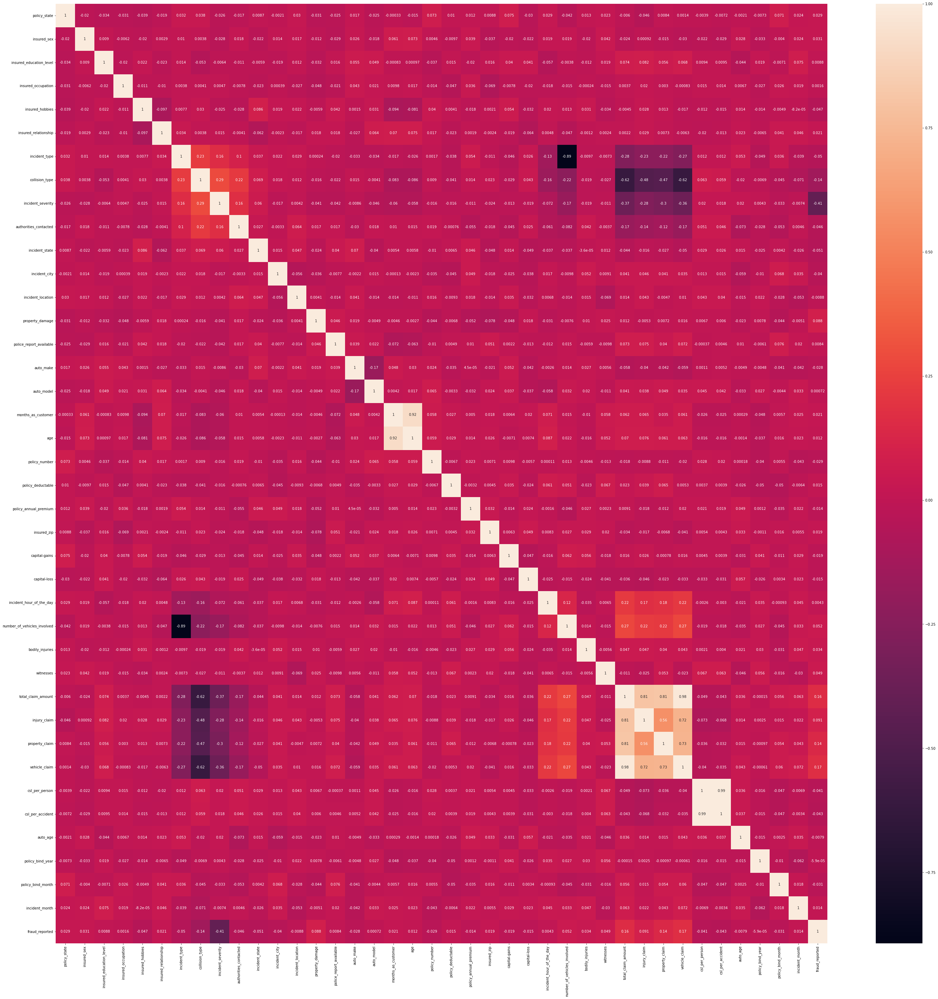

In [40]:
# plotting heat map to check correlation only for the continuous data
data_p=data_2.drop(["incident_year"],axis=1)
plt.figure(figsize=(50,50))                      
plot=sns.heatmap(data_p.corr(method = "pearson"), annot = True)
fig=plot.get_figure()
fig.savefig("heat.png")

In [42]:
# Pair Plot
sns.pairplot(data_2)

<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 0, 'Feature')

Text(0, 0.5, 'column with target names')

Text(0.5, 1.0, 'correlation')

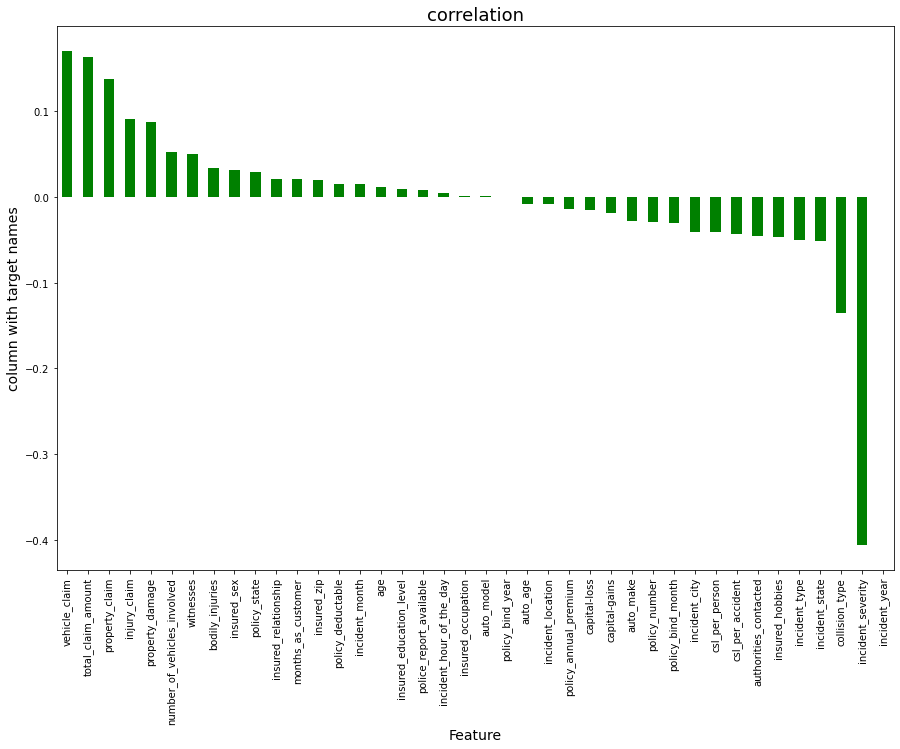

In [43]:
plt.figure(figsize=(15,10))
data_2.corr()['fraud_reported'].sort_values(ascending=False).drop(['fraud_reported']).plot(kind='bar',color='g')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

In [44]:
def outlier(mydata):                        # Outlier Plotting
    for i in mydata.columns:
        fig = px.box(mydata, y= i, width=600, height=400, title=i, template="plotly_dark")
        fig.show()

In [45]:
outlier(mydata=data_2.drop(["fraud_reported"],axis=1))

In [46]:
## Histogram for all the variables using plotly_express

for i in data_2.columns:
    fig = px.histogram(data_2, x= i, histfunc = "count", 
                       width=750, height=600, title = "Histogram for " + i, 
                       template="plotly_dark", cumulative=True)

    fig.show() 

Title: A Scatter Plot for incident_location and fraud_reported - 



<AxesSubplot:xlabel='incident_location', ylabel='fraud_reported'>

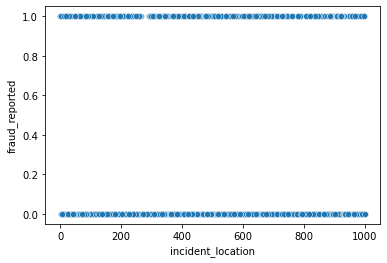

In [59]:
# Plotting Scatter plots for incident_location and fraud_reported
print("Title: A Scatter Plot for incident_location and fraud_reported -","\n")
sns.scatterplot(x="incident_location",y="fraud_reported",data=data_2)

Title: A Scatter Plot for months_as_customermonths_as_customer and fraud_reported - 



<AxesSubplot:xlabel='months_as_customer', ylabel='fraud_reported'>

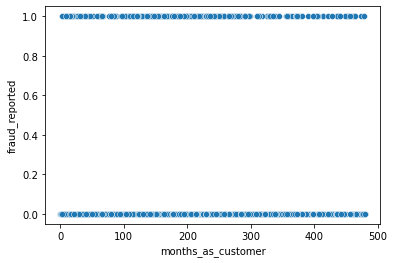

In [64]:
# Plotting Scatter plots for months_as_customer and fraud_reported
print("Title: A Scatter Plot for months_as_customermonths_as_customer and fraud_reported -","\n")
sns.scatterplot(x="months_as_customer",y="fraud_reported",data=data_2)

Title: A Scatter Plot for age and fraud_reported - 



<AxesSubplot:xlabel='age', ylabel='fraud_reported'>

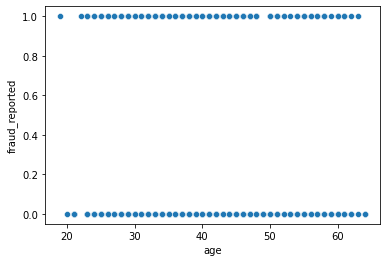

In [65]:
# Plotting Scatter plots for age and fraud_reported
print("Title: A Scatter Plot for age and fraud_reported -","\n")
sns.scatterplot(x="age",y="fraud_reported",data=data_2)

Title: A Scatter Plot for policy_number and fraud_reported - 



<AxesSubplot:xlabel='policy_number', ylabel='fraud_reported'>

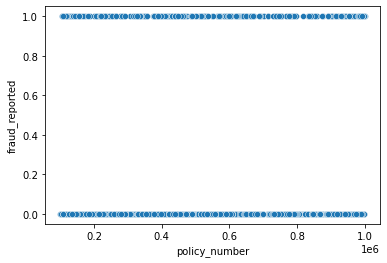

In [66]:
# Plotting Scatter plots for policy_number and fraud_reported
print("Title: A Scatter Plot for policy_number and fraud_reported -","\n")
sns.scatterplot(x="policy_number",y="fraud_reported",data=data_2)

Title: A Scatter Plot for policy_annual_premium and fraud_reported - 



<AxesSubplot:xlabel='policy_annual_premium', ylabel='fraud_reported'>

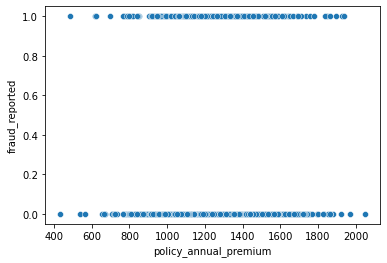

In [68]:
# Plotting Scatter plots for policy_annual_premium and fraud_reported
print("Title: A Scatter Plot for policy_annual_premium and fraud_reported -","\n")
sns.scatterplot(x="policy_annual_premium",y="fraud_reported",data=data_2)

Title: A Scatter Plot for capital-gainscapital-gains and fraud_reported - 



<AxesSubplot:xlabel='capital-gains', ylabel='fraud_reported'>

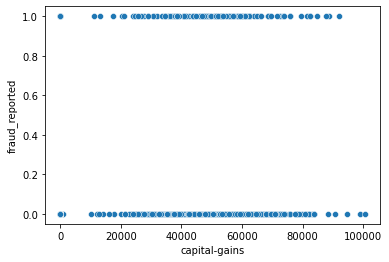

In [70]:
# Plotting Scatter plots for capital-gains and fraud_reported
print("Title: A Scatter Plot for capital-gainscapital-gains and fraud_reported -","\n")
sns.scatterplot(x="capital-gains",y="fraud_reported",data=data_2)

Title: A Scatter Plot for capital-loss and fraud_reported - 



<AxesSubplot:xlabel='capital-loss', ylabel='fraud_reported'>

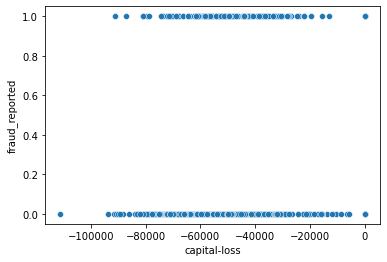

In [71]:
# Plotting Scatter plots for capital-loss and fraud_reported
print("Title: A Scatter Plot for capital-loss and fraud_reported -","\n")
sns.scatterplot(x="capital-loss",y="fraud_reported",data=data_2)

Title: A Scatter Plot for total_claim_amount and fraud_reported - 



<AxesSubplot:xlabel='total_claim_amount', ylabel='fraud_reported'>

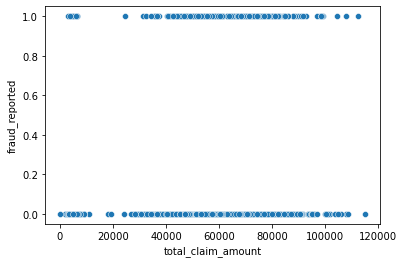

In [76]:
# Plotting Scatter plots for total_claim_amount and fraud_reported
print("Title: A Scatter Plot for total_claim_amount and fraud_reported -","\n")
sns.scatterplot(x="total_claim_amount",y="fraud_reported",data=data_2)

Title: A Scatter Plot for injury_claim and fraud_reported - 



<AxesSubplot:xlabel='injury_claim', ylabel='fraud_reported'>

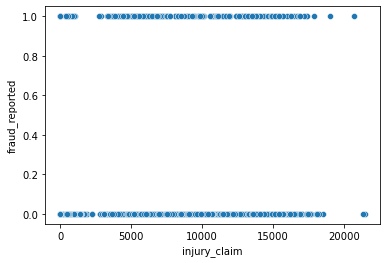

In [77]:
# Plotting Scatter plots for injury_claim and fraud_reported
print("Title: A Scatter Plot for injury_claim and fraud_reported -","\n")
sns.scatterplot(x="injury_claim",y="fraud_reported",data=data_2)

Title: A Scatter Plot for property_claim and fraud_reported - 



<AxesSubplot:xlabel='property_claim', ylabel='fraud_reported'>

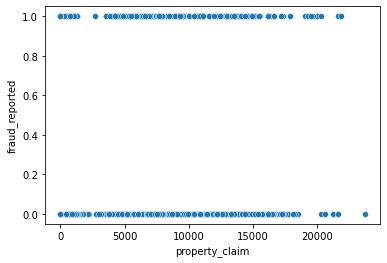

In [78]:
# Plotting Scatter plots for property_claim and fraud_reported
print("Title: A Scatter Plot for property_claim and fraud_reported -","\n")
sns.scatterplot(x="property_claim",y="fraud_reported",data=data_2)

Title: A Scatter Plot for vehicle_claim and fraud_reported - 



<AxesSubplot:xlabel='vehicle_claim', ylabel='fraud_reported'>

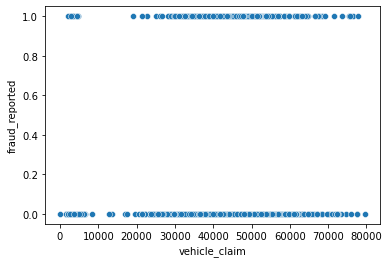

In [79]:
# Plotting Scatter plots for vehicle_claim and fraud_reported
print("Title: A Scatter Plot for vehicle_claim and fraud_reported -","\n")
sns.scatterplot(x="vehicle_claim",y="fraud_reported",data=data_2)

In [87]:
data_cat2 = pd.DataFrame()
data_num2 = pd.DataFrame()
for i in data_2.columns:
    if data_2[i].dtype == "O":
        data_cat2[i] = data_2[i]
    else:
        data_num2[i] = data_2[i]
        


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [88]:
for i in data_cat2:
    crosstab= pd.crosstab(data_cat2[i], data_cat2["fraud_reported"])
    
    print (" h0: Average ", i, " of an user does not affect fraud_reported")
    print (" ha: Average ",i," of an user does affect fraud_reported")
    
# defining the table
    stat, p, dof, expected = chi2_contingency(crosstab)
    
# interpret p-value
    alpha = 0.05
    print("The result for chi-square test between" ,i, "& ","fraud reported")
    print("p value is " , str(p))
    if p <= alpha:
        print('Dependent (reject H0)')
    else:
        print('Independent (H0 holds true)')

insured_sex   policy_state  insured_education_level  insured_occupation  insured_relationship  incident_date  incident_city  incident_location  police_report_available  auto_make auto_model months_as_customer   age policy_number policy_deductable  policy_annual_premium insured_zip  capital-gains  capital-loss  incident_hour_of_the_day number_of_vehicles_involved bodily_injuries witnesses total_claim_amount injury_claim property_claim vehicle_claim incident_year are not significant.

total_claim_amount, injury_claim, property_claim, vehicle_claim and csl_per_person are very much corelated to the model

In [91]:
data_2=data_2.drop(["insured_sex",   "policy_state",  "insured_education_level", "insured_occupation", "insured_relationship",
                    "incident_city", "incident_location", "police_report_available", "auto_make", "auto_model",
                    "months_as_customer",  "age", "policy_number", "policy_deductable", "policy_annual_premium", "insured_zip",  
                    "capital-gains", "capital-loss", "incident_hour_of_the_day", "number_of_vehicles_involved", "bodily_injuries",
                    "witnesses", "total_claim_amount", "injury_claim","property_claim", "vehicle_claim", "incident_year", "csl_per_person"],axis=1)

In [92]:
for i in data_2.drop(['fraud_reported'],axis=1).columns:
    data_2[i] = np.where(data_2[i] > (data_2[i].quantile(0.75) + (data_2[i].quantile(0.75) - data_2[i].quantile(0.25))*1.5),
                           (data_2[i].quantile(0.75) + (data_2[i].quantile(0.75) - data_2[i].quantile(0.25))*1.5),
                          np.where(data_2[i] < (data_2[i].quantile(0.25) - (data_2[i].quantile(0.75) - data_2[i].quantile(0.25))*1.5),
                           (data_2[i].quantile(0.25) - (data_2[i].quantile(0.75) - data_2[i].quantile(0.25))*1.5),data_2[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [93]:
outlier(mydata= data_2.drop(["fraud_reported"],axis=1))

In [94]:
data_features1= pd.DataFrame(data_2.drop(["fraud_reported"], axis=1))
data_label=pd.DataFrame(data_2["fraud_reported"])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [95]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
data_noskew= pt.fit_transform(data_features1.values)
data_noskewtab= pd.DataFrame(data_noskew)
data_noskewtab.columns = data_features1.columns

print(data_noskewtab)

<IPython.core.display.Javascript object>

     insured_hobbies  incident_type  collision_type  incident_severity  \
0           1.227979       0.825777        0.647700          -1.370664   
1           0.920483       1.440091        1.427092          -0.067519   
2          -1.402398      -1.124824       -0.259155          -0.067519   
3          -1.402398       0.825777       -1.405962          -1.370664   
4          -1.402398       1.440091        1.427092          -0.067519   
..               ...            ...             ...                ...   
995         0.604550       0.825777       -1.405962          -0.067519   
996         1.227979       0.825777       -0.259155          -1.370664   
997        -1.185954      -1.124824        0.647700          -0.067519   
998        -1.896338       0.825777       -0.259155          -1.370664   
999         0.278681       0.037434        1.427092          -0.067519   

     authorities_contacted  incident_state  property_damage  csl_per_accident  \
0                 1.156753    

In [96]:
data_final=pd.DataFrame()
data_final=pd.concat([data_noskewtab,data_label], axis=1)
print(data_final)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

     insured_hobbies  incident_type  collision_type  incident_severity  \
0           1.227979       0.825777        0.647700          -1.370664   
1           0.920483       1.440091        1.427092          -0.067519   
2          -1.402398      -1.124824       -0.259155          -0.067519   
3          -1.402398       0.825777       -1.405962          -1.370664   
4          -1.402398       1.440091        1.427092          -0.067519   
..               ...            ...             ...                ...   
995         0.604550       0.825777       -1.405962          -0.067519   
996         1.227979       0.825777       -0.259155          -1.370664   
997        -1.185954      -1.124824        0.647700          -0.067519   
998        -1.896338       0.825777       -0.259155          -1.370664   
999         0.278681       0.037434        1.427092          -0.067519   

     authorities_contacted  incident_state  property_damage  csl_per_accident  \
0                 1.156753    

<AxesSubplot:ylabel='Density'>

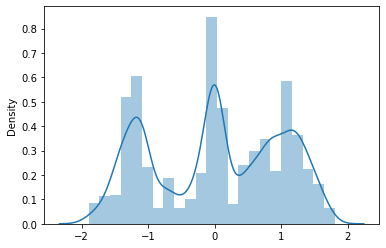

In [97]:
# Dist Plot
sns.distplot(data_final,kde=True, hist=True)

In [98]:
def split (data,target):
    data_reset_index = data.reset_index(drop=True)
# Data split
    global x
    global y
    global x_train
    global y_train
    global x_test
    global y_test
# Segregate Feature & Target Variables
    x = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]
    x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3, random_state=3)
    
    print(x_train.info())
    ("\n")
    print(x_test.info())
    ("\n")
    print(y_train.shape)
    ("\n")
    print(y_test.shape)
    ("\n")

In [99]:
split(data=data_final,
      target="fraud_reported")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 700 entries, 926 to 874
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   insured_hobbies        700 non-null    float64
 1   incident_type          700 non-null    float64
 2   collision_type         700 non-null    float64
 3   incident_severity      700 non-null    float64
 4   authorities_contacted  700 non-null    float64
 5   incident_state         700 non-null    float64
 6   property_damage        700 non-null    float64
 7   csl_per_accident       700 non-null    float64
 8   auto_age               700 non-null    float64
 9   policy_bind_year       700 non-null    float64
 10  policy_bind_month      700 non-null    float64
 11  incident_month         700 non-null    float64
dtypes: float64(12)
memory usage: 71.1 KB
None
<class 'pandas.core.frame.DataFrame'>
Int64Index: 300 entries, 642 to 186
Data columns (total 12 columns):
 #   Column

In [100]:
# Smote
sm = SMOTE(random_state = 5)

columns = x_train.columns

train_data = pd.concat([x_train,y_train], axis = 1)

train_data.head()

# Fitting the model
x_os_train, y_os_train  = sm.fit_resample(train_data.drop('fraud_reported', axis = 1), train_data['fraud_reported'])

y_os_train.value_counts()

<IPython.core.display.Javascript object>

,insured_hobbies,incident_type,collision_type,incident_severity,authorities_contacted,incident_state,property_damage,csl_per_accident,auto_age,policy_bind_year,policy_bind_month,incident_month,fraud_reported
926,1.378927,0.825777,-1.405962,0.894562,-0.711042,-1.019245,1.133447,0.048402,0.086910,-0.621517,-0.407354,-1.101186,1
411,1.378927,0.037434,1.427092,1.685863,1.156753,0.402170,0.058874,0.048402,0.086910,0.197135,0.735067,1.610754,0
224,0.278681,-1.124824,0.647700,-1.370664,-0.711042,0.822029,1.133447,-1.176316,-0.415925,-1.589334,-0.407354,-1.101186,0
14,-1.402398,0.825777,-0.259155,0.894562,1.156753,0.402170,-1.259826,0.048402,0.403858,-0.484258,1.525091,-1.101186,1
170,0.111405,-1.124824,-0.259155,-0.067519,1.156753,-1.019245,0.058874,0.048402,-0.076686,-0.347349,-0.407354,-1.101186,0


1    530
0    530
Name: fraud_reported, dtype: int64

In [101]:
## Number of records in Oversampled Train dataset

print('the number of records in x_os_train :', len(x_os_train))
print('the number of records in y_os_train :', len(y_os_train))
print('the number of records in x_test :', len(x_test))
print('the number of records in y_test :', len(y_test))

# Target Class Distribution for Train and test Dataset

print('the ratio of 0 and 1 in y_os_train:')

print(y_os_train.value_counts(normalize = True)*100)

print('the ratio of 0 and 1 in y_test:')

print(y_test.value_counts(normalize = True)*100)

print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

print("After UpSampling, counts of label '1': {}".format(sum(y_os_train==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_os_train==0)))

the number of records in x_os_train : 1060
the number of records in y_os_train : 1060
the number of records in x_test : 300
the number of records in y_test : 300
the ratio of 0 and 1 in y_os_train:
1    50.0
0    50.0
Name: fraud_reported, dtype: float64
the ratio of 0 and 1 in y_test:
0    74.333333
1    25.666667
Name: fraud_reported, dtype: float64
Before UpSampling, counts of label '1': 170
Before UpSampling, counts of label '0': 530 

After UpSampling, counts of label '1': 530
After UpSampling, counts of label '0': 530 



### Scaling the data

In [109]:
scalar= MinMaxScaler()
scalar.fit(x_train)
x_trainsc =  scalar.transform(x_os_train)
x_testsc  =  scalar.transform(x_test)

MinMaxScaler()

### Principal Component Analysis (PCA)

In [110]:
pca = PCA(n_components = 0.5)
pca.fit(x_trainsc)
x_train_model = pca.transform(x_trainsc)
x_test_model = pca.transform(x_testsc)
ex_variance=np.var(x_train_model,axis=0)
ex_variance_ratio = ex_variance/np.sum(ex_variance)

print("shape of x_train_pca", x_train_model.shape)
print('')    
print("Explained Variance Ratio for Training Dataset: \n", ex_variance_ratio)

print(" ")

ex_variance_1 = np.var(x_test_model , axis=0)
ex_variance_ratio_1 = ex_variance_1 / np.sum(ex_variance_1)
    
print("Explained Variance Ratio for Test Dataset: \n", ex_variance_ratio_1) 
print(" ")

PCA(n_components=0.5)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

shape of x_train_pca (1060, 5)

Explained Variance Ratio for Training Dataset: 
 [0.24913649 0.22139843 0.19632063 0.17751647 0.15562799]
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Explained Variance Ratio for Test Dataset: 
 [0.26151241 0.19572884 0.20104261 0.15201204 0.1897041 ]
 


## Model Building

### Naive Baye's Model

In [111]:
nb_model          =      GaussianNB()

## Model.fit

nb_model.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)

GaussianNB()

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.7666666666666667


The roc_auc score for NB Classifier Model:   0.7537708927843457


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

           0       0.89      0.78      0.83       223
           1       0.53      0.73      0.62        77

    accuracy                           0.77       300
   macro avg       0.71      0.75      0.72       300
weighted avg       0.80      0.77      0.78       300



In [112]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(nb_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_pred_nb_0)

print("The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: \n", accuracy)# Best Hyperparameter tuning
cv_method = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=100)
params_NB = {'var_smoothing': np.logspace(100,-100, num=1000)}

gs_NB = GridSearchCV(estimator=nb_model, 
                     param_grid=params_NB, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_NB.fit(Data_transformed, y_test)

# Best Parameters
print(" The Best Hyperparameter is : ",gs_NB.best_params_)

# Best Score
print(" The Best score is : ",gs_NB.best_score_)

The Cross Validation Score For Baseline Naive Baye's Model Classifier Model After Fold Cross Validation Is :  
 [0.73 0.82 0.77 0.8  0.79 0.77 0.81 0.83 0.87 0.81]
 
The Accuracy Score For Baseline Naive Baye's Model Classifier Model After Cross Validation Is: 
 0.7666666666666667


<IPython.core.display.Javascript object>

Fitting 15 folds for each of 1000 candidates, totalling 15000 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=GaussianNB(),
             param_grid={'var_smoothing': array([1.00000000e+100, 6.30666554e+099, 3.97740302e+099, 2.50841506e+099,
       1.58197348e+099, 9.97697764e+098, 6.29214611e+098, 3.96824610e+098,
       2.50264010e+098, 1.57833141e+098, 9.95400829e+097, 6.27766011e+097,
       3.95911027e+097, 2.4...
       6.36507908e-097, 4.01424249e-097, 2.53164848e-097, 1.59662602e-097,
       1.00693863e-097, 6.35042517e-098, 4.00500076e-098, 2.52582003e-098,
       1.59295021e-098, 1.00462042e-098, 6.33580499e-099, 3.99578030e-099,
       2.52000499e-099, 1.58928287e-099, 1.00230755e-099, 6.32121848e-100,
       3.98658107e-100, 2.51420335e-100, 1.58562396e-100, 1.00000000e-100])},
             scoring='accuracy', verbose=1)

 The Best Hyperparameter is :  {'var_smoothing': 0.0012505385872903735}
 The Best score is :  0.7911111111111111


In [113]:
nb_model2          =      GaussianNB(var_smoothing= 0.500840798984813)

## Model.fit

nb_model2.fit(x_trainsc, y_os_train)

## Model.predict


y_pred_nb_0 = nb_model2.predict(x_testsc)

### Naive Bayes

conf_matrix_nb = confusion_matrix(y_test, y_pred_nb_0, labels=[0, 1])

df_cmatrix_nb = pd.DataFrame(conf_matrix_nb, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_nb = px.imshow(df_cmatrix_nb , title = "Confusion Matrix for NB Classifier Model")

## Saving the Classification Reports : precision, recall, f1-score ##


pred_report_nb = classification_report(y_test, y_pred_nb_0 , digits=2)

### NB Classifier

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test,  y_pred_nb_0)
roc_nb = auc(false_positive_rate, true_positive_rate)


print("The Accuracy Score For The NB Classifier Model Is :  ", accuracy_score(y_test, y_pred_nb_0))
print("\n")
print("The roc_auc score for NB Classifier Model:  ", roc_nb)



##  Confusion Matrices 


fig_cmatrix_nb.show()

### Classification Reports 

print("Title : The Classification Report for NB Classifier Model: \n  ", pred_report_nb)


GaussianNB(var_smoothing=0.500840798984813)

<IPython.core.display.Javascript object>

The Accuracy Score For The NB Classifier Model Is :   0.69


The roc_auc score for NB Classifier Model:   0.7192068021664435


Title : The Classification Report for NB Classifier Model: 
                 precision    recall  f1-score   support

           0       0.90      0.66      0.76       223
           1       0.44      0.78      0.56        77

    accuracy                           0.69       300
   macro avg       0.67      0.72      0.66       300
weighted avg       0.78      0.69      0.71       300



### Linear Discriminant Analysis (LDA)

In [114]:
# Training the model
lda_model         =      LinearDiscriminantAnalysis()

## Model.fit

lda_model.fit(x_trainsc, y_os_train)

## Model.predict

y_lda_0 = lda_model.predict(x_testsc)

## Linear Discriminant Analysis Model


conf_matrix_lda =  confusion_matrix(y_test, y_lda_0 , labels=[0, 1])

df_cmatrix_lda   = pd.DataFrame(conf_matrix_lda , index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_lda = px.imshow(df_cmatrix_lda , title = "Confusion Matrix for Baseline Linear Discriminant Analysis Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_lda = classification_report(y_test, y_lda_0 , digits=2)

### Saving the ROC_AUC Scores for Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_lda_0)
roc_lda = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Linear Discriminant Analysis Model Is :  ",   
      accuracy_score(y_test, y_lda_0))

##  Confusion Matrices 

fig_cmatrix_lda.show()

### Classification Reports 

print("Title : The Classification Report for Linear Discriminant Model: \n  ", pred_report_lda)

###  roc_auc scores 

print("The roc_auc score for Linear Discriminat Analysis Model:  ", roc_lda)

LinearDiscriminantAnalysis()

<IPython.core.display.Javascript object>

The Accuracy Score For The Linear Discriminant Analysis Model Is :   0.77


Title : The Classification Report for Linear Discriminant Model: 
                 precision    recall  f1-score   support

           0       0.89      0.79      0.84       223
           1       0.54      0.71      0.61        77

    accuracy                           0.77       300
   macro avg       0.71      0.75      0.73       300
weighted avg       0.80      0.77      0.78       300

The roc_auc score for Linear Discriminat Analysis Model:   0.7517616912235747


In [115]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(lda_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_lda_0)

print("The Cross Validation Score For Baseline Linear Discriminant Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Linear Discriminant Model After Fold Cross Validation Is :  
 [0.74 0.79 0.78 0.79 0.78 0.78 0.79 0.8  0.86 0.79]
 
The Accuracy Score For Baseline Linear Discriminant Model After Cross Validation Is: 
 0.77


### K-Nearest Neighbor Model

In [122]:
# Training the model
knn_model          =       KNeighborsClassifier()

## Model.fit

knn_model.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)



KNeighborsClassifier()

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.6033333333333334
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.6141459437423562


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

           0       0.82      0.59      0.69       223
           1       0.35      0.64      0.45        77

    accuracy                           0.60       300
   macro avg       0.59      0.61      0.57       300
weighted avg       0.70      0.60      0.63       300



In [123]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(knn_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_knn_0)

print("The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline K- Nearest Neighbour Classifier Model After Fold Cross Validation Is :  
 [0.77 0.74 0.65 0.72 0.78 0.78 0.73 0.76 0.77 0.78]
 
The Accuracy Score For Baseline K- Nearest Neighbour Classifier Model After Cross Validation Is: 
 0.6033333333333334


In [124]:
# Best Hyperparameter tuning
algorithm= ['auto','ball_tree','kd_tree','brute']
metric= ['minkowski','manhattan','euclidean']
n_neighbors= [3,5,7,9,11,13,15]
weights= ['uniform','distance']
p= [1,2]

param_grid = dict(algorithm=algorithm,metric= metric, n_neighbors=n_neighbors, weights=weights, p=p)

gs_knn = GridSearchCV(estimator=knn_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                     verbose=1, 
                     scoring='accuracy')

Data_transformed = PowerTransformer().fit_transform(x_testsc)

gs_knn.fit(Data_transformed, y_test)

print("The Best Parameters are: ","\n",gs_knn.best_params_)
print("The Best score is: ","\n",gs_knn.best_score_)

Fitting 15 folds for each of 336 candidates, totalling 5040 fits


GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'metric': ['minkowski', 'manhattan', 'euclidean'],
                         'n_neighbors': [3, 5, 7, 9, 11, 13, 15], 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 9, 'p': 1, 'weights': 'distance'}
The Best score is:  
 0.7866666666666667


In [125]:
# Training the model
knn_model2         =      KNeighborsClassifier(algorithm='auto', metric='minkowski', n_neighbors=11, p=1, weights='uniform')

## Model.fit

knn_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_knn_0 = knn_model2.predict(x_testsc)

## K- Nearest Neighbor Model

conf_matrix_knn = confusion_matrix(y_test, y_knn_0 , labels=[0, 1])

df_cmatrix_knn = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_knn = px.imshow(df_cmatrix_knn , title = "Confusion Matrix for K-Nearest Neighbor Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_knn = classification_report(y_test, y_knn_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_knn_0)
roc_knn = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :  ",   
      accuracy_score(y_test, y_knn_0))

###  roc_auc scores 

print("The roc_auc score for K-Nearest Neighbor Analysis Model:  ", roc_knn)

##  Confusion Matrices 

fig_cmatrix_knn.show()

### Classification Reports 

print("Title : The Classification Report for K-Nearest Neighbor Model: \n ", pred_report_knn)



KNeighborsClassifier(n_neighbors=11, p=1)

<IPython.core.display.Javascript object>

The Accuracy Score For The K-Nearest Neighbor Analysis Model Is :   0.7133333333333334
The roc_auc score for K-Nearest Neighbor Analysis Model:   0.6923883291596297


Title : The Classification Report for K-Nearest Neighbor Model: 
                precision    recall  f1-score   support

           0       0.86      0.74      0.79       223
           1       0.46      0.65      0.54        77

    accuracy                           0.71       300
   macro avg       0.66      0.69      0.66       300
weighted avg       0.76      0.71      0.73       300



### Support Vector Classification Model

In [126]:
# Training the model
svm_model =  svm.SVC()

## Model.fit

svm_model.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)


<IPython.core.display.Javascript object>

SVC()

<IPython.core.display.Javascript object>

The Accuracy Score For The Support Vector Analysis Model Is :   0.7833333333333333
The roc_auc score for Support Vector Analysis Model:   0.7394735309533516


Title : The Classification Report for Support Vector Model: 
                precision    recall  f1-score   support

           0       0.87      0.83      0.85       223
           1       0.57      0.65      0.61        77

    accuracy                           0.78       300
   macro avg       0.72      0.74      0.73       300
weighted avg       0.79      0.78      0.79       300



In [127]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(svm_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_svc_0)

print("The Cross Validation Score For Baseline Support Vector Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Support Vector Classifier Model After Fold Cross Validation Is :  
 [0.75 0.79 0.78 0.77 0.81 0.75 0.76 0.84 0.82 0.84]
 
The Accuracy Score For Baseline Support Vector Classifier Model After Cross Validation Is: 
 0.7833333333333333


In [128]:
# Best Hyperparameter Tuning

c= [0.1,1,10,100]
break_ties= [True,False]
verbose= [True,False]
class_weights= ['None','balanced']
shrinking= [True,False]
gamma= ['scale','auto']
kernel=['linear','poly','rbf','sigmoid']
degree=[1,3,5,7,9]

param_grid = dict(C=c,
                  break_ties= break_ties, 
                  verbose=verbose, 
                  class_weight=class_weights, 
                  shrinking=shrinking,
                  gamma=gamma, 
                  kernel=kernel, 
                  degree=degree)

gs_svm = GridSearchCV(estimator=svm_model, 
                     param_grid=param_grid, 
                     cv=cv_method,
                      refit= True,
                     verbose=1, 
                     scoring='accuracy')

gs_svm.fit(x_testsc, y_test)

print("The Best Parameters are: ","\n",gs_svm.best_params_)
print("The Best score is: ","\n",gs_svm.best_score_)

Fitting 15 folds for each of 2560 candidates, totalling 38400 fits
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibS

GridSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=100),
             estimator=SVC(),
             param_grid={'C': [0.1, 1, 10, 100], 'break_ties': [True, False],
                         'class_weight': ['None', 'balanced'],
                         'degree': [1, 3, 5, 7, 9], 'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
                         'shrinking': [True, False], 'verbose': [True, False]},
             scoring='accuracy', verbose=1)

The Best Parameters are:  
 {'C': 1, 'break_ties': True, 'class_weight': 'balanced', 'degree': 1, 'gamma': 'scale', 'kernel': 'poly', 'shrinking': True, 'verbose': True}
The Best score is:  
 0.7855555555555555


In [129]:
# Training the model
svm_model2 =  svm.SVC(C=10, break_ties=True, class_weight='balanced', degree=1, gamma='scale', kernel= 'rbf', shrinking=True, verbose=True)

## Model.fit

svm_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_svc_0 = svm_model2.predict(x_testsc)

## Support Vector Model

conf_matrix_svc = confusion_matrix(y_test, y_svc_0 , labels=[0, 1])

df_cmatrix_svc = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_svc = px.imshow(df_cmatrix_svc , title = "Confusion Matrix for Support Vector Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_svc = classification_report(y_test, y_svc_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_svc_0)
roc_svc = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Support Vector Analysis Model Is :  ",   
      accuracy_score(y_test, y_svc_0))

###  roc_auc scores 

print("The roc_auc score for Support Vector Analysis Model:  ", roc_svc)
##  Confusion Matrices 

fig_cmatrix_svc.show()

### Classification Reports 

print("Title : The Classification Report for Support Vector Model: \n ", pred_report_svc)


<IPython.core.display.Javascript object>

[LibSVM]

SVC(C=10, break_ties=True, class_weight='balanced', degree=1, verbose=True)

<IPython.core.display.Javascript object>

The Accuracy Score For The Support Vector Analysis Model Is :   0.73
The roc_auc score for Support Vector Analysis Model:   0.6270747190029702


Title : The Classification Report for Support Vector Model: 
                precision    recall  f1-score   support

           0       0.81      0.84      0.82       223
           1       0.47      0.42      0.44        77

    accuracy                           0.73       300
   macro avg       0.64      0.63      0.63       300
weighted avg       0.72      0.73      0.72       300



### Logistic Regression

In [130]:
# Training the model
logit_model = LogisticRegression()

## Model.fit

logit_model.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

LogisticRegression()

<IPython.core.display.Javascript object>

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.78


Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

           0       0.89      0.80      0.84       223
           1       0.56      0.71      0.63        77

    accuracy                           0.78       300
   macro avg       0.72      0.76      0.73       300
weighted avg       0.80      0.78      0.79       300

The roc_auc score for Logistic Regression Analysis Model:   0.7584881486226779


In [131]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(logit_model , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_logr_0)

print("The Cross Validation Score For Baseline Logistic Regression Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Logistic Regression Classifier Model After Fold Cross Validation Is :  
 [0.7  0.78 0.75 0.76 0.79 0.77 0.8  0.8  0.84 0.8 ]
 
The Accuracy Score For Baseline Logistic Regression Classifier Model After Cross Validation Is: 
 0.78


In [132]:
### Hyper-parameter Tuning of Logistic Regression

penalty = ['l1', 'l2'] 
C = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]
class_weight = ['balanced', None]
solver = ['newton-cg','lbfgs','liblinear','sag','saga']

param_grid = dict(penalty=penalty,
                  C=C,
                  class_weight=class_weight,
                  solver=solver)

grid = GridSearchCV(estimator = logit_model,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, cv = 10)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 10 folds for each of 160 candidates, totalling 1600 fits
Best Score:  0.7912424350302599
Best Params:  {'C': 100, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'saga'}


In [133]:
# Training the model
logit_model2 = LogisticRegression(C=10, class_weight='balanced', penalty= 'l1', solver='liblinear')

## Model.fit

logit_model2.fit(x_trainsc, y_os_train)

## Model.predict

y_logr_0 = logit_model2.predict(x_testsc)

## Logistic Regression Model

conf_matrix_logr = confusion_matrix(y_test, y_logr_0 , labels=[0, 1])

df_cmatrix_logr = pd.DataFrame(conf_matrix_knn, index = [i for i in [0, 1]],
                  columns = [i for i in ["Predict_Rejected","Predict_Accepted"]])


fig_cmatrix_logr = px.imshow(df_cmatrix_logr , title = "Confusion Matrix for Logistic Regression Model")

## Saving the Classification Reports : precision, recall, f1-score ##

pred_report_logr = classification_report(y_test, y_logr_0 , digits=2)

### Saving the ROC_AUC Scores for Baseline Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_logr_0)
roc_logr = auc(false_positive_rate, true_positive_rate)

#### Printing the Accuracy Scores 

print("The Accuracy Score For The Logistic Regression Analysis Model Is :  ",   
      accuracy_score(y_test, y_logr_0))

###  roc_auc scores 

print("The roc_auc score for Logistic Regression Analysis Model:  ", roc_logr)

##  Confusion Matrices 

fig_cmatrix_logr.show()

### Classification Reports 

print("Title : The Classification Report for Logistic Regression Model: \n ", pred_report_logr)



LogisticRegression(C=10, class_weight='balanced', penalty='l1',
                   solver='liblinear')

<IPython.core.display.Javascript object>

The Accuracy Score For The Logistic Regression Analysis Model Is :   0.7766666666666666
The roc_auc score for Logistic Regression Analysis Model:   0.7519946421291712


Title : The Classification Report for Logistic Regression Model: 
                precision    recall  f1-score   support

           0       0.89      0.80      0.84       223
           1       0.55      0.70      0.62        77

    accuracy                           0.78       300
   macro avg       0.72      0.75      0.73       300
weighted avg       0.80      0.78      0.78       300



### Decision Tree Classification Model

DecisionTreeClassifier(random_state=1)

1.0
0.7666666666666667


<Figure size 1080x720 with 0 Axes>

[Text(0.5758500957854407, 0.9705882352941176, 'X[3] <= 0.426\ngini = 0.5\nsamples = 1060\nvalue = [530, 530]'),
 Text(0.4003831417624521, 0.9117647058823529, 'X[10] <= 1.0\ngini = 0.276\nsamples = 465\nvalue = [77, 388]'),
 Text(0.30268199233716475, 0.8529411764705882, 'X[5] <= 0.998\ngini = 0.261\nsamples = 453\nvalue = [70, 383]'),
 Text(0.18007662835249041, 0.7941176470588235, 'X[7] <= 0.003\ngini = 0.231\nsamples = 406\nvalue = [54, 352]'),
 Text(0.10153256704980843, 0.7352941176470589, 'X[4] <= 0.293\ngini = 0.357\nsamples = 116\nvalue = [27, 89]'),
 Text(0.06130268199233716, 0.6764705882352942, 'X[4] <= 0.281\ngini = 0.488\nsamples = 45\nvalue = [19, 26]'),
 Text(0.04597701149425287, 0.6176470588235294, 'X[9] <= 0.786\ngini = 0.389\nsamples = 34\nvalue = [9, 25]'),
 Text(0.038314176245210725, 0.5588235294117647, 'X[0] <= 0.909\ngini = 0.312\nsamples = 31\nvalue = [6, 25]'),
 Text(0.03065134099616858, 0.5, 'X[5] <= 0.783\ngini = 0.191\nsamples = 28\nvalue = [3, 25]'),
 Text(0.0153

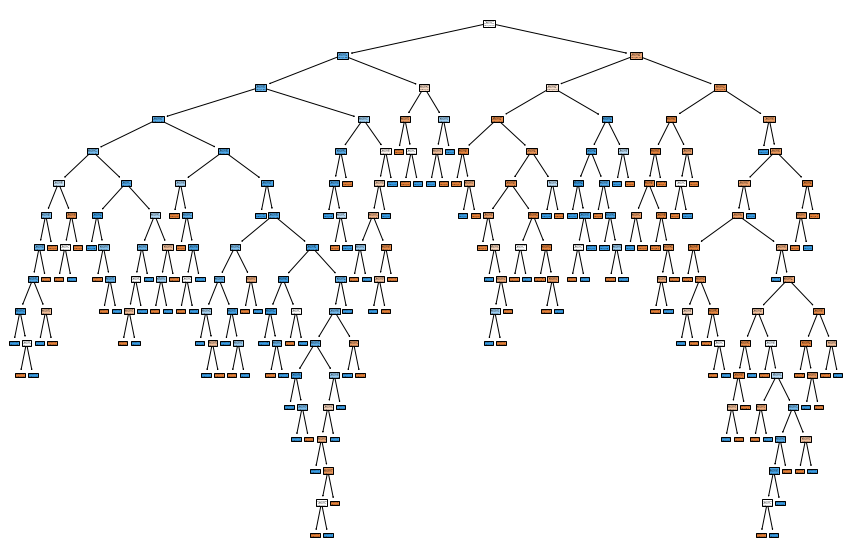

In [134]:
# Building Decision Tree Model
dTree = DecisionTreeClassifier(criterion = 'gini', random_state=1)
dTree.fit(x_trainsc, y_os_train)

# Scoring our Decision Tree
print(dTree.score(x_trainsc, y_os_train))
print(dTree.score(x_testsc, y_test))

# Visualizing the Decision Tree
plt.figure(figsize=(15,10))
tree.plot_tree(dTree,filled=True)

In [135]:
# Reducing Overfitting
dTreeR = DecisionTreeClassifier(criterion = 'gini', max_depth = 4, random_state=1)
dTreeR.fit(x_trainsc, y_os_train)
print(dTreeR.score(x_trainsc, y_os_train))
print(dTreeR.score(x_testsc, y_test))

DecisionTreeClassifier(max_depth=4, random_state=1)

0.879245283018868
0.8666666666666667


0.8666666666666667


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.8666666666666667


Decision Tree Classifier Report


              precision    recall  f1-score   support

           0       0.95      0.87      0.91       223
           1       0.69      0.86      0.77        77

    accuracy                           0.87       300
   macro avg       0.82      0.86      0.84       300
weighted avg       0.88      0.87      0.87       300



ROC score:  0.8635490070467651


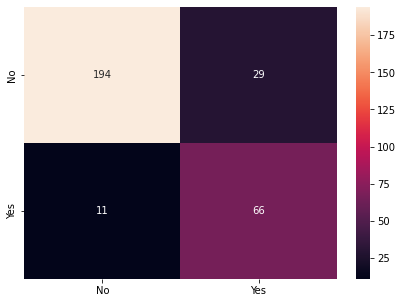

In [136]:
# Decision Tree Analysis Model
print(dTreeR.score(x_testsc , y_test))
y_predict = dTreeR.predict(x_testsc)

cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)
print("\n")
print("ROC score: ",roc_tree)

In [137]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(dTree , x , y, scoring = 'accuracy', 
                                          cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Decision Tree Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Decision Tree Classifier Model After Fold Cross Validation Is :  
 [0.74 0.78 0.8  0.76 0.72 0.75 0.73 0.8  0.8  0.77]
 
The Accuracy Score For Baseline Decision Tree Classifier Model After Cross Validation Is: 
 0.8666666666666667


In [138]:
### Hyper-parameter Tuning of Decision Tree by Grid Search CV 
criterion = ['gini','entropy','log_class']
max_depth = [1,3,5,7]
max_features = ['sqrt','log2',None]
random_state=[1,5,7,10]

param_grid = dict(criterion=criterion,
                  max_depth=max_depth,
                  max_features=max_features,
                  random_state=random_state)

grid = GridSearchCV(estimator = dTree,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 10)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 10 folds for each of 144 candidates, totalling 1440 fits
Best Score:  0.8622641509433964
Best Params:  {'criterion': 'gini', 'max_depth': 3, 'max_features': None, 'random_state': 1}


DecisionTreeClassifier(max_depth=7, random_state=1)

0.9245283018867925
0.81
0.81


<IPython.core.display.Javascript object>

<Figure size 504x360 with 0 Axes>

<AxesSubplot:>

Accuracy Score for Decision Tree:  0.81


Decision Tree Classifier Report


              precision    recall  f1-score   support

           0       0.88      0.87      0.87       223
           1       0.62      0.65      0.64        77

    accuracy                           0.81       300
   macro avg       0.75      0.76      0.75       300
weighted avg       0.81      0.81      0.81       300



ROC score:  0.7574107506842933


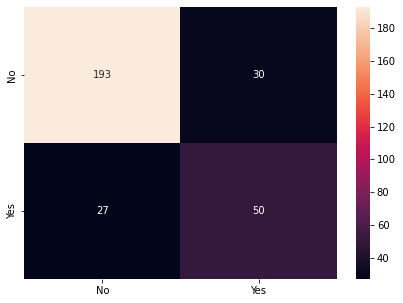

In [139]:
dTreeR2 = DecisionTreeClassifier(criterion = 'gini', max_depth = 7, max_features=None, random_state=1)
dTreeR2.fit(x_trainsc, y_os_train)
print(dTreeR2.score(x_trainsc, y_os_train))
print(dTreeR2.score(x_testsc, y_test))

# Decision Tree Analysis Model
print(dTreeR2.score(x_testsc , y_test))
y_predict = dTreeR2.predict(x_testsc)
cm = confusion_matrix(y_test, y_predict, labels=[0, 1])

df_cm = pd.DataFrame(cm, index = [i for i in ["No","Yes"]],
                  columns = [i for i in ["No","Yes"]])
plt.figure(figsize = (7,5))
sns.heatmap(df_cm, annot=True ,fmt='g')

## Saving the Classification Reports for Meta Learning Models:

pred_report_tree = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_tree = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Decision Tree: ",accuracy)
print("\n")
print("Decision Tree Classifier Report")
print("\n")
print(pred_report_tree)
print("\n")
print("ROC score: ",roc_tree)

### Random Forest Classification Model

In [140]:
rf_model = RandomForestClassifier()
rf_model.fit(x_trainsc, y_os_train)
y_predict= rf_model.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier()

Accuracy Score for Random Forest:  0.8366666666666667


ROC score:  0.7838506784695126


Random Forest Classifier Report


              precision    recall  f1-score   support

           0       0.89      0.89      0.89       223
           1       0.68      0.68      0.68        77

    accuracy                           0.84       300
   macro avg       0.79      0.78      0.79       300
weighted avg       0.84      0.84      0.84       300



In [141]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(rf_model , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Random Forest Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Random Forest Classifier Model After Fold Cross Validation Is :  
 [0.76 0.82 0.78 0.8  0.84 0.8  0.81 0.85 0.83 0.83]
 
The Accuracy Score For Baseline Random Forest Model After Cross Validation Is: 
 0.8366666666666667


In [142]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
criterion = ['gini','entropy','log_class']
max_features = ['sqrt','log2',None]
bootstrap=[True,False]
random_state=[1,5,7,10]
class_weight=['balanced','balanced_subsample', None]

param_grid = dict(n_estimators=n_estimators,
                  criterion=criterion,
                  max_features=max_features,
                  bootstrap=bootstrap,
                  random_state=random_state,
                  class_weight=class_weight)

grid = GridSearchCV(estimator = rf_model,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 648 candidates, totalling 1944 fits
Best Score:  0.8858879766115567
Best Params:  {'bootstrap': True, 'class_weight': None, 'criterion': 'gini', 'max_features': None, 'n_estimators': 100, 'random_state': 1}


In [143]:
rf_model2 = RandomForestClassifier(bootstrap=False, class_weight=None,criterion='gini',max_features='log2', n_estimators=10, random_state=5)
rf_model2.fit(x_trainsc, y_os_train)
y_predict= rf_model2.predict(x_testsc)

## Saving the Classification Reports for Meta Learning Models:

pred_report_rf = classification_report(y_test, y_predict , digits=2)

### Saving the ROC_AUC Scores for Meta Learning Algorithms

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_predict)
roc_rf = auc(false_positive_rate, true_positive_rate)

## Saving the accuracy

accuracy = accuracy_score(y_test, y_predict)

print("Accuracy Score for Random Forest: ",accuracy)
print("\n")
print("ROC score: ",roc_rf)
print("\n")
print("Random Forest Classifier Report")
print("\n")
print(pred_report_rf)

RandomForestClassifier(bootstrap=False, max_features='log2', n_estimators=10,
                       random_state=5)

Accuracy Score for Random Forest:  0.78


ROC score:  0.6394502358627919


Random Forest Classifier Report


              precision    recall  f1-score   support

           0       0.81      0.93      0.86       223
           1       0.63      0.35      0.45        77

    accuracy                           0.78       300
   macro avg       0.72      0.64      0.66       300
weighted avg       0.76      0.78      0.76       300



### AdaBoosting Algorithm

In [144]:
clf = AdaBoostClassifier()
clf.fit(x_trainsc, y_os_train)
y_pred = clf.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))


AdaBoostClassifier()

Accuracy Score:  0.83


roc_auc_1 score:  0.7836177275639158
              precision    recall  f1-score   support

           0       0.89      0.88      0.88       223
           1       0.66      0.69      0.68        77

    accuracy                           0.83       300
   macro avg       0.78      0.78      0.78       300
weighted avg       0.83      0.83      0.83       300



In [145]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Ada Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Ada Boosting Classifier Model After Fold Cross Validation Is :  
 [0.75 0.83 0.79 0.8  0.83 0.78 0.83 0.82 0.86 0.87]
 
The Accuracy Score For Baseline Ada Boosting Classifier Model After Cross Validation Is: 
 0.78


In [146]:
### Hyper-parameter Tuning of Random Forest Classifier

n_estimators = [1,10,100] 
learning_rate= [1,5,7,10]
algorithm= ['SAMME', 'SAMME.R']
random_state=[1,3,5,7,10,11,15,20]

param_grid = dict(n_estimators=n_estimators,
                  learning_rate=learning_rate,
                  random_state=random_state,
                  algorithm=algorithm)

grid = GridSearchCV(estimator = clf,
                    param_grid = param_grid,
                    scoring ='accuracy',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 5)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 5 folds for each of 192 candidates, totalling 960 fits
Best Score:  0.8603773584905661
Best Params:  {'algorithm': 'SAMME.R', 'learning_rate': 1, 'n_estimators': 100, 'random_state': 1}


In [147]:
clf2 = AdaBoostClassifier(n_estimators =100 ,learning_rate= 1,algorithm='SAMME' , random_state= 1)
clf2.fit(x_trainsc, y_os_train)
y_pred = clf2.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_1 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
print("\n")
print("roc_auc_1 score: ", roc_auc_1)
########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




AdaBoostClassifier(algorithm='SAMME', learning_rate=1, n_estimators=100,
                   random_state=1)

Accuracy Score:  0.8433333333333334


roc_auc_1 score:  0.8180944615922197
              precision    recall  f1-score   support

           0       0.92      0.87      0.89       223
           1       0.67      0.77      0.72        77

    accuracy                           0.84       300
   macro avg       0.79      0.82      0.80       300
weighted avg       0.85      0.84      0.85       300



### Gradient Boosting Algorithm

In [148]:
clf3= GradientBoostingClassifier()
clf3.fit(x_trainsc, y_os_train)
y_pred = clf3.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))

########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




<IPython.core.display.Javascript object>

GradientBoostingClassifier()

Accuracy Score:  0.8633333333333333
roc_auc_2 score:  0.8528041465261196
              precision    recall  f1-score   support

           0       0.94      0.87      0.90       223
           1       0.70      0.83      0.76        77

    accuracy                           0.86       300
   macro avg       0.82      0.85      0.83       300
weighted avg       0.88      0.86      0.87       300



In [149]:
##### K Fold Cross Validation ####
    
cross_valid = True
cv_score = cross_val_score(clf3 , x , y, scoring = 'accuracy', cv = KFold(n_splits = 10))
accuracy = accuracy_score(y_test, y_predict)

print("The Cross Validation Score For Baseline Gradient Boosting Classifier Model After", "Fold Cross Validation Is :  \n", cv_score)
print(" ")
print("The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: \n", accuracy)

The Cross Validation Score For Baseline Gradient Boosting Classifier Model After Fold Cross Validation Is :  
 [0.8  0.84 0.81 0.81 0.88 0.79 0.89 0.88 0.88 0.83]
 
The Accuracy Score For Baseline Gradient Boosting Classifier Model After Cross Validation Is: 
 0.78


In [150]:
### Hyper-parameter Tuning of Gradient Boosting Classifier

loss = ['log_loss','deviance','exponential'] 
learning_rate= [1,5,7,10]
n_estimators=[1,10,50,100]
criterion= ['friedman_mse', 'squared_error','mse']
random_state=[1,3,5,7,10,11,15,20]
max_features=['auto','sqrt','log2']
ccp_alpha=[0.0,0.1,0.2,0.3,0.4,0.5]

param_grid = dict(loss=loss,
                  n_estimators=n_estimators,
                  learning_rate=learning_rate,
                  criterion=criterion,
                  max_features=max_features,
                  random_state=random_state,
                  ccp_alpha=ccp_alpha)

grid = GridSearchCV(estimator = clf3,
                    param_grid = param_grid,
                    scoring ='roc_auc',
                    verbose = 1,
                    n_jobs =-1, 
                    cv = 3)
grid_result = grid.fit(x_trainsc, y_os_train)

print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

Fitting 3 folds for each of 20736 candidates, totalling 62208 fits
Best Score:  0.9509262402827471
Best Params:  {'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'learning_rate': 1, 'loss': 'exponential', 'max_features': 'sqrt', 'n_estimators': 100, 'random_state': 20}


In [151]:
clf4 = GradientBoostingClassifier(ccp_alpha=0.0,loss ='exponential' ,learning_rate=1 ,n_estimators=100 ,criterion='squared_error' , random_state=100 )
clf4.fit(x_trainsc, y_os_train)
y_pred = clf4.predict(x_testsc)

### Saving the ROC_AUC Score

false_positive_rate, true_positive_rate, thresholds = roc_curve(y_test, y_pred)
roc_auc_2 = auc(false_positive_rate, true_positive_rate)

########## Printing the Accuracy Score

print("Accuracy Score: ",accuracy_score(y_test, y_pred))
########## Printing the ROC_AOC Score

print("roc_auc_2 score: ", roc_auc_2)

########## Printing the Classification Report

print(classification_report(y_test, y_pred, digits=2))




<IPython.core.display.Javascript object>

GradientBoostingClassifier(criterion='squared_error', learning_rate=1,
                           loss='exponential', random_state=100)

Accuracy Score:  0.8
roc_auc_2 score:  0.7294275231494962
              precision    recall  f1-score   support

           0       0.86      0.87      0.87       223
           1       0.62      0.58      0.60        77

    accuracy                           0.80       300
   macro avg       0.74      0.73      0.73       300
weighted avg       0.80      0.80      0.80       300



In [153]:
# Save the trained model as a pickle string.
saved_model = pickle.dumps(dTreeR)

## Conclusion:

Since recall is more important to our model than precision, I have selected the model having maximum recall with momst accuracy and area under the curve